# Whale Audio Exploration

The whale dataset spans across many areas of the world and through many hydrophone and system setups. To analyse the variability acoross the dataset and understand the underlying structure of the data. The first step is to undertake a series of preprocessing and exploratory analysis techniques. 



In [1]:
"""
Loaded in all notebooks to allow inline plotting, and library reloads.

"""
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
# Import all required libraries for preprocessing

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function


#System utilities
import os
import sys
import shutil
import glob
from glob import glob
import datetime
import re
import time
from itertools import islice
from pathlib import Path
from tqdm import tqdm

#FILE IMPORTERS
import csv

#AUDIO LIBRARIES

import librosa
import librosa.display as disp
#import soundfile as sf
from scipy.fftpack import fft
from scipy.signal import get_window
import scipy
from scipy.io import wavfile




# MACHINE LEARNING LIBRARIES"
import sklearn
from sklearn.model_selection import train_test_split

#from fastai import *

#torch functions for ease of use
#import torch
#import torch.utils.data
#from torch.utils.data import Dataset, TensorDataset, DataLoader #as DataLoaderBase
#from torch import nn, optim, sigmoid
#from torch.nn import functional as F
#from torchvision import datasets, transforms
#from torch.nn import modules
#from torch.autograd import Variable


#PLOTTING TOOLS AND OTHER USEFUL TIDBITS
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

import tkinter as tk
from tkinter import filedialog as filedialog
import fnmatch
from itertools import compress

from pathlib import Path, PurePosixPath

In [4]:
import pdb

Location for Audio analysis

In [5]:

def get_file_locations():
    """
    Catch all to allow for use on:

    Work Machine - 
    H:/Masters/
    Home Desktop - 
    E:\Masters
    Home Linux -

    Home Laptop -


    Work Linux -
    """
    #System Check

    if os.name == 'nt':
        if os.path.exists('E:/Masters'):
            ROOT = Path('E:/Masters')
        elif os.path.exists('H:/Masters'):
            ROOT = Path('H:/Masters')
        elif os.path.exists('D:/Masters'):
            ROOT = Path('D:\Masters')
        else:
            print('Folder not found')
    else:
        if os.path.exists('/media/tim/'):
            ROOT = '/media/tim/Masters/'
    #Get Major branch location         
    branch = Path('Datasets\Master Whale Sounds\Master Whale Sounds')
    #location = Path(branch)
    #Get leaf locations
    raw = Path('Whale Unzipped - Good')
    clean_logs = Path('Cleaned Files')
    audio_snippets = Path('Snapshots 3s')
    processed = Path('Snapshots 3s editable 2')
    location = ROOT.joinpath(branch)
    raw_folders = location.joinpath(raw)
    clean_log_folders = location.joinpath(clean_logs)
    audio_snippets_folders = location.joinpath(processed)
    folders = location.joinpath(processed)

    return(ROOT, branch, raw_folders, clean_log_folders, audio_snippets_folders, folders)

In [6]:
ROOT, branch, raw_folders, clean_log_folders, audio_snippets_folders, folders = get_file_locations()
DATAPATH = folders
print(DATAPATH)

D:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2


## LOG File Cleaning
To begin with it is first understandable to collate all the datasets and analyse the type of audio datasets available. Each dataset comes as a long audio file interspersed with whale audio signals each of these audio files are accompanied by a series of log files indicating the location of the audio signal a=in the larger file, the length of the data, the frequency range and often the signal to noise ratio. Looking at this log file we are only interested in the start and end times of the audio signal and hope to infer the frequency location of the whale speech to use as classifier indicators for species classification. To this end we can strip out any additional information from the log files to help iclean up the processing of the large corpus. 

The class file log_file_cleaner is used to undertake this. A typical log file is shown below

In [19]:
class logfile_reformatter:


    def __init__(self,
                 name = "dummy.txt"):

        self.file_in = ""
        self.file_out = ""
        self.filepath = ""
        self.name = name
        
    def get_file_in(self):
        return self.file_in

    def get_file_out(self):
        return self.file_out

    def get_filepath(self):
        return self.filepath

    def get_name(self):
        return self.name

    def set_file_in(self, vals):
        self.file_in = vals

    def set_file_out(self, vals):
        self.file_out = vals    

    def set_filepath(self, vals):
        self.filepath = vals

    def set_name(self, vals):
        self.name = vals

    def reformatter(self):
        """
        reformatter: Method takes in the csv file and removes any excess axis. 
        The file is then rearranged with new headers and resaved
        """
        
        data = pd.read_csv(self.file_in, delim_whitespace = True, header = None, error_bad_lines=False)
        data = data.dropna(axis = 1, how = 'any')
        df = data.iloc[:,[0, 1]]

        
        #data.drop([3,4,5,6], axis = 1)
        #data.columns = ["start time", "end time"]"/home/Documents/Masters/
        try:
            a = df[1].str.contains("start")
            if a.empty == False:
                a = df.drop(df.index[[0]])
                df = a
        except:
            pass
        vals = list(df.columns.values)
    
        
        
        df.columns = ["start time", "end time"]
        
            
        df.to_csv(self.file_out, sep = ' ',index = False)
        return df
    
    def output_file_creator(self):
        """
        Saves the output files as log files.
        
        """
        file_out = []
        self.file_out = self.filepath + '/' + self.name + '.log'
        

    def clean_log_files(self):
        """
        clean_log_files: This is the main function to read in all the log or box files
        and reorganise them in the correct way. 
        The user is asked to provide the directory and the folders were searched for log or box files
        these are modified using reformatter.
        """
        locat = filedialog.askdirectory()
        
        for folders, dirs, files in os.walk(locat + "/"):

            for file in glob(folders + "/*"):
                
                if file.endswith(".log") or file.endswith(".box"):
                    print(file)
                    self.set_file_in(file)
                    file_in_view = self.get_file_in()
                    print(file_in_view)
                    base = os.path.basename(file)
                    name, _ = os.path.splitext(base)
                    self.set_name(name)
                    (filepath, _) = os.path.split(file)
                    self.set_filepath(filepath)
                    
                    self.output_file_creator()
                    
                    
                    df = self.reformatter()


#### Instantiation and run 


In [20]:
#Uncomment and run if reorganising log files
lf_reform = logfile_reformatter()
cleaned = lf_reform.clean_log_files()

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.Clicks in series.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.Clicks in series.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.HF clicks.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.HF clicks.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.LF clicks.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.LF clicks.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.Maybes.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Arnoux-Annotated\Arnoux1.Maybes.log
D:/Masters/Datasets/Master Whale

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1159 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1159 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1169 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1169 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1169 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1169 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1169 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-An

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1370 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1370 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1391 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1391 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1391 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1391 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1418 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardi

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1748 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1748 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1748 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1748 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1753 SC clipped.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1753 SC clipped.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 1753 SC clipped.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files 

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 475 CLs.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 475 CLs.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 475 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 475 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 483 1CL.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 483 1CL.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-1 505 BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1163 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1163 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1163 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1168 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1168 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1168 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1168 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1496 SC (ex).LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1496 SC (ex).Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1496 SC (ex).Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1496 SC (ex).Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1496 SC (ex).Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1501 SC-BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 1501 SC-BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Clea

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 235 SCs (ex) clipped.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 235 SCs (ex) clipped.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 272 SC (ex).HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 272 SC (ex).HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 272 SC (ex).Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 272 SC (ex).Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 272 SC (ex).Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 370 SC-CL (ex).Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 370 SC-CL (ex).Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 376 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 376 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 376 SC.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 376 SC.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 376 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Be

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 53SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 53SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 553 SC(f).HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 553 SC(f).HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 553 SC(f).Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 553 SC(f).Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\1-2 574 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baj

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 042 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 042 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 042 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 042 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 042 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 052 CL-SC clipped.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 052 CL-SC clipped.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1191 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1191 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1191 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1191 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1214 CLs-SC clipped.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1214 CLs-SC clipped.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1214 CLs-SC clipped.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 140 2CL.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1515 CL-BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1515 CL-BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1515 CL-BP.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1515 CL-BP.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1551 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 1551 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - C

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 370 CL-SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 370 CL-SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 370 CL-SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 370 CL-SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 370 CL-SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 386 1CL.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 386 1CL.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Bera

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 670 SC.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 670 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 670 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 670 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 670 SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 676 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 676 SC.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 942 2SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 942 2SC.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 953 CLs-BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 953 CLs-BP.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 953 CLs-BP.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 953 CLs-BP.LF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-1 953 CLs-BP.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - C

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1629 3CL.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1629 3CL.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1629 3CL.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1646 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1646 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1652 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 1652 SC.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Ber

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 494 2CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 521 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 521 CLs.HF click.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 521 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 521 CLs.Maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 771 ping.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Berardius_Baja-Annotated\2-2 771 ping.Other.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/blue001-v2\fil

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0315.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0315.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0315.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0315.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0317a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0317a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0317a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0317a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041902.0318.b

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041903.0438b.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041903.0438b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041903.0438b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041904A.0454b.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041904A.0454b.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041904A.0454b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88041904A.0454b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042002.0144.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042002

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1624a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1624a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1626a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1626a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1626a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1626a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1628a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.1628a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042020.16

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0236.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0237.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0237.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0237.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0237.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0240a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0240a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0240a.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042104.0240a.l

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0526.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0526.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0526.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0526.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0528b.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0528b.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0528b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0528b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042107.0530.b

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1927.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1927.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1927.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1935.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1935.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1935.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1935.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1936.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042519.1936.box
D

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2117.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2117.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2118.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2118.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2118.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2118.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2122.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2122.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042521.2122.log
D

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/bowhead-01\B88042615.1229b.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2035-2048-nw-41low.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2035-2048-nw-41low.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2035-2048-nw-41main.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2035-2048-nw-41main.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2035-2048-nw-41mid.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2035-2048-nw-41mid.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00312-2048-2059-nw-41low.log
D:/Masters/

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00335_0511_0623_nw_41plume.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00335_0511_0623_nw_41plume.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00335_0511_0623_nw_41top.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00335_0511_0623_nw_41top.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00335_0511_0623_nw_41upper.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_00335_0511_0623_nw_41upper.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_01069_0934_0948_log1nne.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Brydes_ETP\etp_01069_0934_0948_log1nn

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1234.ch10.c.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1234.ch10.c.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1234.ch10.e.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1234.ch10.e.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1234.ch10.e.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1234.ch10.e.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1654.ch10.a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1654.ch10.a.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/fin-01\93-050-1654.ch10.a.log
D

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-0952.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-0952.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-0952.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-0952.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-1007.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-1007.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-1007.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-1007.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/humpback-01\940305-1022.box
D:/Masters/Datasets

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.c.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.c.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.d.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.d.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.d.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.d.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-001-2321.ch13.e.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhal

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.e.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.e.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.e.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.f.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.f.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.f.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1238.ch12.f.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhal

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.j.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.j.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.j.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.j.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.k.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.k.box
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhale001-v1\minke-01\93-002-1442.ch12.k.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/MinkeWhal

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070127-073000_maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070127-074000_2-32kHz.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070127-074000_2-32kHz.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070127-074000_maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070127-074000_maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070127-174000_maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Spo

D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070318-090000_good.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070318-090000_good.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070318-090000_maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070318-090000_maybe.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070318-090000_Other1.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070318-090000_Other1.log
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy/Striped

## Audio Snapshots

Once this is done we can utilise the start and end times of the audio snippets to create our dataset. To do this we collate the audio file with the log file. Once done the class file audio log reformatter is used to undertake this. We can choose the snapshot size to encapsulate more information for later use. This is done due to the way a large percentage of the snaposhot locations are identified. THe identification is on the order of 1 - 2 ms this file size does not allow sufficient window sizefor spectrograms to be used. To overcome this the following analysis was undertaken with a snapshot size of 3 seconds.


In [25]:
class audio_builder():
    def __init__(self,
                 filename =  "/home/Documents/Masters/test4/dummy.wav",  
                 output_file = "/home/Documents/Masters/test4/dummy_mod.wav",
                 output_file_noise ="/home/Documents/Masters/test4/dummy_mod_noise.wav"): 

        self.filename = filename
        self.output_file = output_file
        self.output_file_noise = output_file_noise

    def set_filename(self, vals):
        self.filename = vals

    def get_filename(self):
        return self.filename

    def set_output_file(self, vals):
        self.output_file = vals

    def get_output_file(self):
        return self.output_file

    def set_output_file_noise(self, vals):
        self.output_file_noise = vals

    def get_output_file_noise(self):
        return self.output_file_noise


    def get_and_save_3s_audio(self, start, end,):
        """
        Loads in audio snippets according to the log files and outputs snippets wave files.
        
        """      

        rate, _ = wavfile.read(self.get_filename())
        middle = (start + end)/2
        start_edit = middle -1.5
        print("file = ", self.get_filename)
        data, sr = librosa.load(self.get_filename(), sr = rate,  offset = start_edit, duration = 3)
        data_noise, sr_noise = librosa.load(self.get_filename(), sr = rate, offset = end, duration = 3)
        librosa.output.write_wav(self.get_output_file(), data, sr)
        librosa.output.write_wav(self.get_output_file_noise(), data_noise, sr_noise)
        print("Done")
        return 0

    def get_and_save_audio(self, start, end, percentage):
        """
        Loads in audio snippets according to the log files and outputs snippets wave files.
        
        """      

        rate, _ = wavfile.read(self.get_filename())
        elapsed = end - start
        elapsedpercentage = elapsed*percentage
    
        start_edit = start - elapsedpercentage
        duration = elapsed + elapsedpercentage       
        data, sr = librosa.load(self.get_filename(), sr = rate,  offset = start_edit, duration = duration)
        data_noise, sr_noise = librosa.load(self.get_filename(), sr = rate, offset = end, duration = duration)
        librosa.output.write_wav(self.get_output_file(), data, sr)
        librosa.output.write_wav(self.get_output_file_noise(), data_noise, sr_noise)
        return 0

    def read_text_descriptor_file(self, text_file):
            """
            Reads log files related to the wave file
            Inputs:
            text_file
            
            Outputs:
            data
            """
            
            data = pd.read_csv(text_file, delim_whitespace = True)
            data = data.dropna(axis = 1, how = 'any')
            
            #data = data.drop(labels=["start time", "end time"], axis = 0, inplace = True)
            
        
            
            return data
    def audio_stripper(self):
        
        count = []
        location = filedialog.askdirectory()
        exclude = set(['modified', 'Berardius_Baja-Annotated'])
        #allows exclusion of bad folders and modified files
        for root, dirs, files in os.walk(location, topdown=True):
            [dirs.remove(d) for d in list(dirs) if d in exclude]                    
            for file in files:
                #print(os.path.join(root, file))
                if file.endswith(".wav"):
                    filename = os.path.join(root, file)
                    self.set_filename(filename)
                    outputfolder = root + '/modified'
                    if not os.path.exists(outputfolder):
                        os.makedirs(outputfolder)

                    outputfilename = os.path.join(outputfolder, file)
                    directory = os.path.dirname(self.get_filename())
  
                         
                    dirname_remove = filename.split('/')[-1]
                    print("root = ", root)
                    name = file.split('.') #filename without extension
                    filepath = directory  

                    #Variable initialisation
                    a = []
                    b = []
                    c = []
                    header = ["start time", "end time"]

                    df3 = pd.DataFrame()
                    df = pd.DataFrame()

                    #pattern to match wave file against        
                    pattern = name[0] + '*.log'
                    
                    #need to remove folder location
                    print(filepath)
                    for f in os.listdir(filepath):   
                        a.append(fnmatch.fnmatch(f, pattern)) 
                        print(a, "a rolling")      
                        b.append(f)
                    #merges match and filename to one df
                    print(a, "a")
                    df = pd.DataFrame({'match': a,
                                        'filename': b})  

                    print("dataframe = ", df)
                    #finds all files in df that pattern match
                    vals = df.loc[(df["match"]==True)]
                    if vals.empty == False:
                                      
                        #print(vals)
                        #reads text in items and appends it to dataframe.
                                              
                        for items in vals["filename"]:
                            text_file = filepath + '/' + items
                            c.append(self.read_text_descriptor_file(text_file))
                            print(c)
                        df3 = df3.append(c)   
                        df3.columns = header
                                #match_df = match_text(directory, name2)
                        self.audio_creation(outputfilename, df3)
                    else:
                        break
    def audio_creation(self, outputfilename, df3):
        """
        Reads in the start and end time of each snap shot gets the audio snippet 
        and saves the output to a new audio file.

        """
        output_file_list = []
        output_file_list_noise = []
        for start, end in zip(df3["start time"], df3["end time"]):
        #start_vals.append(start)
            
            
            dirname_strip = outputfilename.strip('.wav')
            
            output_file_list.append(dirname_strip)
            output_file_list.append("_")
            output_file_list.append(str(start))
            output_file_list.append('.wav')
            output_file = ''.join(output_file_list)
            self.set_output_file(output_file)
            output_file_list = []
            
            output_file_list.append(dirname_strip)
            output_file_list.append("_")
            output_file_list.append(str(end))
            output_file_list.append('_noise.wav')
            output_file_noise = ''.join(output_file_list)
            self.set_output_file_noise(output_file_noise)
            output_file_list = []        



            self.get_and_save_3s_audio(start, end)
        return 0




#### Instantiation and run 

In [26]:
#Uncomment and run if recreating audio snippets

audio_build = audio_builder()
audio_build.audio_stripper()

root =  D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy\Arnoux-Annotated
D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Cleaned Files - Copy\Arnoux-Annotated
[False] a rolling
[False, True] a rolling
[False, True, True] a rolling
[False, True, True, True] a rolling
[False, True, True, True, True] a rolling
[False, True, True, True, True, False] a rolling
[False, True, True, True, True, False, False] a rolling
[False, True, True, True, True, False, False, False] a rolling
[False, True, True, True, True, False, False, False, False] a rolling
[False, True, True, True, True, False, False, False, False, False] a rolling
[False, True, True, True, True, False, False, False, False, False, False] a rolling
[False, True, True, True, True, False, False, False, False, False, False, False] a rolling
[False, True, True, True, True, False, False, False, False, False, False, False, False] a rolling
[False, True, True, True, True, False, False, False, False

11    1476.952  1476.953]
[     start time  end time
0       102.617   102.618
1       102.628   102.629
2       102.636   102.637
3       102.644   102.647
4       102.653   102.654
5       102.659   102.660
6       131.863   131.864
7       131.891   131.892
8       131.919   131.920
9       131.947   131.947
10      131.975   131.976
11      132.003   132.005
12      132.034   132.035
13      132.096   132.097
14      132.129   132.130
15      149.170   149.171
16      149.233   149.235
17      149.271   149.273
18      149.304   149.305
19      149.331   149.332
20      149.357   149.358
21      149.382   149.384
22      149.407   149.409
23      149.431   149.433
24      149.454   149.455
25      149.475   149.476
26      149.496   149.498
27      149.517   149.518
28      149.538   149.539
29      149.559   149.560
..          ...       ...
73      736.342   736.344
74      762.824   762.826
75      762.866   762.867
76      762.902   762.904
77      762.960   762.961
78      762

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

[115 rows x 2 columns]]
[     start time  end time
0       214.331   214.332
1       215.516   215.517
2       345.891   345.893
3       367.224   367.226
4       509.452   509.454
5       510.637   510.638
6       562.786   562.788
7       590.045   590.047
8       622.045   622.047
9       684.865   684.866
10      695.532   695.533
11      710.939   710.941
12      727.532   727.534
13      747.680   747.682
14      750.051   750.052
15      761.903   761.904
16      763.088   763.089
17      772.570   772.571
18      792.722   792.723
19      806.944   806.946
20      822.352   822.354
21      848.426   848.427
22     1009.618  1009.619
23     1143.549  1143.550
24     1192.141  1192.143
25     1264.438  1264.440
26     1269.135  1269.137
27     1269.137  1269.138
28     1385.881  1385.886
29     1385.925  1385.928
..          ...       ...
645    2511.316  2511.320
646    2511.829  2511.832
647    2511.961  2511.966
648    2512.134  2512.137
649    2512.191  2512.199
650    2516.1

[1495 rows x 2 columns]]
[     start time  end time
0       214.331   214.332
1       215.516   215.517
2       345.891   345.893
3       367.224   367.226
4       509.452   509.454
5       510.637   510.638
6       562.786   562.788
7       590.045   590.047
8       622.045   622.047
9       684.865   684.866
10      695.532   695.533
11      710.939   710.941
12      727.532   727.534
13      747.680   747.682
14      750.051   750.052
15      761.903   761.904
16      763.088   763.089
17      772.570   772.571
18      792.722   792.723
19      806.944   806.946
20      822.352   822.354
21      848.426   848.427
22     1009.618  1009.619
23     1143.549  1143.550
24     1192.141  1192.143
25     1264.438  1264.440
26     1269.135  1269.137
27     1269.137  1269.138
28     1385.881  1385.886
29     1385.925  1385.928
..          ...       ...
645    2511.316  2511.320
646    2511.829  2511.832
647    2511.961  2511.966
648    2512.134  2512.137
649    2512.191  2512.199
650    2516.

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00

file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>
Done
file =  <bound method audio_builder.get_filename of <__main__.audio_builder object at 0x000002BAE8688B00>>



KeyboardInterrupt



### File Renaming


In [11]:

def get_classes(folders):
    """
    Populate classes and file locations
    
    """
    res = []
    #Insert data location
    path = Path(folders)
    path
    locations = [x for x in path.iterdir() if x.is_dir()]
    for cls in locations:
        val = os.path.basename(cls)
        res.append(val)
    classes =res
    
    
    return classes, locations


In [12]:
folders


WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2')

In [13]:
locations = get_classes(folders)[-1]
print(locations)


[WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/Arnoux-Annotated'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/Berardius_Baja-Annotated'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/blue001-v2'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/bowhead-01'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/Brydes_ETP'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/fin-01'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/humpback-01'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable 2/MellonHeaded_MTSTCS'), WindowsPath('D:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s

In [14]:
def move_and_rename_files(locations):

    with open(str(DATAPATH) + 'manifest.csv', 'w') as csvfile:     #rename file to what ever you wish
        manifest_writer = csv.writer(csvfile, delimiter=',',
                            quotechar='|', quoting=csv.QUOTE_MINIMAL)
        manifest_writer.writerow(['root_dir','Folder', 'Old File Name', 'New File Name'])   #labels for header of CSV
        for location in locations:
            exclude = set(['fix', 'Berardius_Baja-Annotated', 'MelonHeaded_Marianas_MISTCS-Annotated','StripedDolphin_Marianas(MISTC)-Annotated'])
            #allows exclusion of bad folders and modified files
            #Comment out if not needed


            for root, dirs, files in os.walk(location, topdown=False):
                [dirs.remove(d) for d in list(dirs) if d in exclude]    #if above exclude is commented out do this line as well
                #for i, name in enumerate(files):
                species_name = os.path.split(os.path.dirname(root))[-1] ### Rename to class name maybe

                for i, name in enumerate(files):
                        i = i+1
                        if name.endswith('_noise.wav'):
                            print(name)
                            file = os.path.join(root, name)
                            old_filename = name
                            new_file_loc = str(location)  +'/' +  species_name + '_' + str(i) + '_noise.wav'
                            new_file_name = species_name + '_' + str(i) + '_noise.wav'
                            print(f'moving {file} to {new_file_loc}')
                            os.rename(file, new_file_loc)
                        elif name.endswith('.wav'):
                            file = os.path.join(root, name)
                            old_filename = name
                            new_file_loc = str(location)  +'/' +  species_name + '_'+ str(i) + '.wav'
                            print(f'moving {file} to {new_file_loc}')
                            new_file_name = species_name + '_' + str(i) + '.wav'
                            os.rename(file, new_file_loc)
                        manifest_writer.writerow([root, species_name, old_filename, new_file_name])


                    
    return

In [69]:
move_and_rename_files(locations)


moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_0.938.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1.wav
Arnoux1_0.9390000000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_0.9390000000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_10.419.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3.wav
Arnoux1_10.421_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1066.745_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1069.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_58.wav
Arnoux1_1069.5910000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1069.5910000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_59_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_107.61.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1147.055_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_113_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1152.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_114.wav
Arnoux1_1152.982_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1152.982_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_115_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1155.351.wav to E:\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_130.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_169_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1303.504.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_170.wav
Arnoux1_1303.506_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1303.506_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_171_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1305.875.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1392.4029999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_224_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1397.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_225.wav
Arnoux1_1397.1429999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1397.1429999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_226_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Ar

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_149.384_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_280_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_149.407.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_281.wav
Arnoux1_149.409_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_149.409_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_282_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_149.431.wav to E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1518.037_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_336_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_153.832.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_337.wav
Arnoux1_153.834_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_153.834_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_338_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1546.48.wav to E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1660.828_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_392_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1661.445.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_393.wav
Arnoux1_1661.445_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1661.445_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_394_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1661.5410000000002.wav 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1768.119_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_448_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1769.3029999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_449.wav
Arnoux1_1769.3039999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1769.3039999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1829.56_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_504_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1830.744.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_505.wav
Arnoux1_1830.745_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1830.745_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_506_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_184.653.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1933.862_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_560_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1939.787.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_561.wav
Arnoux1_1939.7879999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_1939.7879999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_562_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_195

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2061.867_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_616_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2063.051.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_617.wav
Arnoux1_2063.052_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2063.052_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_618_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2064.237.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2150.757_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_672_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2153.126.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_673.wav
Arnoux1_2153.127_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2153.127_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_674_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2154.311.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2338.024_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_728_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2340.3920000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_729.wav
Arnoux1_2340.393_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2340.393_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_730_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2343.947.wav 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2471.955_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_784_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2482.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_785.wav
Arnoux1_2482.6220000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2482.6220000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_786_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_2483

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_363.624_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_840_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_386.14099999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_841.wav
Arnoux1_386.14300000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_386.14300000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_842_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Ar

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_641.2080000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_896_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_645.703.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_897.wav
Arnoux1_645.7040000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_645.7040000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_898_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_727.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_952_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_727.3589999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_953.wav
Arnoux1_727.362_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_727.362_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_954_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_727.4060000000001.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_764.176_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1008_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_764.2280000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1009.wav
Arnoux1_764.2289999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_764.2289999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1010_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Ar

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_854.309_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1064_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_863.789.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1065.wav
Arnoux1_863.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_863.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1066_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_875.6410000000001.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_925.42_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1120_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_93.38799999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1121.wav
Arnoux1_93.389_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_93.389_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1122_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux1_942.01.wav to E:\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1143.302_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1176_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1143.3039999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1177.wav
Arnoux2_1143.305_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1143.305_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1178_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1143.535.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1261.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1232.wav
Arnoux2_1261.881_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1261.881_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1233_noise.wav
Arnoux2_1261.88_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1261.88_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1234_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1266.775_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1288_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1266.781.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1289.wav
Arnoux2_1266.782_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1266.782_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1290_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1266.788.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1268.153_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1344_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1268.154.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1345.wav
Arnoux2_1268.155_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1268.155_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1346_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1268.518.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1269.355.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1400.wav
Arnoux2_1269.355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1269.355_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1401_noise.wav
Arnoux2_1269.356_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1269.356_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1272.846_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1456_noise.wav
Arnoux2_1272.847_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1272.847_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1272.903.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1458.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1272.904.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1275.093.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1512.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1275.094.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1513.wav
Arnoux2_1275.094_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1275.094_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1514_noise.wav
Arnoux2_1275.095_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1275.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1278.501_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1568_noise.wav
Arnoux2_1278.502_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1278.502_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1569_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1278.6989999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1570.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1278.701.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1281.9660000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1624_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1282.032.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1625.wav
Arnoux2_1282.0330000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1282.0330000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1626_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1290.613_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1680_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1290.6760000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1681.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1290.677.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1682.wav
Arnoux2_1290.677_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1290.677_noise.wav to 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1304.548.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1736.wav
Arnoux2_1304.5510000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1304.5510000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1737_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1305.765.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1738.wav
Arnoux2_1305.767_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1313.649.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1792.wav
Arnoux2_1313.656_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1313.656_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1793_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1313.859.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1794.wav
Arnoux2_1313.8629999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1325.165.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1848.wav
Arnoux2_1325.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1325.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1849_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1325.7120000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1850.wav
Arnoux2_1325.714_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1337.1870000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1904.wav
Arnoux2_1337.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1337.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1905_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1337.289.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1906.wav
Arnoux2_1337.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1344.628.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1960.wav
Arnoux2_1344.631_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1344.631_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1961_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1344.694.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_1962.wav
Arnoux2_1344.6970000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1351.4720000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2015_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1351.515.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2016.wav
Arnoux2_1351.517_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1351.517_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2017_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1351.59.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1359.405_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2071_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1359.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2072.wav
Arnoux2_1359.851_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1359.851_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2073_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1360.0020000000002.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1380.132_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2127_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1381.255.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2128.wav
Arnoux2_1381.257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1381.257_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2129_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1381.766.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1385.249_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2183_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1385.6229999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2184.wav
Arnoux2_1385.625_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1385.625_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2185_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1385.881.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1406.151_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2239_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1406.3729999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2240.wav
Arnoux2_1406.376_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1406.376_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2241_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1407.45600

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1424.221_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2295_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1424.87.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2296.wav
Arnoux2_1424.8729999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1424.8729999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2297_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1441.594_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2351_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1441.614.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2352.wav
Arnoux2_1441.616_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1441.616_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2353_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1441.631.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1445.776_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1446.247.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2408.wav
Arnoux2_1446.249_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1446.249_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2409_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1446.2579999999998.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1453.388_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2463_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1453.649.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2464.wav
Arnoux2_1453.6529999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1453.6529999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2465_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1462.265.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2518.wav
Arnoux2_1462.267_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1462.267_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2519_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1463.54.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2520.wav
Arnoux2_1463.545_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1463.5

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.401_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2574_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.497.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2575.wav
Arnoux2_1470.499_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.499_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2576_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.521.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.9270000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2630_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.9289999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2631.wav
Arnoux2_1470.931_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1470.931_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2632_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_

Arnoux2_1471.1789999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.1789999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2686_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.183.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2687.wav
Arnoux2_1471.1870000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.1870000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2688_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.4560000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2741.wav
Arnoux2_1471.4589999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.4589999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2742_noise.wav
Arnoux2_1471.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.45_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2743_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.711.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2797.wav
Arnoux2_1471.714_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.714_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2798_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.719.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2799.wav
Arnoux2_1471.724_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1471.973_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2852_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1475.935.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2853.wav
Arnoux2_1475.9379999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1475.9379999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2854_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1486.575.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2907.wav
Arnoux2_1486.5870000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1486.5870000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1487.265.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2909.wav
Arnoux2_1487.276_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1501.1729999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2963.wav
Arnoux2_1501.1770000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1501.1770000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2964_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1501.1979999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_2965.wav
Arnoux2_1501.2020000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1516.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3019.wav
Arnoux2_1516.884_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1516.884_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3020_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1517.336.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3021.wav
Arnoux2_1517.34_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1517.34

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1526.0829999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3074_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1529.5439999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3075.wav
Arnoux2_1529.549_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1529.549_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3076_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_

Arnoux2_1536.001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1536.001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3130_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1536.182.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3131.wav
Arnoux2_1536.185_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1536.185_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3132_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1544.786_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3186_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1547.136.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3187.wav
Arnoux2_1547.139_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1547.139_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3188_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1547.326.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1589.254_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3242_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1589.729.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3243.wav
Arnoux2_1589.73_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1589.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3244_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1590.08.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1634.335_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1634.4289999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3299.wav
Arnoux2_1634.433_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1634.433_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1634.924.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1638.2939999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3354_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1638.3029999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3355.wav
Arnoux2_1638.306_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1638.306_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3356_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1639.1270000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3409.wav
Arnoux2_1639.1370000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1639.1370000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3410_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1639.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3411.wav
Arnoux2_1639.146_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Ann

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1639.953.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3464.wav
Arnoux2_1640.014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1640.014_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3465_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1640.019.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3466.wav
Arnoux2_1640.315_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1640.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1644.195_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3520_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1645.664.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3521.wav
Arnoux2_1645.668_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1645.668_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3522_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1645.6979999999999.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1647.934_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3576_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1647.943.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3577.wav
Arnoux2_1647.9460000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1647.9460000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3578_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.265_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3632_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.2720000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3633.wav
Arnoux2_1648.276_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.276_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3634_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.28200

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.555.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3688.wav
Arnoux2_1648.558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.558_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3689_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.565.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3690.wav
Arnoux2_1648.568_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.

Arnoux2_1648.8570000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.8570000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3744_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.862.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3745.wav
Arnoux2_1648.866_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1648.866_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3746_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1649.15_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1649.165.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3801.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1649.174.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3802.wav
Arnoux2_1649.1770000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1649.1770000000001_nois

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1653.2089999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3856_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1653.533.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3857.wav
Arnoux2_1653.536_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1653.536_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1653.599.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1656.499_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3912_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1656.516.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3913.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1656.517.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3914.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1656.523.wav to E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1667.973.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3968.wav
Arnoux2_1667.976_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1667.976_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3969_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1667.9879999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_3970.wav
Arnoux2_1667.991_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1707.3429999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4024.wav
Arnoux2_1707.3470000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1707.3470000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4025_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1707.807.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4026.wav
Arnoux2_1707.8110000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1748.933_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4079_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1749.112.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4080.wav
Arnoux2_1749.115_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1749.115_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4081_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1750.486.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1787.773_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4135_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1788.0910000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4136.wav
Arnoux2_1788.0929999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1788.0929999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4137_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1809.2939999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4190.wav
Arnoux2_1809.296_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1809.296_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4191_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1809.598.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4192.wav
Arnoux2_1809.599_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1915.9470000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4246.wav
Arnoux2_1915.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1915.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4247_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_1926.493.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4248.wav
Arnoux2_1927.078_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2119.741.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4302.wav
Arnoux2_2119.745_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2119.745_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4303_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2120.232.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4304.wav
Arnoux2_2120.236_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2120.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2148.794.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4358.wav
Arnoux2_2148.798_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2148.798_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4359_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2149.143.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4360.wav
Arnoux2_2149.147_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2149.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2188.225.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4414.wav
Arnoux2_2188.228_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2188.228_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4415_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2188.525.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4416.wav
Arnoux2_2188.528_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2188.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2220.494.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4470.wav
Arnoux2_2220.495_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2220.495_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4471_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2220.77.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4472.wav
Arnoux2_2220.774_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2220.7

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2235.842.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4526.wav
Arnoux2_2235.846_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2235.846_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4527_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2236.186.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4528.wav
Arnoux2_2236.1910000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2241.9970000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4582.wav
Arnoux2_2242.002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2242.002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4583_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2242.297.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4584.wav
Arnoux2_2242.34_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2256.561.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4638.wav
Arnoux2_2256.574_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2256.574_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4639_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2257.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4640.wav
Arnoux2_2257.161_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2257.1

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2281.531.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4694.wav
Arnoux2_2281.532_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2281.532_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4695_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2281.725.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4696.wav
Arnoux2_2281.728_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2281.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2319.325.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4750.wav
Arnoux2_2319.331_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2319.331_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4751_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2319.654.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4752.wav
Arnoux2_2319.659_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2319.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2334.111.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4806.wav
Arnoux2_2334.114_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2334.114_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4807_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2337.343.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4808.wav
Arnoux2_2337.347_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2337.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2360.7129999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4862.wav
Arnoux2_2360.715_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2360.715_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4863_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2361.383.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4864.wav
Arnoux2_2361.386_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2366.643.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4918.wav
Arnoux2_2366.647_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2366.647_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4919_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2366.9539999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4920.wav
Arnoux2_2366.9570000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2404.294.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4974.wav
Arnoux2_2404.297_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2404.297_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4975_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2404.598.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_4976.wav
Arnoux2_2404.601_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2404.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2415.228_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5030_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2415.388.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5031.wav
Arnoux2_2415.391_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2415.391_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5032_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2415.827.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2426.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5086_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2427.096.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5087.wav
Arnoux2_2427.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2427.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5088_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2427.2670000000003.wav to

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2466.56_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5142_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2466.876.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5143.wav
Arnoux2_2466.8779999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2466.8779999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5144_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2486.605_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5198_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2486.644.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5199.wav
Arnoux2_2486.925_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2486.925_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5200_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2486.996.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2493.794_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5254_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2493.8320000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5255.wav
Arnoux2_2493.8579999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2493.8579999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5256_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2500.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5310_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2500.161.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5311.wav
Arnoux2_2500.165_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2500.165_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5312_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2500.202.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2509.033_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5366_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2509.611.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5367.wav
Arnoux2_2509.616_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2509.616_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5368_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2509.64.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2515.681_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5422_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2515.786.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5423.wav
Arnoux2_2515.994_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2515.994_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5424_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2516.14.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2527.2889999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5478_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2527.371.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5479.wav
Arnoux2_2527.373_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2527.373_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5480_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2527.611.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2535.672_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5534_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2539.011.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5535.wav
Arnoux2_2539.014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2539.014_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5536_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_2539.2529999999997.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_351.586_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5590_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_353.374.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5591.wav
Arnoux2_353.375_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_353.375_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5592_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_355.92400000000004.wav t

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_658.466_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5646_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_658.471.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5647.wav
Arnoux2_658.4730000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_658.4730000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5648_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_658.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_822.3539999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5702_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_848.426.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5703.wav
Arnoux2_848.427_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_848.427_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5704_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux2_981.8510000000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1054.724.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5758.wav
Arnoux3_1055.009_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1055.009_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5759_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1056.934.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5760.wav
Arnoux3_1056.944_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1056.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1064.011_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5814_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1064.05.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5815.wav
Arnoux3_1064.053_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1064.053_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5816_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1064.4489999999998.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1091.522_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5870_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1091.857.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5871.wav
Arnoux3_1091.869_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1091.869_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5872_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1092.242.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1100.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5926_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1101.3410000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5927.wav
Arnoux3_1101.353_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1101.353_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5928_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1101.426000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_111.669_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5982_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1110.295.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5983.wav
Arnoux3_1110.305_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1110.305_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_5984_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1110.7160000000001.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1118.8519999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6038_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1118.884.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6039.wav
Arnoux3_1118.889_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1118.889_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6040_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1119.073.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1125.065_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6094_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1125.235.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6095.wav
Arnoux3_1125.248_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1125.248_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6096_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1125.605.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1134.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1134.734.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6151.wav
Arnoux3_1134.744_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1134.744_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6152_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1135.038.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1144.969_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6206_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1145.285.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6207.wav
Arnoux3_1146.09_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1146.09_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1146.185.wav to E:\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1151.428_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6262_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1151.528.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6263.wav
Arnoux3_1151.5430000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1151.5430000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6264_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1157.255_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6318_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1157.474.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6319.wav
Arnoux3_1157.496_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1157.496_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6320_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1157.508.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1161.8239999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6374_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1163.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6375.wav
Arnoux3_1163.125_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1163.125_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6376_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1163.151.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_119.368_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6430_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1195.726.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6431.wav
Arnoux3_1196.48_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1196.48_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6432_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1199.612.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1223.989_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6486_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1224.743.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6487.wav
Arnoux3_1224.767_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1224.767_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6488_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1225.025.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1241.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6542_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1241.5739999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6543.wav
Arnoux3_1241.5819999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1241.5819999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6544_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1294.757_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1294.954.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6599.wav
Arnoux3_1294.969_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1294.969_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6600_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1295.181.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1328.1870000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6654.wav
Arnoux3_1328.1989999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1328.1989999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6655_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1328.506.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6656.wav
Arnoux3_1328.516_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-An

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1335.4460000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1335.531.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6710.wav
Arnoux3_1335.5379999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1335.5379999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6711_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1354.435.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6763.wav
Arnoux3_1354.445_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1354.445_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6764_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1354.675.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6765.wav
Arnoux3_1354.681_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1354.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1372.355.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6819.wav
Arnoux3_1372.3629999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1372.3629999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6820_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1372.632.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6821.wav
Arnoux3_1372.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mod

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1382.757.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6875.wav
Arnoux3_1382.7679999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1382.7679999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6876_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1382.7839999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6877.wav
Arnoux3_1382.789_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-An

Arnoux3_1395.271_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1395.271_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6930_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1396.3139999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6931.wav
Arnoux3_1396.3210000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1396.3210000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6932_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1400.104_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6984_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1400.355.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6985.wav
Arnoux3_1400.365_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1400.365_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_6986_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1401.08.wav to E:\Ma

Arnoux3_1419.858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1419.858_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7040_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1419.925.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7041.wav
Arnoux3_1419.9270000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1419.9270000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7042_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1432.5079999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7094_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1432.5439999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7095.wav
Arnoux3_1432.5529999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1432.5529999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7096_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1449.8039999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1450.2920000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7151.wav
Arnoux3_1450.305_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1450.305_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7152_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1475.365.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7206.wav
Arnoux3_1475.861_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1475.861_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1476.493.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7208.wav
Arnoux3_1477.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1477.9

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1488.239_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7262_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1488.844.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7263.wav
Arnoux3_1488.851_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1488.851_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7264_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1489.088.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_154.904.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7318.wav
Arnoux3_154.923_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_154.923_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7319_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1546.2910000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7320.wav
Arnoux3_1547.014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1617.711_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7374_noise.wav
Arnoux3_1618.0810000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1618.0810000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7375_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_162.812.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7376.wav
Arnoux3_162.826_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-An

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1719.725_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7429_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1720.0479999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7430.wav
Arnoux3_1720.057_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1720.057_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7431_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1720.473.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1784.8339999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7485_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1788.017.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7486.wav
Arnoux3_1788.025_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1788.025_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7487_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1789.629.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1813.9660000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7540_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1814.405.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7541.wav
Arnoux3_1814.415_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1814.415_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7542_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1814.766.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_183.783.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7596.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1830.056.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7597.wav
Arnoux3_1830.065_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1830.065_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1830.376.wav to E:\Masters\Datase

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1845.549.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7652.wav
Arnoux3_1845.5520000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1845.5520000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7653_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1845.77.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7654.wav
Arnoux3_1845.777_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mod

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1869.3410000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7707_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1869.342.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7708.wav
Arnoux3_1869.3529999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1869.3529999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1903.211_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7763_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1903.499.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7764.wav
Arnoux3_1903.509_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1903.509_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7765_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1903.77.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1927.339.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7819.wav
Arnoux3_1927.352_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1927.352_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7820_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1927.703.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7821.wav
Arnoux3_1927.714_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1927.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1934.047.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7875.wav
Arnoux3_1934.058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1934.058_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7876_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1934.26.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7877.wav
Arnoux3_1934.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1934.27

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1960.006_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7931_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1960.2320000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7932.wav
Arnoux3_1960.237_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1960.237_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7933_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_1960.48.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2004.555.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7987.wav
Arnoux3_2004.5620000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2004.5620000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7988_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2004.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_7989.wav
Arnoux3_2004.859_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mod

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2057.625_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8042_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2059.9179999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8043.wav
Arnoux3_2060.663_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2060.663_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8044_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2063.839.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2080.072_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8098_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2080.324.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8099.wav
Arnoux3_2080.333_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2080.333_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2080.607.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2112.479_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8154_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2113.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8155.wav
Arnoux3_2113.007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2113.007_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8156_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2113.39.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2160.0860000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8210_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2168.835.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8211.wav
Arnoux3_2169.277_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2169.277_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8212_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2171.37.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2203.228_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8266_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2203.581.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8267.wav
Arnoux3_2203.589_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2203.589_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8268_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2203.875.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2235.326_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8322_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2235.644.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8323.wav
Arnoux3_2235.647_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2235.647_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8324_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2236.0170000000003.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2273.362_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8378_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2273.603.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8379.wav
Arnoux3_2273.609_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2273.609_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8380_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2273.859.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2282.4829999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8434_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2283.126.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8435.wav
Arnoux3_2283.135_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2283.135_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8436_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2283.481.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2294.113.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8490.wav
Arnoux3_2294.121_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2294.121_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8491_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2294.385.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8492.wav
Arnoux3_2294.3920000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2314.097_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8546_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2314.472.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8547.wav
Arnoux3_2314.482_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2314.482_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8548_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2314.692.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2320.241_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8602_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2320.2889999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8603.wav
Arnoux3_2320.297_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2320.297_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8604_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2320.369.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2325.637_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2326.025.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8659.wav
Arnoux3_2326.033_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2326.033_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8660_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2326.345.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2341.857_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8714_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2342.087.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8715.wav
Arnoux3_2342.149_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2342.149_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8716_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2342.749.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2354.438_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8770_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2354.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8771.wav
Arnoux3_2354.496_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2354.496_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8772_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2354.587.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2357.155_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8826_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2357.225.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8827.wav
Arnoux3_2357.231_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2357.231_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8828_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2357.315.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2360.348_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8882_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2360.436.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8883.wav
Arnoux3_2360.439_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2360.439_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8884_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2360.507.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2362.572_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8938_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2362.645.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8939.wav
Arnoux3_2362.651_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2362.651_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8940_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2362.762.wav to E:\M

Arnoux3_2364.132_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2364.132_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8994_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2364.173.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8995.wav
Arnoux3_2364.179_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2364.179_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_8996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2366.221_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2366.29.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9051.wav
Arnoux3_2366.298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2366.298_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9052_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2366.363.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2367.825.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9106.wav
Arnoux3_2367.82_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2367.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9107_noise.wav
Arnoux3_2367.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2367.83_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2368.634.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9162.wav
Arnoux3_2368.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2368.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9163_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2368.676.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9164.wav
Arnoux3_2368.681_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2368.68

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2369.333.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9218.wav
Arnoux3_2369.3379999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2369.3379999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9219_noise.wav
Arnoux3_2369.341_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2369.341_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9220_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2370.655_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9274_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2370.7270000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9275.wav
Arnoux3_2370.731_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2370.731_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9276_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2370.806.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2372.105_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9330_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2372.131.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9331.wav
Arnoux3_2372.135_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2372.135_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9332_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2372.163.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2374.578_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9386_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2374.598.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9387.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2374.612.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9388.wav
Arnoux3_2374.616_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2374.616_noise.wav to E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2375.741_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9442_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2375.77.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9443.wav
Arnoux3_2375.7729999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2375.7729999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9444_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2376.881_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9498_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2376.984.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9499.wav
Arnoux3_2376.987_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2376.987_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9500_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2377.099.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2386.1220000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9554_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2386.172.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9555.wav
Arnoux3_2386.181_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2386.181_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9556_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2386.44.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2394.055_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9610_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2394.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9611.wav
Arnoux3_2394.186_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2394.186_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9612_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2394.516.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2398.335_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9666_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2398.502.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9667.wav
Arnoux3_2398.509_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2398.509_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9668_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2398.68.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2400.984.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9722.wav
Arnoux3_2400.988_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2400.988_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9723_noise.wav
Arnoux3_2401.0170000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2401.0170000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9724_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2409.7529999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9778_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2409.874.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9779.wav
Arnoux3_2411.7470000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2411.7470000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9780_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2424.633_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9834_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2424.686.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9835.wav
Arnoux3_2424.695_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2424.695_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9836_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2424.802.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2428.0820000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9890_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2428.163.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9891.wav
Arnoux3_2428.173_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2428.173_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9892_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2428.232.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2433.764_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9946_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2433.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9947.wav
Arnoux3_2433.901_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2433.901_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_9948_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2434.085.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2437.551_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2437.8920000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10003.wav
Arnoux3_2437.899_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2437.899_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2437.91

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2443.8289999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2443.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10059.wav
Arnoux3_2443.9139999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2443.9139999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10060_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modif

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2447.098_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10114_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2447.1.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10115.wav
Arnoux3_2447.109_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2447.109_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10116_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2447.154.wav to E:\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2449.573_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10170_noise.wav
Arnoux3_2449.604_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2449.604_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10171_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2449.9429999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10172.wav
Arnoux3_2449.952_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2451.552.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10226.wav
Arnoux3_2451.5570000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2451.5570000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10227_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2451.652.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10228.wav
Arnoux3_2451.657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2455.151.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10282.wav
Arnoux3_2455.156_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2455.156_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10283_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2455.205.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10284.wav
Arnoux3_2455.212_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_24

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2458.175_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10338_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2458.1910000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10339.wav
Arnoux3_2458.196_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2458.196_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10340_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2458.23

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2460.744_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10394_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2460.949.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10395.wav
Arnoux3_2460.956_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2460.956_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10396_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2461.046000000000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2463.188_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2465.315.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10451.wav
Arnoux3_2465.32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2465.32_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10452_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2465.362.wav to E:\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2470.5029999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10506_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2470.6639999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10507.wav
Arnoux3_2470.6679999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2470.6679999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2473.417_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10562_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2473.464.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10563.wav
Arnoux3_2473.472_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2473.472_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10564_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2473.58.wav to E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2477.69_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10618_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2477.742.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10619.wav
Arnoux3_2477.749_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2477.749_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10620_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2477.79.wav to E:\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2481.22_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10674_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2481.262.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10675.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2481.271.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10676.wav
Arnoux3_2481.271_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2481.271_noise.wav to E:\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2484.427_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10730_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2484.455.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10731.wav
Arnoux3_2484.4629999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2484.4629999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10732_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2486.347.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10786.wav
Arnoux3_2486.355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2486.355_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10787_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2486.4570000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10788.wav
Arnoux3_2486.465_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2488.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10842_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2488.656.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10843.wav
Arnoux3_2488.663_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2488.663_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10844_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2488.698.wav to E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2491.1279999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10898_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2491.536.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10899.wav
Arnoux3_2491.542_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2491.542_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10900_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2491.69

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2496.525_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10954_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2497.236.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10955.wav
Arnoux3_2497.241_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2497.241_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_10956_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2497.374.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2498.861_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11010_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2498.8779999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11011.wav
Arnoux3_2498.883_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2498.883_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11012_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2498.90

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2501.562_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11066_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2501.593.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11067.wav
Arnoux3_2501.601_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2501.601_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11068_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2501.661.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2505.979_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11122_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2506.014.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11123.wav
Arnoux3_2506.019_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2506.019_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11124_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2506.058999999999

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2507.439.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11177.wav
Arnoux3_2507.444_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2507.444_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11178_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2507.462.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11179.wav
Arnoux3_2507.468_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_25

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2511.843.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11233.wav
Arnoux3_2511.849_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2511.849_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11234_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2512.8070000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11235.wav
Arnoux3_2512.812_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2519.489_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11288_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2519.511.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11289.wav
Arnoux3_2519.515_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2519.515_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11290_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2519.535.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2521.849_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11344_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2521.861.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11345.wav
Arnoux3_2521.867_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2521.867_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11346_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2521.882.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2530.916_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11400_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2531.1679999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11401.wav
Arnoux3_2531.173_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2531.173_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2531.43

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2537.924_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11456_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2539.073.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11457.wav
Arnoux3_2539.08_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2539.08_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2539.104.wav to E:\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2545.072_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11512_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2545.0879999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11513.wav
Arnoux3_2545.094_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2545.094_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11514_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2545.10

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2546.736_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11568_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2546.741.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11569.wav
Arnoux3_2546.748_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2546.748_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11570_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2546.801.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2550.708.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11624.wav
Arnoux3_2550.715_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2550.715_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11625_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2550.754.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11626.wav
Arnoux3_2550.758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_25

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2565.696_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11680_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2566.02.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11681.wav
Arnoux3_2566.025_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2566.025_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11682_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2566.3320000000003

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2568.697_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11736_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2568.7110000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11737.wav
Arnoux3_2568.716_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2568.716_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11738_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2568.73

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2569.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11792_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2569.209.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11793.wav
Arnoux3_2569.2129999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2569.2129999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11794_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11848.wav
Arnoux3_2571.007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.007_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11849_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.031.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11850.wav
Arnoux3_2571.0370000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.784_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11903_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.801.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11904.wav
Arnoux3_2571.806_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.806_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11905_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2571.825.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2572.56_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11959_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2572.577.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11960.wav
Arnoux3_2572.5820000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2572.5820000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_11961_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2581.7729999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12015_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2581.78.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12016.wav
Arnoux3_2581.785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2581.785_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12017_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2581.814

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2582.7070000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12071_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2582.725.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12072.wav
Arnoux3_2582.731_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2582.731_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12073_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2582.75

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2587.3520000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12127.wav
Arnoux3_2587.357_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2587.357_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12128_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2587.4139999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12129.wav
Arnoux3_2587.419_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2590.903_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12183_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2590.9429999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12184.wav
Arnoux3_2590.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2590.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12185_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2591.0029

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2597.183_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12239_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2597.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12240.wav
Arnoux3_2597.196_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2597.196_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12241_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2597.447.wav to E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2599.965_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12295_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2599.978.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12296.wav
Arnoux3_2599.988_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2599.988_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12297_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2600.046000000000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2602.263_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12351_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2602.326.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12352.wav
Arnoux3_2602.333_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2602.333_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12353_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2602.372000000000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2604.705_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2604.756.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12408.wav
Arnoux3_2604.759_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2604.759_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12409_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2604.845.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2608.334_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12463_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2608.344.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12464.wav
Arnoux3_2608.349_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2608.349_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12465_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2608.355.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2608.9770000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12519_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2609.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12520.wav
Arnoux3_2609.035_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2609.035_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12521_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2609.153

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2614.9539999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12575.wav
Arnoux3_2614.96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2614.96_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12576_noise.wav
Arnoux3_2614.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2614.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12577_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\mod

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2615.9339999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12631_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2615.952.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12632.wav
Arnoux3_2615.958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2615.958_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12633_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2615.97

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2618.234_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12687_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2618.244.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12688.wav
Arnoux3_2618.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2618.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12689_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2618.36.wav to E:\M

Arnoux3_2626.8940000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2626.8940000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12743_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2627.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12744.wav
Arnoux3_2627.907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2627.907_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12745_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2630.2259999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12798.wav
Arnoux3_2630.2309999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2630.2309999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12799_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2630.242.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12800.wav
Arnoux3_2630.2470000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editabl

Arnoux3_2630.6859999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2630.6859999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12853_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2630.703.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12854.wav
Arnoux3_2630.7070000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2630.7070000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12855_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshot

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2637.155_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2637.472.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12908.wav
Arnoux3_2637.4790000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2637.4790000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2641.028.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12962.wav
Arnoux3_2641.035_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2641.035_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12963_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2641.1059999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_12964.wav
Arnoux3_2641.113_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2645.558.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13018.wav
Arnoux3_2645.5609999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2645.5609999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13019_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2645.6440000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13020.wav
Arnoux3_2645.651_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2649.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13072.wav
Arnoux3_2649.0959999999995_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2649.0959999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13073_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2649.185.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13074.wav
Arnoux3_2649.191_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2650.572_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13127_noise.wav
Arnoux3_2650.573_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2650.573_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13128_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2650.58.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13129.wav
Arnoux3_2650.586_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2651.6240000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13182_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2651.6420000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13183.wav
Arnoux3_2651.6459999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2651.6459999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13184_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2654.4359999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13236_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2654.508.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13237.wav
Arnoux3_2654.514_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2654.514_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13238_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2654.54

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2658.7790000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13291.wav
Arnoux3_2658.785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2658.785_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13292_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2658.813.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13293.wav
Arnoux3_2658.817_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2660.508_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13346_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2660.8520000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13347.wav
Arnoux3_2660.8559999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2660.8559999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13348_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2661.796.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13401.wav
Arnoux3_2661.7990000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2661.7990000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2661.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13403.wav
Arnoux3_2661.8140000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2662.3579999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13456_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2662.368.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13457.wav
Arnoux3_2662.373_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2662.373_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2662.38

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2666.535_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13512_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2666.6809999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13513.wav
Arnoux3_2666.6859999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2666.6859999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13514_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2669.4829999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13566_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2669.6679999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13567.wav
Arnoux3_2669.6740000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2669.6740000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13568_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2672.0029999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13620_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2672.097.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13621.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2672.098.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13622.wav
Arnoux3_2672.105_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2672.105_noise.wav 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2677.5359999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13675.wav
Arnoux3_2677.542_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2677.542_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13676_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2677.7729999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13677.wav
Arnoux3_2677.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2682.3059999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13729_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2682.5170000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13730.wav
Arnoux3_2682.522_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2682.522_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13731_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2686.9570000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13784.wav
Arnoux3_2686.96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2686.96_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2686.9959999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13786.wav
Arnoux3_2687.0029999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2689.385_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13838_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2689.538.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13839.wav
Arnoux3_2689.546_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2689.546_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13840_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2689.625999999999

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2692.155.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13893.wav
Arnoux3_2692.157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2692.157_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13894_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2692.333.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13895.wav
Arnoux3_2692.335_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_26

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2694.421_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13949_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2694.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13950.wav
Arnoux3_2694.5959999999995_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2694.5959999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_13951_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2697.2290000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2697.4309999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14004.wav
Arnoux3_2697.4390000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2697.4390000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2698.888.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14058.wav
Arnoux3_2698.895_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2698.895_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14059_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2698.9120000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14060.wav
Arnoux3_2698.917_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_270.97_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14113_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2700.1690000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14114.wav
Arnoux3_2700.176_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2700.176_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14115_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2700.1859

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2702.1220000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14167_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2702.16.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14168.wav
Arnoux3_2702.1659999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2702.1659999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14169_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modif

Arnoux3_2704.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2704.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14223_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2704.158.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14224.wav
Arnoux3_2704.1659999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2704.1659999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14225_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2705.458_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14277_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2705.522.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14278.wav
Arnoux3_2705.531_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2705.531_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14279_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2705.747000000000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2708.3070000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14332.wav
Arnoux3_2708.3140000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2708.3140000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14333_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2708.5240000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14334.wav
Arnoux3_2708.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2712.295.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14387.wav
Arnoux3_2712.298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2712.298_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14388_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2712.3059999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14389.wav
Arnoux3_2712.315_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2715.885_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14442_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2716.0209999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14443.wav
Arnoux3_2716.028_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2716.028_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14444_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2716.26

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2718.828_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14496_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2718.8340000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14497.wav
Arnoux3_2718.8379999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2718.8379999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14498_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2720.9240000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14551.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2720.9309999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14552.wav
Arnoux3_2720.9309999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2720.9309999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14553_noise.wav
Arnoux3_2720.9359999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2723.406_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14605_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2723.525.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14606.wav
Arnoux3_2723.531_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2723.531_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14607_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2723.875.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2727.885_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14660_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2728.1.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14661.wav
Arnoux3_2728.105_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2728.105_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14662_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2728.164.wav to E:\

Arnoux3_2729.755_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2729.755_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14716_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2729.815.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14717.wav
Arnoux3_2729.82_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2729.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14718_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

Arnoux3_2732.367_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2732.367_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14772_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2732.425.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14773.wav
Arnoux3_2732.433_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2732.433_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14774_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2734.594_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14826_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2734.665.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14827.wav
Arnoux3_2734.67_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2734.67_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14828_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2734.776.wav to E:\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2739.508.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14882.wav
Arnoux3_2739.511_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2739.511_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14883_noise.wav
Arnoux3_2739.514_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2739.514_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14884_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2744.1459999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14937.wav
Arnoux3_2744.151_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2744.151_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14938_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2744.153.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14939.wav
Arnoux3_2744.158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2747.362.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14993.wav
Arnoux3_2747.367_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2747.367_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14994_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2747.6090000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_14995.wav
Arnoux3_2747.616_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

Arnoux3_2751.047_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2751.047_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15048_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2751.0890000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15049.wav
Arnoux3_2751.094_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2751.094_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2753.6279999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15103.wav
Arnoux3_2753.632_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2753.632_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15104_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2754.1279999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15105.wav
Arnoux3_2754.135_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated

Arnoux3_2756.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2756.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2756.664.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15159.wav
Arnoux3_2756.6679999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2756.6679999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15160_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2758.0370000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15212_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2758.336.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15213.wav
Arnoux3_2758.345_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2758.345_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15214_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2758.36

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2764.0370000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15268_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2764.1220000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15269.wav
Arnoux3_2764.1259999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2764.1259999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15270_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2766.776.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15322.wav
Arnoux3_2766.781_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2766.781_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15323_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2766.849.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15324.wav
Arnoux3_2766.8520000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2770.156.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15377.wav
Arnoux3_2770.165_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2770.165_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15378_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2770.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15379.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2770.224.wav to E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2773.9590000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15431_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2774.1929999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15432.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2774.2009999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15433.wav
Arnoux3_2774.2009999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modifi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2776.423_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15486_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2776.4429999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15487.wav
Arnoux3_2776.447_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2776.447_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15488_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2776.46

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2778.723.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15540.wav
Arnoux3_2778.7290000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2778.7290000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15541_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2778.743.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15542.wav
Arnoux3_2778.7509999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2782.3.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15594.wav
Arnoux3_2782.309_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2782.309_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15595_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2782.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15596.wav
Arnoux3_2782.452_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2782.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2786.8179999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15649_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2786.863.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15650.wav
Arnoux3_2786.868_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2786.868_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15651_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2786.92

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2789.188_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15703_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2789.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15704.wav
Arnoux3_2789.1929999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2789.1929999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15705_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2791.553.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15758.wav
Arnoux3_2791.558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2791.558_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15759_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2791.562.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15760.wav
Arnoux3_2791.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_279

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2794.553.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15814.wav
Arnoux3_2794.559_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2794.559_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15815_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2794.5679999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15816.wav
Arnoux3_2794.572_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2797.3109999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15869_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2797.337.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15870.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2797.478.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15871.wav
Arnoux3_2797.4840000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2797.4840

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2799.4759999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15924.wav
Arnoux3_2799.482_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2799.482_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15925_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2799.512.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15926.wav
Arnoux3_2799.518_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2803.385_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15979_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2803.4.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15980.wav
Arnoux3_2803.402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2803.402_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_15981_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2803.406.wav to E:\

Arnoux3_2805.4240000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2805.4240000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16035_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2805.776.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16036.wav
Arnoux3_2805.781_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2805.781_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16037_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2808.7509999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16089_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2808.7709999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16090.wav
Arnoux3_2808.775_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2808.775_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16091_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnou

Arnoux3_2812.132_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2812.132_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16145_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2812.888.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16146.wav
Arnoux3_2812.8920000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2812.8920000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16147_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2825.93.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16200.wav
Arnoux3_2825.934_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2825.934_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16201_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2826.5570000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16202.wav
Arnoux3_2826.5640000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2829.664_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16255_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2829.683.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16256.wav
Arnoux3_2829.688_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2829.688_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2829.707000000000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2841.3379999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16310.wav
Arnoux3_2841.342_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2841.342_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16311_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_2842.5190000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16312.wav
Arnoux3_2842.528_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_299.528.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16366.wav
Arnoux3_299.535_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_299.535_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16367_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_300.185.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16368.wav
Arnoux3_300.189_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_300.189

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_309.383_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16422_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_309.44599999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16423.wav
Arnoux3_309.45099999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_309.45099999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16424_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modif

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_328.657.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16478.wav
Arnoux3_328.663_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_328.663_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16479_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_332.897.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16480.wav
Arnoux3_333.584_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_333.584

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_343.583.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16533.wav
Arnoux3_343.588_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_343.588_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16534_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_343.731.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16535.wav
Arnoux3_343.735_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_343.735

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_356.119_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16588_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_356.346.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16589.wav
Arnoux3_356.35400000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_356.35400000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16590_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3

Arnoux3_378.621_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_378.621_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16644_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_378.776.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16645.wav
Arnoux3_378.781_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_378.781_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16646_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_394.639.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16699.wav
Arnoux3_394.64099999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_394.64099999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16700_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_394.67800000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16701.wav
Arnoux3_394.816_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_418.73699999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16754_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_42.838.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16755.wav
Arnoux3_42.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_42.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16756_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_438.048.wav to E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_467.92199999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16810_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_467.95099999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16811.wav
Arnoux3_467.961_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_467.961_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16812_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_505.077_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16866_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_506.274.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16867.wav
Arnoux3_506.288_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_506.288_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16868_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_506.717.wav to E:\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_622.799_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16922_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_623.869.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16923.wav
Arnoux3_624.457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_624.457_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16924_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_625.196.wav to E:\Mas

Arnoux3_679.873_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_679.873_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16978_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_679.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16979.wav
Arnoux3_679.9119999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_679.9119999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_16980_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_826.898.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_17032.wav
Arnoux3_826.91_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_826.91_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_17033_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_827.0360000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_17034.wav
Arnoux3_827.747_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3

Arnoux3_963.158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_963.158_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_17088_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_963.919.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_17089.wav
Arnoux3_963.924_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arnoux3_963.924_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated/Arnoux-Annotated_17090_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Arnoux-Annotated\modified\Arn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-1 1309 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_63.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-1 1326 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_66.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-1 1336 BP-SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_69.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-1 1340 1CL.wav to E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 1168 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_224.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 1177 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_227.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 1212 SC clipped.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_231.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 1217 CLs.wav to E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 686 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_416.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 70 1CL.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_418.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 744 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_420.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\1-2 746 CLs.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\2-1 471 SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_594.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\2-1 532 CLs.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_597.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\2-1 540 BP-SC.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated/Snapshots 3s editable 2_600.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Berardius_Baja-Annotated\2-1 589 BP-SC.wav to E:\Masters\Datasets\Master Whale S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_1227.286.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_8.wav
file1_1247.1760000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_1247.1760000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_1288.032.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_10.wav
file1_1311.457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_1311.457_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_231.822.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_68.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_2320.899.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_69.wav
file1_2342.557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_2342.557_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_70_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_2354.988.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_649.582.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_128.wav
file1_656.461_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_656.461_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_129_noise.wav
file1_667.704_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_667.704_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_130_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file1_701.875.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_164.15400000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_188_noise.wav
file2_1654.207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_1654.207_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_189_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_1686.924.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_190.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_1700.846.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapsho

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_2552.52.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_248.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_257.84.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_249.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_2570.455.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_250.wav
file2_2571.257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_2571.257_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blu

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_3426.921_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_3432.76.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_309.wav
file2_3458.014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_3458.014_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_310_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\file2_3468.469.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edita

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_1399.474.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_368.wav
t93011303R_1419.006_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_1419.006_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_369_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_1433.368.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_370.wav
t93011303R_145.47299999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_145.47299999999996_noise.wav to E:\Maste

t93011303R_2465.898_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_2465.898_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_427_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_2480.775.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_428.wav
t93011303R_2504.376_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_2504.376_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_429_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_2517.678.wav to E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_945.796.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_485.wav
t93011303R_955.962_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_955.962_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_486_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_983.622.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_487.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93011303R_99.668.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_122.279.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_545.wav
t93012601L_1230.214_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_1230.214_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_546_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_1276.705.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_547.wav
t93012601L_1301.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_1301.12_noise.wav to E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_3575.114_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_603_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_3631.675.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_604.wav
t93012601L_3648.766_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_3648.766_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_605_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_3703.7.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_5576.666.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_662.wav
t93012601L_5601.895_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_5601.895_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_663_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_5649.606.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_664.wav
t93012601L_5676.056_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012601L_5676.056_noise.wav to E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012602L_2313.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_720_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012602L_2365.922.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_721.wav
t93012602L_2386.675_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012602L_2386.675_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_722_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012602L_2438.76.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_1091.455.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_779.wav
t93012604R_1119.533_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_1119.533_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_780_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_1169.177.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_781.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_118.617.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_359.51199999999994.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_838.wav
t93012604R_3600.918_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_3600.918_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_839_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_3644.458.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_840.wav
t93012604R_3668.466_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_3668.466_noise.wav to E:\Masters\Dataset

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_5760.3290000000015_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_897_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_5802.343000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_898.wav
t93012604R_5829.607_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_5829.607_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_899_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93012604R_6068.161999999998.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93031702L_432.045.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_955.wav
t93031702L_460.529_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93031702L_460.529_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_956_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93031702L_510.58.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2/blue001-v2_957.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\blue001-v2\modified\t93031702L_52.69600000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_13.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_13.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_36.wav
B88041902.0312_13.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_13.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_37_noise.wav
B88041902.0312_14.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_14.18_noise.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_21.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_95.wav
B88041902.0312_21.21_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_21.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_21.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_97.wav
B88041902.0312_21.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_21.44_noise.wav to E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_28.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_153.wav
B88041902.0312_28.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_28.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_154_noise.wav
B88041902.0312_28.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_28.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_155_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_29.07.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_8.94_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_210_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_8.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_211.wav
B88041902.0312_9.01_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_9.01_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_212_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0312_9.05.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_16.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_271.wav
B88041902.0313_16.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_16.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_272_noise.wav
B88041902.0313_16.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_16.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_273_noise.wav
B88041902.0313_16.42_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.031

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_22.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_329.wav
B88041902.0313_22.7_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_22.7_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_330_noise.wav
B88041902.0313_23.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_23.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_331_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_23.08.wav to E:\Masters\Dataset

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_31.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_387.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_31.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_388.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_31.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_389.wav
B88041902.0313_32.02_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0313_32.02_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_1.6.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_446.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_1.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_447.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_10.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_448.wav
B88041902.0315_10.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_10.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshot

B88041902.0315_17.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_17.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_506_noise.wav
B88041902.0315_17.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_17.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_507_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_17.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_508.wav
B88041902.0315_18.07_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_24.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_565.wav
B88041902.0315_24.92_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_24.92_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_566_noise.wav
B88041902.0315_24.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_24.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_567_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_25.01.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_4.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_622.wav
B88041902.0315_4.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_4.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_623_noise.wav
B88041902.0315_4.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_4.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_624_noise.wav
B88041902.0315_4.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0315_4.95_n

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_12.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_682_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_12.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_683.wav
B88041902.0317_12.71_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_12.71_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_684_noise.wav
B88041902.0317_12.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_12.85_noise.wav to E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_19.49_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_741_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_19.73.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_742.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_2.31.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_743.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_2.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_26.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_799.wav
B88041902.0317_26.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_26.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_800_noise.wav
B88041902.0317_26.76_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_26.76_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_801_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_26.91.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_6.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_6.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_858.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_6.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_859.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0317_6.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01

B88041902.0318_13.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_13.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_917_noise.wav
B88041902.0318_14.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_14.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_918_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_14.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_919.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_14.23.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_21.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_976_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_21.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_977.wav
B88041902.0318_21.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_21.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_978_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_21.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_28.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1034_noise.wav
B88041902.0318_28.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_28.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1035_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_29.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1036.wav
B88041902.0318_29.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_29.29_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_8.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1091.wav
B88041902.0318_9.01_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_9.01_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1092_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_9.05.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1093.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0318_9.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_16.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1151.wav
B88041902.0321_16.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_16.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1152_noise.wav
B88041902.0321_16.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_16.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1153_noise.wav
B88041902.0321_16.42_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_22.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1209.wav
B88041902.0321_22.7_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_22.7_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1210_noise.wav
B88041902.0321_23.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_23.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1211_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_23.08.wav to E:\Masters\Data

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_31.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1267.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_31.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1268.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_31.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1269.wav
B88041902.0321_32.02_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0321_32.02_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_1.6.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1326.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_1.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1327.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_10.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1328.wav
B88041902.0322_10.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_10.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_17.49_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1384_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_17.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1385.wav
B88041902.0322_17.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_17.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1386_noise.wav
B88041902.0322_17.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_17.8_noise.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_24.6.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1442.wav
B88041902.0322_24.75_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_24.75_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1443_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_24.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1444.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_24.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_4.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1499_noise.wav
B88041902.0322_4.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_4.2_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1500_noise.wav
B88041902.0322_4.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_4.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1501_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0322_4.75.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_12.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1559_noise.wav
B88041902.0325_12.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_12.35_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1560_noise.wav
B88041902.0325_12.54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_12.54_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1561_noise.wav
B88041902.0325_12.58_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modifie

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_19.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1617.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_19.29.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1618.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_19.4.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1619.wav
B88041902.0325_19.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_19.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sna

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_26.02_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1675_noise.wav
B88041902.0325_26.38_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_26.38_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1676_noise.wav
B88041902.0325_26.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_26.47_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1677_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_26.48.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_5.61_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1733_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_5.64.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1734.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_5.71.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1735.wav
B88041902.0325_5.92_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0325_5.92_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale So

B88041902.0328b_13.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_13.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1793_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_13.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1794.wav
B88041902.0328b_13.73_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_13.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1795_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_13.89.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_20.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1851.wav
B88041902.0328b_20.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_20.57_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1852_noise.wav
B88041902.0328b_20.81_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_20.81_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1853_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_21.03.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_28.22_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_28.29.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1910.wav
B88041902.0328b_28.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_28.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1911_noise.wav
B88041902.0328b_28.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_28.43_noise.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_8.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1966_noise.wav
B88041902.0328b_8.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_8.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1967_noise.wav
B88041902.0328b_8.73_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_8.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_1968_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0328b_8.89.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_15.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2025_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_15.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2026.wav
B88041902.0333b_15.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_15.47_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2027_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_15.74.wav to E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_21.83_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2083_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_22.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2084.wav
B88041902.0333b_22.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_22.2_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2085_noise.wav
B88041902.0333b_22.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_22.52_noise.wav to E:\

B88041902.0333b_30.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_30.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2141_noise.wav
B88041902.0333b_30.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_30.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2142_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_30.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2143.wav
B88041902.0333b_30.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B8804

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_9.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2199_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0333b_9.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2200.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_0.87.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2201.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_0.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhea

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_16.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2258.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_17.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2259.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_17.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2260.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_17.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhe

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_23.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2317_noise.wav
B88041902.0344_24.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_24.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2318_noise.wav
B88041902.0344_24.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_24.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2319_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_24.52.wav to E

B88041902.0344_34.96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_34.96_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2375_noise.wav
B88041902.0344_35.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_35.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2376_noise.wav
B88041902.0344_35.24_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0344_35.24_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2377_noise.wav
B88041902.0344_36.02_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_11.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2434.wav
B88041902.0346_11.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_11.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2435_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_11.93.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2436.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_12.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_18.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2492.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_18.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2493.wav
B88041902.0346_18.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_18.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2494_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_18.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_25.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2551.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_25.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2552.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_25.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2553.wav
B88041902.0346_25.99_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_25.99_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_5.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2609.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_5.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2610.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_5.38.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2611.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0346_5.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_13.12.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2669.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_13.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2670.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_13.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2671.wav
B88041902.0347_13.28_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_13.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_20.34_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2728_noise.wav
B88041902.0347_20.41_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_20.41_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2729_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_20.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2730.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_20.49.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_27.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2786_noise.wav
B88041902.0347_27.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_27.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2787_noise.wav
B88041902.0347_28.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_28.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2788_noise.wav
B88041902.0347_28.22_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_8.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2844_noise.wav
B88041902.0347_8.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_8.47_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2845_noise.wav
B88041902.0347_8.55_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0347_8.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2846_noise.wav
B88041902.0347_8.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B880

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_14.77.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2903.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_15.12.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2904.wav
B88041902.0349_15.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_15.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2905_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_15.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_21.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2962_noise.wav
B88041902.0349_21.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_21.83_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2963_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_22.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_2964.wav
B88041902.0349_22.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_22.2_noise.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_30.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3020_noise.wav
B88041902.0349_30.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_30.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3021_noise.wav
B88041902.0349_30.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_30.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3022_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_30.94.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_9.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3079_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0349_9.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3080.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_0.87.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3081.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_0.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_16.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3138.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_17.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3139.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_17.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3140.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_17.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhe

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_23.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3197_noise.wav
B88041902.0354_24.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_24.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3198_noise.wav
B88041902.0354_24.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_24.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3199_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_24.52.wav to E

B88041902.0354_34.96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_34.96_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3255_noise.wav
B88041902.0354_35.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_35.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3256_noise.wav
B88041902.0354_35.24_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0354_35.24_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3257_noise.wav
B88041902.0354_36.02_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_11.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3314.wav
B88041902.0358_11.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_11.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3315_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_11.93.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3316.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_12.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_18.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3372.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_18.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3373.wav
B88041902.0358_18.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_18.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3374_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_18.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_25.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3431.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_25.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3432.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_25.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3433.wav
B88041902.0358_25.99_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_25.99_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_5.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3489.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_5.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3490.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_5.38.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3491.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041902.0358_5.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

B88041903.0408b_22.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408b_22.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3549_noise.wav
B88041903.0408b_24.67_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408b_24.67_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3550_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408b_25.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3551.wav
B88041903.0408b_25.42_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B880

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408_25.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3607.wav
B88041903.0408_25.42_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408_25.42_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3608_noise.wav
B88041903.0408_25.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408_25.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3609_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0408_25.88.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0419_25.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3665_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0419_25.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3666.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0419_26.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3667.wav
B88041903.0419_28.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0419_28.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0424_28.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3724_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0424_29.13.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3725.wav
B88041903.0424_29.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0424_29.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3726_noise.wav
B88041903.0424_30.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0424_30.18_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0438b_29.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3782_noise.wav
B88041903.0438b_30.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0438b_30.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3783_noise.wav
B88041903.0438b_32.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0438b_32.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3784_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88041903.0438b_32.91.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0253_2.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3841.wav
B88042003.0253_20.39_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0253_20.39_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3842_noise.wav
B88042003.0253_20.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0253_20.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3843_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0253_21.02.wav to E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0259_29.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3899_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0259_29.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3900.wav
B88042003.0259_33.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0259_33.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3901_noise.wav
B88042003.0259_4.55_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0259_4.55_noise.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0307_1.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3957.wav
B88042003.0307_10.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0307_10.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3958_noise.wav
B88042003.0307_10.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0307_10.4_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_3959_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042003.0307_11.13.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042004.0319_20.78.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4015.wav
B88042004.0319_21.92_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042004.0319_21.92_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4016_noise.wav
B88042004.0319_24.08_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042004.0319_24.08_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4017_noise.wav
B88042004.0319_6.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042004.0

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042005.0406_13.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4073_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042005.0406_14.54.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4074.wav
B88042005.0406_15.66_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042005.0406_15.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4075_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042005.0406_16.13.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0546b_11.35.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4131.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0546b_11.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4132.wav
B88042007.0546b_12.6_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0546b_12.6_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4133_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0546b_13.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0548_2.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4189.wav
B88042007.0548_20.61_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0548_20.61_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4190_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0548_21.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4191.wav
B88042007.0548_22.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0548_22.17_noise.wav to E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0558_29.24_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4247_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0558_29.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4248.wav
B88042007.0558_30.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0558_30.85_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4249_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042007.0558_31.59.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1624_19.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4306.wav
B88042020.1624_20.11_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1624_20.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4307_noise.wav
B88042020.1624_20.28_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1624_20.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4308_noise.wav
B88042020.1624_20.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1626_16.34_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4364_noise.wav
B88042020.1626_16.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1626_16.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4365_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1626_16.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4366.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1626_16.98.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_12.88_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4422_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_12.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4423.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_13.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4424.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_13.06.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_4.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4481_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_5.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4482.wav
B88042020.1628_8.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_8.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4483_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1628_9.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1629_30.63_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4540_noise.wav
B88042020.1629_31.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1629_31.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4541_noise.wav
B88042020.1629_32.15_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1629_32.15_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4542_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1629_32.55.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1634_26.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1634_27.33.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4599.wav
B88042020.1634_28.16_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1634_28.16_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4600_noise.wav
B88042020.1634_28.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1634_28.36_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1636b_22.51_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4656_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1636b_23.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4657.wav
B88042020.1636b_24.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1636b_24.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4658_noise.wav
B88042020.1636b_24.21_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042020.1636b_24.21_noise.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1936b_20.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4715_noise.wav
B88042024.1936b_21.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1936b_21.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4716_noise.wav
B88042024.1936b_21.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1936b_21.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4717_noise.wav
B88042024.1936b_21.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1938b_20.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4774_noise.wav
B88042024.1938b_21.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1938b_21.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4775_noise.wav
B88042024.1938b_21.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1938b_21.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4776_noise.wav
B88042024.1938b_21.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1940b_20.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4833_noise.wav
B88042024.1940b_21.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1940b_21.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4834_noise.wav
B88042024.1940b_21.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1940b_21.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4835_noise.wav
B88042024.1940b_21.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1948b_20.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4892_noise.wav
B88042024.1948b_21.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1948b_21.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4893_noise.wav
B88042024.1948b_21.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1948b_21.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4894_noise.wav
B88042024.1948b_21.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1953_20.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4951_noise.wav
B88042024.1953_21.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1953_21.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4952_noise.wav
B88042024.1953_21.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1953_21.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_4953_noise.wav
B88042024.1953_21.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1955_20.55_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5010_noise.wav
B88042024.1955_21.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1955_21.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5011_noise.wav
B88042024.1955_21.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042024.1955_21.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5012_noise.wav
B88042024.1955_21.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_13.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5069.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_13.64.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5070.wav
B88042104.0146_13.92_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_13.92_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5071_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_13.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_24.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5127.wav
B88042104.0146_25.21_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_25.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5128_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_25.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5129.wav
B88042104.0146_26.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0146_26.17_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_14.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5186_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_14.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5187.wav
B88042104.0229_14.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_14.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5188_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_15.08.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_26.85_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5244_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_27.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5245.wav
B88042104.0229_27.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_27.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5246_noise.wav
B88042104.0229_27.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0229_27.79_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_15.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5303.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_15.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5304.wav
B88042104.0230_15.88_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_15.88_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5305_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_16.13.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_28.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5361_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_29.38.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5362.wav
B88042104.0230_29.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_29.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5363_noise.wav
B88042104.0230_3.84_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0230_3.84_noise.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_16.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5420_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_16.83.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5421.wav
B88042104.0231_16.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_16.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5422_noise.wav
B88042104.0231_16.94_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_16.94_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_31.52_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5478_noise.wav
B88042104.0231_32.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_32.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5479_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_33.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5480.wav
B88042104.0231_36.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0231_36.57_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_17.06.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5537.wav
B88042104.0233_17.08_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_17.08_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5538_noise.wav
B88042104.0233_17.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_17.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5539_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_17.3.wav to E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_4.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5595_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_5.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5596.wav
B88042104.0233_5.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_5.45_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5597_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0233_5.82.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_17.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5654_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_17.83.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5655.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_18.06.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5656.wav
B88042104.0236_18.38_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_18.38_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_6.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5712.wav
B88042104.0236_7.67_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_7.67_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5713_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_7.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5714.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0236_8.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_18.96.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5771.wav
B88042104.0237_19.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_19.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5772_noise.wav
B88042104.0237_19.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_19.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5773_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_19.98.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_8.7.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5829.wav
B88042104.0237_9.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_9.12_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5830_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_9.35.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5831.wav
B88042104.0237_9.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0237_9.47_noise.wav to E:\Masters\Datasets\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240b_20.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5888_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240b_20.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5889.wav
B88042104.0240b_20.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240b_20.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5890_noise.wav
B88042104.0240b_20.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240b_20.36_noise.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240b_9.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5946.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_0.54.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5947.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_1.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_5948.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_10.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhea

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_20.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6005.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_20.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6006.wav
B88042104.0240_20.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_20.83_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6007_noise.wav
B88042104.0240_20.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0240_20.95_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_11.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6064.wav
B88042104.0241_11.15_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_11.15_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6065_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_11.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6066.wav
B88042104.0241_11.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_11.37_noise.wav to E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_21.16.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6122.wav
B88042104.0241_21.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_21.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6123_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_21.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6124.wav
B88042104.0241_22.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0241_22.26_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_12.0_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6181_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_12.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6182.wav
B88042104.0245_12.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_12.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6183_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_13.05.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_23.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6239_noise.wav
B88042104.0245_23.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_23.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6240_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_23.55.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6241.wav
B88042104.0245_23.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0245_23.98_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_13.41_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_13.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6299.wav
B88042104.0248_13.49_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_13.49_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_13.57.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_24.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6357_noise.wav
B88042104.0248_24.46_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_24.46_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_24.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6359.wav
B88042104.0248_25.21_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0248_25.21_noise.wav to E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_13.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6416.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_14.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6417.wav
B88042104.0249_14.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_14.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6418_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_14.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_26.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6474_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_26.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6475.wav
B88042104.0249_26.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_26.85_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6476_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042104.0249_27.03.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6532.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6533.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6534.wav
B88042107.0452_10.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_10.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6591_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6592.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6593.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0452_22.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6650.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6651.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6652.wav
B88042107.0456_10.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_10.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6710.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6711.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0456_22.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6768.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6769.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6770.wav
B88042107.0458_10.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_10.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6827_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6828.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6829.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0458_22.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6886.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6887.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6888.wav
B88042107.0503_10.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_10.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6945_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6946.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_6947.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0503_22.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7004.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7005.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7006.wav
B88042107.0505_10.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_10.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snaps

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7063_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7064.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7065.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0505_22.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7122.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7123.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7124.wav
B88042107.0509b_10.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_10.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7180_noise.wav
B88042107.0509b_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7181_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7182.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0509b_22.43.wav to E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7239.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7240.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7241.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7298_noise.wav
B88042107.0511_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7299_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7300.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0511_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7357.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7358.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7359.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7416_noise.wav
B88042107.0516b_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7417_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7418.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0516b_22.43.wav to E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7475.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7476.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7477.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7534_noise.wav
B88042107.0519_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7535_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7536.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0519_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7593.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7594.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7595.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7652_noise.wav
B88042107.0526_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7653_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7654.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0526_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7711.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7712.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7713.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7770_noise.wav
B88042107.0528b_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7771_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7772.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0528b_22.43.wav to E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7829.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7830.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7831.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7888_noise.wav
B88042107.0530_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7889_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7890.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0530_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_1.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7947.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_1.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7948.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_1.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_7949.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_1.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_21.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8006_noise.wav
B88042107.0533_21.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_21.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_22.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8008.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042107.0533_22.43.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_0.93.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8065.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_0.96.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8066.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_1.2.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8067.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_1.87.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhe

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_8.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8123.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_9.02.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8124.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0702b_9.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8125.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0712b_0.93.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0712b_8.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8182_noise.wav
B88042109.0712b_8.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0712b_8.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8183_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0712b_8.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8184.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0712b_9.02.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0713b_7.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8241.wav
B88042109.0713b_8.22_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0713b_8.22_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8242_noise.wav
B88042109.0713b_8.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0713b_8.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8243_noise.wav
B88042109.0713b_8.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.07

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0714b_5.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8299.wav
B88042109.0714b_5.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0714b_5.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0714b_5.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8301.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0714b_7.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0715_4.5_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0715_4.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8359.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0715_5.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8360.wav
B88042109.0715_5.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042109.0715_5.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1816_4.07_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8388_noise.wav
B88042518.1816_4.15_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1816_4.15_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8389_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1816_4.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8390.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1816_4.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1832_27.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8446_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1832_3.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8447.wav
B88042518.1832_4.07_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1832_4.07_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8448_noise.wav
B88042518.1832_4.15_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1832_4.15_noise.wav to E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1836b_23.5_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8504_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1836b_23.83.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8505.wav
B88042518.1836b_27.13_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1836b_27.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8506_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042518.1836b_3.07.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1912_24.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8563.wav
B88042519.1912_24.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1912_24.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8564_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1912_25.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8565.wav
B88042519.1912_25.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1912_25.2_noise.wav to E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1914_23.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8622.wav
B88042519.1914_23.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1914_23.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8623_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1914_24.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8624.wav
B88042519.1914_24.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1914_24.18_noise.wav to E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1922_21.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8681_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1922_21.6.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8682.wav
B88042519.1922_21.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1922_21.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8683_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1922_21.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1926_20.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8740_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1926_20.5.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8741.wav
B88042519.1926_20.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1926_20.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8742_noise.wav
B88042519.1926_20.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1926_20.85_noise.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1927_17.55.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8798.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1927_17.83.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8799.wav
B88042519.1927_18.16_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1927_18.16_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8800_noise.wav
B88042519.1927_18.22_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1927_18.22_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1935_14.48_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8856_noise.wav
B88042519.1935_14.54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1935_14.54_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8857_noise.wav
B88042519.1935_14.67_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1935_14.67_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1935_14.86.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1935_7.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8915.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_10.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8916.wav
B88042519.1936_10.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_10.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8917_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_11.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_30.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8974_noise.wav
B88042519.1936_31.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_31.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8975_noise.wav
B88042519.1936_31.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_31.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_8976_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1936_31.87.wav to E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1937_27.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9033_noise.wav
B88042519.1937_27.61_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1937_27.61_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9034_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1937_27.73.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9035.wav
B88042519.1937_27.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1937_27.98_noise.wav to E:\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1939_24.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9091.wav
B88042519.1939_24.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1939_24.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9092_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1939_25.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9093.wav
B88042519.1939_25.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1939_25.2_noise.wav to E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1941_23.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9150.wav
B88042519.1941_23.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1941_23.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9151_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1941_24.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9152.wav
B88042519.1941_24.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1941_24.18_noise.wav to E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1945_21.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9209_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1945_21.6.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9210.wav
B88042519.1945_21.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1945_21.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9211_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042519.1945_21.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042520.2000_18.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9267.wav
B88042520.2000_21.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042520.2000_21.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9268_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042520.2000_22.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9269.wav
B88042520.2000_25.51_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042520.2000_25.51_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2040_17.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9325_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2040_17.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9326.wav
B88042521.2040_17.73_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2040_17.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9327_noise.wav
B88042521.2040_17.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2040_17.8_noise.wav to E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2043_13.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9384.wav
B88042521.2043_14.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2043_14.35_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9385_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2043_14.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9386.wav
B88042521.2043_14.46_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2043_14.46_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_10.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9443_noise.wav
B88042521.2050_10.93_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_10.93_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9444_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_11.05.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9445.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_11.16.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_7.5.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9501.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_7.63.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9502.wav
B88042521.2050_8.28_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_8.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9503_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2050_8.46.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2056_24.84_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9560_noise.wav
B88042521.2056_25.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2056_25.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9561_noise.wav
B88042521.2056_25.75_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2056_25.75_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9562_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2056_4.03.wav to E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2103_18.05.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9619.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2103_18.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9620.wav
B88042521.2103_18.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2103_18.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9621_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2103_18.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2111_14.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9677_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2111_14.74.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9678.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2111_14.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9679.wav
B88042521.2111_14.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2111_14.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_11.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9736.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_11.64.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9737.wav
B88042521.2113_11.76_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_11.76_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9738_noise.wav
B88042521.2113_11.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_11.98_noise.wav to E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_8.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9794_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_8.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9795.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_9.24.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9796.wav
B88042521.2113_9.82_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2113_9.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2116_4.81_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9853_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2116_4.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9854.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2116_5.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9855.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2116_5.35.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2117_2.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9912.wav
B88042521.2117_20.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2117_20.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9913_noise.wav
B88042521.2117_21.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2117_21.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9914_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2117_21.54.wav to E:\Masters\Datase

B88042521.2118_15.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2118_15.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9971_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2118_16.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9972.wav
B88042521.2118_17.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2118_17.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_9973_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2118_17.59.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2122_13.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10030_noise.wav
B88042521.2122_13.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2122_13.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10031_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2122_13.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10032.wav
B88042521.2122_14.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2122_14.35_noise.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_10.16_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10088_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_10.36.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10089.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_10.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10090.wav
B88042521.2124_10.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_10.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_6.52.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10146.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_6.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10147.wav
B88042521.2124_7.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_7.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10148_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042521.2124_7.5.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2136_9.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10205.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2139_1.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10206.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2139_10.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10207.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2139_10.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bow

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2146_14.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10263_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2146_14.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10264.wav
B88042522.2146_15.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2146_15.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10265_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042522.2146_16.2.wav to E:\Masters\Datasets\Master Whale Sounds\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042613.1050_11.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10321_noise.wav
B88042613.1050_13.81_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042613.1050_13.81_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10322_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042613.1050_14.33.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10323.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042613.1050_15.94.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042614.1110_31.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10379_noise.wav
B88042614.1110_4.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042614.1110_4.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10380_noise.wav
B88042614.1110_4.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042614.1110_4.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10381_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042614.1110_5.16.wav to E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042615.1229_15.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10437.wav
B88042615.1229_16.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042615.1229_16.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10438_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042615.1229_17.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/bowhead-01_10439.wav
B88042615.1229_18.73_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\modified\B88042615.1229_18.73_noise.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042103.0218.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_174.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042104.0146.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_177.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042104.0229.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_180.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042104.0230.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_183.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042521.2124.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_379.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042522.2133.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_382.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042522.2136.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_385.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01\B88042522.2139.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\bowhead-01/Snapshots 3s editable 2_388.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2048-2059-n_576.256.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_43.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2048-2059-n_576.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_44.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2048-2059-n_576.493.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_45.wav
etp_00312-2048-2059-n_576.675_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2048-2059-n_576.675_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2128-2143-n_16.155.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_99.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2128-2143-n_16.225.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_100.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2128-2143-n_16.406.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_101.wav
etp_00312-2128-2143-n_16.587_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00312-2128-2143-n_16.587_noise.wav to E:\Masters\Datasets\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00323-0732-0747-ne_829.186.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_155.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00323-0732-0747-ne_829.342.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_156.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00323-0732-0747-ne_829.3939999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Brydes_ETP_157.wav
etp_00323-0732-0747-ne_830.743_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\modified\etp_00323-0732-0747-ne_830.743_noise.wav to E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\etp_00323-1726-1739-nne.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Snapshots 3s editable 2_40.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\etp_00335_0511_0623_nw_41hz.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Snapshots 3s editable 2_41.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\etp_01069_0934_0948_nne.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP/Snapshots 3s editable 2_50.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Brydes_ETP\etp_01181_0014_0029_ne.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Bry

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1469.8.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_57.wav
93-001-1217.ch04_1470.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1470.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_58_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1484.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_59.wav
93-001-1217.ch04_1484.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1484.45_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1868.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_117.wav
93-001-1217.ch04_1869.42_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1869.42_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_118_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1882.87.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_119.wav
93-001-1217.ch04_1883.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_1883.27_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_2465.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_177.wav
93-001-1217.ch04_2465.91_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_2465.91_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_178_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_2510.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_179.wav
93-001-1217.ch04_2510.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_2510.47_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_3154.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_237.wav
93-001-1217.ch04_3155.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_3155.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_238_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_3169.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_239.wav
93-001-1217.ch04_3169.7_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_3169.7_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_649.2.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_297.wav
93-001-1217.ch04_649.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_649.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_663.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_299.wav
93-001-1217.ch04_663.66_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1217.ch04_663.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1060.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_357.wav
93-001-1450.ch11_1061.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1061.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1063.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_359.wav
93-001-1450.ch11_1064.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1064.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1664.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_417.wav
93-001-1450.ch11_1665.04_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1665.04_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_418_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_1699.55.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_419.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_170.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editabl

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2164.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_477.wav
93-001-1450.ch11_2165.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2165.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_478_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2167.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_479.wav
93-001-1450.ch11_2168.11_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2168.11_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2838.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_537.wav
93-001-1450.ch11_2839.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2839.26_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_538_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_284.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_539.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_2841.36.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editabl

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_3348.36.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_597.wav
93-001-1450.ch11_3349.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_3349.06_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_3351.16.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_599.wav
93-001-1450.ch11_3351.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_3351.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_4005.93_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_657_noise.wav
93-001-1450.ch11_401.61_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_401.61_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_403.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_659.wav
93-001-1450.ch11_404.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_404.45_noise.wav to E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_93.36.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_717.wav
93-001-1450.ch11_94.11_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_94.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_718_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_945.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_719.wav
93-001-1450.ch11_946.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1450.ch11_946.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_2067.24.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_777.wav
93-001-1723.ch11_2068.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_2068.0_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_778_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_2106.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_779.wav
93-001-1723.ch11_2107.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_2107.12_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_3825.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_837.wav
93-001-1723.ch11_3825.75_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_3825.75_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_838_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_3863.16.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_839.wav
93-001-1723.ch11_3863.88_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_3863.88_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_5218.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_897.wav
93-001-1723.ch11_5218.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_5218.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_898_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_5256.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_899.wav
93-001-1723.ch11_5257.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_5257.36_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_7237.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_957.wav
93-001-1723.ch11_7238.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_7238.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_736.63.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_959.wav
93-001-1723.ch11_737.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-001-1723.ch11_737.35_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_1866.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1017.wav
93-002-0244.ch11_1867.28_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_1867.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1018_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_1905.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1019.wav
93-002-0244.ch11_1905.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_1905.89_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_309.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1077.wav
93-002-0244.ch11_310.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_310.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1078_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_3121.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1079.wav
93-002-0244.ch11_3121.75_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_3121.75_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_480.61.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1137.wav
93-002-0244.ch11_481.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_481.12_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1138_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_521.35.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1139.wav
93-002-0244.ch11_521.93_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0244.ch11_521.93_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_142.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1197.wav
93-002-0551.ch11_143.22_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_143.22_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1198_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_1589.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1199.wav
93-002-0551.ch11_1589.99_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_1589.99_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_652.12.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1257.wav
93-002-0551.ch11_652.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_652.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_67.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1259.wav
93-002-0551.ch11_67.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0551.ch11_67.85_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1421.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1317.wav
93-002-0830.ch11_1422.34_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1422.34_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1318_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1443.78.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1319.wav
93-002-0830.ch11_1444.39_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1444.39_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1917.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1377.wav
93-002-0830.ch11_1918.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1918.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1378_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1935.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1379.wav
93-002-0830.ch11_1935.88_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_1935.88_noise.wav to E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_2503.97.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1437.wav
93-002-0830.ch11_2504.81_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_2504.81_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1438_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_251.02.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1439.wav
93-002-0830.ch11_251.7_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_251.7_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_2997.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1497.wav
93-002-0830.ch11_2998.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_2998.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1498_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_3015.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1499.wav
93-002-0830.ch11_3016.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_3016.35_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_358.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1557.wav
93-002-0830.ch11_359.07_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_359.07_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_3663.02.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1559.wav
93-002-0830.ch11_3663.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_3663.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4142.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1617.wav
93-002-0830.ch11_4143.6_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4143.6_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1618_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4165.1.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1619.wav
93-002-0830.ch11_4165.58_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4165.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4666.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1677.wav
93-002-0830.ch11_4666.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4666.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1678_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4684.09.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1679.wav
93-002-0830.ch11_4684.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_4684.77_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_5226.39.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1737.wav
93-002-0830.ch11_5227.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_5227.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1738_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_524.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1739.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_5243.38.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edit

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_5666.61.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1797.wav
93-002-0830.ch11_5667.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_5667.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1798_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_568.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1799.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-0830.ch11_5689.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edit

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_10465.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1857.wav
93-002-1114.ch07_10466.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_10466.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_10499.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1859.wav
93-002-1114.ch07_10499.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_10499.83_noise.wav to E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_11213.37.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1917.wav
93-002-1114.ch07_11213.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_11213.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1918_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_11247.33.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1919.wav
93-002-1114.ch07_11247.71_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_11247.71_noise.wav to E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_11916.78.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1977.wav
93-002-1114.ch07_11917.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_11917.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1978_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_1212.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_1979.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_12120.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s e

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_12811.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2037.wav
93-002-1114.ch07_12812.25_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_12812.25_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2038_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_12829.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2039.wav
93-002-1114.ch07_12829.69_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_12829.69_noise.wav to E:\Masters\Datasets\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_1592.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2097.wav
93-002-1114.ch07_1593.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_1593.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2098_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_1628.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2099.wav
93-002-1114.ch07_1629.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_1629.12_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_2405.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2157.wav
93-002-1114.ch07_2406.11_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_2406.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_2438.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2159.wav
93-002-1114.ch07_2438.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_2438.8_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_3096.06.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2217.wav
93-002-1114.ch07_3096.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_3096.47_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2218_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_319.39.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2219.wav
93-002-1114.ch07_320.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_320.35_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_3868.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2277.wav
93-002-1114.ch07_3869.39_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_3869.39_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2278_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_388.42.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2279.wav
93-002-1114.ch07_389.14_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_389.14_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_4566.82.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2337.wav
93-002-1114.ch07_4567.5_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_4567.5_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2338_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_458.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2339.wav
93-002-1114.ch07_458.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_458.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_5184.87.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2397.wav
93-002-1114.ch07_5185.56_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_5185.56_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2398_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_5200.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2399.wav
93-002-1114.ch07_5201.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_5201.45_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_5997.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2457.wav
93-002-1114.ch07_5998.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_5998.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_6031.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2459.wav
93-002-1114.ch07_6032.46_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_6032.46_noise.wav to E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_6727.34.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2517.wav
93-002-1114.ch07_6727.99_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_6727.99_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2518_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_6745.42.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2519.wav
93-002-1114.ch07_6746.02_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_6746.02_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_743.74.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2577.wav
93-002-1114.ch07_744.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_744.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2578_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_7509.82.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2579.wav
93-002-1114.ch07_7510.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_7510.23_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_8186.76.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2637.wav
93-002-1114.ch07_8187.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_8187.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2638_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_8216.78.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2639.wav
93-002-1114.ch07_8217.21_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_8217.21_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_8975.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2697_noise.wav
93-002-1114.ch07_90.13_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_90.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2698_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_9006.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2699.wav
93-002-1114.ch07_9006.56_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_9006.56_noise.wav to E:\Masters\Datasets\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_972.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2757.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_9721.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2758.wav
93-002-1114.ch07_9722.09_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_9722.09_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2759_noise.wav
93-002-1114.ch07_973.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-002-1114.ch07_973.27_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_1837.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2817.wav
93-040-1235.ch10_1837.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_1837.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2818_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_1850.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2819.wav
93-040-1235.ch10_1850.74_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_1850.74_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2220.8.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2877.wav
93-040-1235.ch10_2221.34_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2221.34_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2878_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2235.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2879.wav
93-040-1235.ch10_2235.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2235.78_noise.wav to E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2608.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2937_noise.wav
93-040-1235.ch10_261.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_261.26_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2938_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2622.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2939.wav
93-040-1235.ch10_2622.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_2622.87_noise.wav to E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_3131.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2997.wav
93-040-1235.ch10_3132.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_3132.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_3146.5.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_2999.wav
93-040-1235.ch10_3146.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_3146.89_noise.wav to E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_490.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3057.wav
93-040-1235.ch10_491.48_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_491.48_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_504.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3059.wav
93-040-1235.ch10_505.51_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_505.51_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_928.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3117.wav
93-040-1235.ch10_928.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-040-1235.ch10_928.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3118_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1011.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3119.wav
93-041-0244.ch16_1011.86_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1011.86_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1411.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3177.wav
93-041-0244.ch16_1412.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1412.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3178_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1424.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3179.wav
93-041-0244.ch16_1425.04_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1425.04_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1749.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3237.wav
93-041-0244.ch16_1750.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1750.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3238_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1762.41.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3239.wav
93-041-0244.ch16_1762.93_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_1762.93_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2097.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3297.wav
93-041-0244.ch16_2098.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2098.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2111.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3299.wav
93-041-0244.ch16_2111.54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2111.54_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2528.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3357.wav
93-041-0244.ch16_2529.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2529.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2541.7.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3359.wav
93-041-0244.ch16_2542.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2542.18_noise.wav to E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_288.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3417.wav
93-041-0244.ch16_288.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_288.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3418_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2890.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3419.wav
93-041-0244.ch16_2891.09_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_2891.09_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_368.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3477.wav
93-041-0244.ch16_368.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_368.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3478_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_3797.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3479.wav
93-041-0244.ch16_3797.74_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_3797.74_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4137.97.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3537.wav
93-041-0244.ch16_4138.58_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4138.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3538_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4151.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3539.wav
93-041-0244.ch16_4151.71_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4151.71_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4474.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3597.wav
93-041-0244.ch16_4475.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4475.53_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4487.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3599.wav
93-041-0244.ch16_4488.38_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4488.38_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4936.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3657.wav
93-041-0244.ch16_4937.01_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4937.01_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4949.77.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3659.wav
93-041-0244.ch16_4950.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_4950.29_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_690.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3717.wav
93-041-0244.ch16_691.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_691.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3718_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_703.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3719.wav
93-041-0244.ch16_704.38_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-041-0244.ch16_704.38_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1046.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3777.wav
93-042-0015.ch10_1046.66_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1046.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3778_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1062.98.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3779.wav
93-042-0015.ch10_1063.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1063.57_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1645.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3837.wav
93-042-0015.ch10_1645.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1645.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3838_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1658.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3839.wav
93-042-0015.ch10_1659.72_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_1659.72_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2035.55.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3897.wav
93-042-0015.ch10_2036.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2036.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3898_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2052.25.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3899.wav
93-042-0015.ch10_2052.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2052.83_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2434.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3957.wav
93-042-0015.ch10_2435.22_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2435.22_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2448.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_3959.wav
93-042-0015.ch10_2449.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_2449.23_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_356.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4017.wav
93-042-0015.ch10_357.48_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_357.48_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4018_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_370.54.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4019.wav
93-042-0015.ch10_371.32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_371.32_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_764.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4077.wav
93-042-0015.ch10_764.97_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_764.97_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4078_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_778.02.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4079.wav
93-042-0015.ch10_778.76_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-0015.ch10_778.76_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_161.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4137.wav
93-042-1013.ch06_162.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_162.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4138_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_1628.52.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4139.wav
93-042-1013.ch06_1629.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_1629.05_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_3798.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4197.wav
93-042-1013.ch06_3799.51_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_3799.51_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4198_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_3863.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4199.wav
93-042-1013.ch06_3863.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_3863.79_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_5097.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4257.wav
93-042-1013.ch06_5098.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_5098.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_5137.37.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4259.wav
93-042-1013.ch06_5137.94_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_5137.94_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_6441.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4317.wav
93-042-1013.ch06_6442.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_6442.45_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4318_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_6482.76.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4319.wav
93-042-1013.ch06_6483.32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-042-1013.ch06_6483.32_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_108.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4377.wav
93-050-1234.ch10_109.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_109.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4378_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_1112.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4379.wav
93-050-1234.ch10_1112.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_1112.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_1950.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4437.wav
93-050-1234.ch10_1951.13_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_1951.13_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4438_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_1974.31.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4439.wav
93-050-1234.ch10_1975.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_1975.17_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_2679.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4497.wav
93-050-1234.ch10_2680.93_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_2680.93_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4498_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_2709.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4499.wav
93-050-1234.ch10_2710.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_2710.1_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3234.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4557.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3235.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4558.wav
93-050-1234.ch10_3235.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3235.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4559_noise.wav
93-050-1234.ch10_3236.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3236.31_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_35.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4617.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3507.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4618.wav
93-050-1234.ch10_3508.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3508.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4619_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3518.04.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edita

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_3792.4_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4677_noise.wav
93-050-1234.ch10_38.5_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_38.5_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4678_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_381.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4679.wav
93-050-1234.ch10_382.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_382.0_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_4113.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4737.wav
93-050-1234.ch10_4114.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_4114.4_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4738_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_4127.71.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4739.wav
93-050-1234.ch10_4128.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_4128.57_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_4511.71.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4797.wav
93-050-1234.ch10_4512.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_4512.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4798_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_452.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4799.wav
93-050-1234.ch10_452.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_452.83_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_5014.71.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4857.wav
93-050-1234.ch10_5015.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_5015.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_5029.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4859.wav
93-050-1234.ch10_5030.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_5030.0_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_568.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4917.wav
93-050-1234.ch10_569.9_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_569.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4918_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_572.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4919.wav
93-050-1234.ch10_573.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1234.ch10_573.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1053.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4977.wav
93-050-1654.ch10_1054.69_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1054.69_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4978_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1067.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_4979.wav
93-050-1654.ch10_1068.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1068.62_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1405.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5037_noise.wav
93-050-1654.ch10_1405.82_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1405.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5038_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1410.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5039.wav
93-050-1654.ch10_1411.39_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1411.39_noise.wav to E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1634.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5097.wav
93-050-1654.ch10_1634.94_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1634.94_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5098_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1651.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5099.wav
93-050-1654.ch10_1651.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1651.95_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1891.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5157.wav
93-050-1654.ch10_1892.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1892.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1901.71.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5159.wav
93-050-1654.ch10_1902.49_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_1902.49_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2399.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5217.wav
93-050-1654.ch10_2399.66_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2399.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5218_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2413.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5219.wav
93-050-1654.ch10_2414.31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2414.31_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2703.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5277.wav
93-050-1654.ch10_2704.46_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2704.46_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5278_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2708.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5279.wav
93-050-1654.ch10_2709.07_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2709.07_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2963.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5337.wav
93-050-1654.ch10_2964.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2964.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5338_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2978.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5339.wav
93-050-1654.ch10_2979.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_2979.65_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_3450.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5397.wav
93-050-1654.ch10_3451.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_3451.52_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5398_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_346.55.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5399.wav
93-050-1654.ch10_347.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_347.33_noise.wav to E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4109.41.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5457.wav
93-050-1654.ch10_4110.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4110.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4121.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5459.wav
93-050-1654.ch10_4122.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4122.52_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4735.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5517.wav
93-050-1654.ch10_4736.24_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4736.24_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5518_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4750.61.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5519.wav
93-050-1654.ch10_4751.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_4751.52_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_604.39.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5577.wav
93-050-1654.ch10_605.15_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_605.15_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5578_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_613.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5579.wav
93-050-1654.ch10_614.47_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_614.47_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_972.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5637.wav
93-050-1654.ch10_973.58_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_973.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5638_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_977.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5639.wav
93-050-1654.ch10_978.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1654.ch10_978.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1361.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5697.wav
93-050-1942.ch10_1362.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1362.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5698_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1375.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5699.wav
93-050-1942.ch10_1376.5_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1376.5_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1783.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5757.wav
93-050-1942.ch10_1784.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1784.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1797.82.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5759.wav
93-050-1942.ch10_1798.32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_1798.32_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_2284.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5817.wav
93-050-1942.ch10_2285.4_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_2285.4_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5818_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_2299.12.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5819.wav
93-050-1942.ch10_2299.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_2299.64_noise.wav to E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_548.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5877.wav
93-050-1942.ch10_549.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_549.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5878_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_562.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5879.wav
93-050-1942.ch10_563.24_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-050-1942.ch10_563.24_noise.wav to E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_1134.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5937.wav
93-055-0536.ch10_1135.28_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_1135.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5938_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_1172.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5939.wav
93-055-0536.ch10_1173.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_1173.36_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_2186.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5997.wav
93-055-0536.ch10_2187.76_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_2187.76_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_2223.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_5999.wav
93-055-0536.ch10_2224.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_2224.26_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_3069.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_6057.wav
93-055-0536.ch10_3070.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_3070.26_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_6058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_3099.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_6059.wav
93-055-0536.ch10_3100.54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_3100.54_noise.wav to E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_705.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_6117.wav
93-055-0536.ch10_706.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_706.2_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_6118_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_743.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01/fin-01_6119.wav
93-055-0536.ch10_744.69_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\fin-01\modified\93-055-0536.ch10_744.69_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_138.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_31_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_139.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_32.wav
940302-1222_14.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_14.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_14.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_277.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_90_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_279.82.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_91.wav
940302-1222_28.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_28.52_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_92_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_28.57.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_369.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_149.wav
940302-1222_370.79_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_370.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_372.38.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_151.wav
940302-1222_374.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_374.78_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_450.55.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_207.wav
940302-1222_452.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_452.52_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_453.42.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_209.wav
940302-1222_454.91_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_454.91_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_539.29.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_266.wav
940302-1222_54.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_54.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_267_noise.wav
940302-1222_541.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_541.26_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_268_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_542.27.wav to E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_605.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_324_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_606.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_325.wav
940302-1222_608.22_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_608.22_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_326_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_614.96.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_679.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_382_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_679.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_383.wav
940302-1222_68.59_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_68.59_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_384_noise.wav
940302-1222_682.24_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_682.24_noise.wav to E:\Masters\Data

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_735.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_440.wav
940302-1222_736.49_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_736.49_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_441_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_738.41.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_442.wav
940302-1222_739.84_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_739.84_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_809.93_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_498_noise.wav
940302-1222_81.39_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_81.39_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_499_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_810.52.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_500.wav
940302-1222_812.32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_812.32_noise.wav to E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_882.31.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_556.wav
940302-1222_883.74_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_883.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_884.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_558.wav
940302-1222_886.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1222_886.35_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_145.9_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_615_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_146.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_616.wav
940302-1237_15.64_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_15.64_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_617_noise.wav
940302-1237_153.32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_153.32_noise.wav to E:\Masters\Data

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_290.46_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_674_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_292.63.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_675.wav
940302-1237_294.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_294.85_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_676_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_295.5.wav to E:\Masters\Datasets\Master Whale Sounds\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_373.26.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_732.wav
940302-1237_374.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_374.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_733_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_377.11.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_734.wav
940302-1237_378.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_378.89_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_455.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_790_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_456.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_791.wav
940302-1237_457.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_457.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_792_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_459.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_54.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_848_noise.wav
940302-1237_540.69_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_540.69_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_849_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_541.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_850.wav
940302-1237_543.02_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_543.02_noise.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_601.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_602.51.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_908.wav
940302-1237_603.71_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_603.71_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_605.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_667.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_965_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_667.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_966.wav
940302-1237_669.97_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_669.97_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_967_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_670.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_729.41_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1023_noise.wav
940302-1237_73.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_73.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1024_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_730.23.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1025.wav
940302-1237_732.34_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_732.34_noise.wav to E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_802.08_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1081_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_802.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1082.wav
940302-1237_804.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_804.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1083_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1237_805.6.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_111.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1139.wav
940302-1307_113.88_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_113.88_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1140_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_114.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1141.wav
940302-1307_116.08_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_116.08_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_191.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1197.wav
940302-1307_192.69_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_192.69_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1198_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_193.93.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1199.wav
940302-1307_195.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_195.0_noise.wav to E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_264.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1255.wav
940302-1307_266.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_266.57_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1256_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_267.54.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1257.wav
940302-1307_268.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_268.23_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_337.12.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1313.wav
940302-1307_339.21_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_339.21_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1314_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_36.03.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1315.wav
940302-1307_37.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1307_37.0_noise.wav to E:\Masters\Datasets\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_153.14_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1371_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_155.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1372.wav
940302-1322_157.17_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_157.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1373_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_157.99.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_236.67.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1429.wav
940302-1322_238.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_238.57_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1430_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_239.07.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1431.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_24.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_324.18_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1487_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_325.19.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1488.wav
940302-1322_326.2_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_326.2_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1489_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_327.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_389.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1545_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_39.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1546.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_390.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1547.wav
940302-1322_391.45_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_391.45_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_450.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1604.wav
940302-1322_451.41_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_451.41_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1605_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_453.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1606.wav
940302-1322_455.13_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_455.13_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_523.41.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1662.wav
940302-1322_524.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_524.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1663_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_525.49.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1664.wav
940302-1322_527.38_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1322_527.38_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_194.35_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1720_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_196.66.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1721.wav
940302-1331_198.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_198.43_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1722_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_199.47.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_286.08_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1778_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_287.08.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1779.wav
940302-1331_288.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_288.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1780_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_290.67.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_381.0_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1836_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_381.54.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1837.wav
940302-1331_383.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_383.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1838_noise.wav
940302-1331_4.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1331_4.83_noise.wav to E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1338_150.86_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1894_noise.wav
940302-1338_16.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1338_16.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1895_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1338_18.02.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1896.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940302-1338_2.78.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0852_100.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1953_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0852_101.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1954.wav
940305-0852_103.74_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0852_103.74_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_1955_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0852_104.85.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

940305-0907_102.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_102.83_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2012_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_103.2.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2013.wav
940305-0907_104.54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_104.54_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_106.41.wav to E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_181.54_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2070_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_181.95.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2071.wav
940305-0907_182.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_182.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2072_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0907_20.7.wav to E:\Masters\Datasets\Master Whale Sounds\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_109.61_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2128_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_109.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2129.wav
940305-0921_112.08_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_112.08_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2130_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_113.51.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_190.26.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2186.wav
940305-0921_191.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_191.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2187_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_193.06.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2188.wav
940305-0921_194.11_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_194.11_noise.wav to E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_29.39_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2244_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_31.75.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2245.wav
940305-0921_33.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_33.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2246_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0921_34.05.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_116.06.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2303.wav
940305-0937_117.82_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_117.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2304_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_118.13.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2305.wav
940305-0937_12.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_12.8_noise.wav to E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_23.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2361.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_231.39.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2362.wav
940305-0937_235.38_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_235.38_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2363_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_239.37.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_321.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2419.wav
940305-0937_323.58_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_323.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2420_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_324.17.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2421.wav
940305-0937_325.92_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_325.92_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_405.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2477_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_407.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2478.wav
940305-0937_409.44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_409.44_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2479_noise.wav
940305-0937_41.53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_41.53_noise.wav to E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_626.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2535_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_626.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2536.wav
940305-0937_628.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_628.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2537_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_63.55.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_700.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2593_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_700.7.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2594.wav
940305-0937_703.04_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_703.04_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2595_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_704.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_847.52_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2651_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_848.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2652.wav
940305-0937_849.7_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_849.7_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2653_noise.wav
940305-0937_85.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0937_85.26_noise.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_114.14_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_115.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2710.wav
940305-0952_117.85_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_117.85_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2711_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_118.39.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_196.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2767.wav
940305-0952_197.98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_197.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2768_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_198.47.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2769.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_2.35.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_26.1.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2825.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_260.12.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2826.wav
940305-0952_262.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_262.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2827_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_263.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_314.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2883.wav
940305-0952_315.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_315.8_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2884_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_316.6.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2885.wav
940305-0952_317.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_317.95_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_374.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2941.wav
940305-0952_375.99_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_375.99_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2942_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_376.48.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2943.wav
940305-0952_378.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_378.36_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_475.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_2999.wav
940305-0952_48.35_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_48.35_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3000_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_48.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3001.wav
940305-0952_483.7_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_483.7_noise.wav to E:\Masters\Datasets\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_587.81_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3057_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_589.64.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3058.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_59.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3059.wav
940305-0952_592.11_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_592.11_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_674.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3116.wav
940305-0952_677.52_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_677.52_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3117_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_677.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3118.wav
940305-0952_679.67_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_679.67_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_76.62_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3174_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_761.36.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3175.wav
940305-0952_762.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_762.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3176_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_763.62.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_833.22.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3232.wav
940305-0952_834.19_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_834.19_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3233_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_836.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3234.wav
940305-0952_837.04_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_837.04_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_889.12_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3290_noise.wav
940305-0952_89.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_89.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3291_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_890.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3292.wav
940305-0952_891.43_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-0952_891.43_noise.wav to E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_177.74.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3348.wav
940305-1007_179.03_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_179.03_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3349_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_181.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3350.wav
940305-1007_182.74_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_182.74_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_259.45.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3406.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_26.73.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3407.wav
940305-1007_261.28_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_261.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_263.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_347.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3464_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_349.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3465.wav
940305-1007_35.65_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_35.65_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3466_noise.wav
940305-1007_352.18_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_352.18_noise.wav to E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_410.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3522_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_412.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3523.wav
940305-1007_417.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_417.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3524_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_418.79.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_481.32.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3580.wav
940305-1007_482.83_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_482.83_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3581_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_483.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3582.wav
940305-1007_484.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_484.12_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_532.73.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3638.wav
940305-1007_533.54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_533.54_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3639_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_533.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3640.wav
940305-1007_535.42_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_535.42_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_598.38.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3696.wav
940305-1007_599.56_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_599.56_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3697_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_6.43.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3698.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_60.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_72.02_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3754_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_720.65.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3755.wav
940305-1007_722.48_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_722.48_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3756_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_724.41.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_805.1.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3812.wav
940305-1007_807.46_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_807.46_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3813_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_808.0.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3814.wav
940305-1007_809.77_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_809.77_noise.wav to E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_896.59_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3870_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_897.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3871.wav
940305-1007_898.36_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_898.36_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3872_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1007_900.35.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_152.89.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3928.wav
940305-1022_154.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_154.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3929_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_155.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3930.wav
940305-1022_156.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_156.89_noise.wav to E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_216.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3986_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_218.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3987.wav
940305-1022_220.41_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_220.41_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_3988_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_220.94.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_339.82_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4044_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_34.28.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4045.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_340.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4046.wav
940305-1022_345.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_345.12_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_433.88_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4102_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_434.36.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4103.wav
940305-1022_436.07_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_436.07_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4104_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_438.05.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_515.79_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4160_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_517.92.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4161.wav
940305-1022_52.95_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_52.95_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4162_noise.wav
940305-1022_520.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_520.06_noise.wav to E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_588.74.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4218.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_59.85.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4219.wav
940305-1022_590.07_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_590.07_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4220_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_590.76.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_661.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4276_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_663.18.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4277.wav
940305-1022_665.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_665.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4278_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_665.15.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_715.35_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4334_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_716.15.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4335.wav
940305-1022_717.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_717.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4336_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_718.55.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_787.98_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4392_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_788.35.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4393.wav
940305-1022_789.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_789.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4394_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_79.97.wav to E:\Masters\Datasets\Master Whale Sounds\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_866.58_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_868.56.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4451.wav
940305-1022_87.3_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_87.3_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4452_noise.wav
940305-1022_870.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1022_870.05_noise.wav to E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_145.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_145.97.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4509.wav
940305-1037_147.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_147.57_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4510_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_149.78.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_224.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4566_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_224.73.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4567.wav
940305-1037_225.34_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_225.34_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/humpback-01_4568_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\modified\940305-1037_226.33.wav to E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\940302-1331.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/Snapshots 3s editable 2_15.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\940302-1338.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/Snapshots 3s editable 2_18.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\940305-0852.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/Snapshots 3s editable 2_21.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01\940305-0907.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\humpback-01/Snapshots 3s editable 2_24.wav
movi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_275.31247_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_44_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_275.68242999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_45.wav
MISTCS070124-111000_275.6839_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_275.6839_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_46_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_501.68190999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_95.wav
MISTCS070124-111000_501.68372999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_501.68372999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_514.12928.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_97.wav
MISTCS070124-111000_514.13006_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_562.8956099999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_145.wav
MISTCS070124-111000_562.8969_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_562.8969_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_146_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_57.532.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_147.wav
MISTCS070124-111000_57.53334_noise.wav
moving E:\Masters\Datasets\Master Whale

MISTCS070124-111000_81.37915_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_81.37915_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_196_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_81.4014.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_197.wav
MISTCS070124-111000_81.40274000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-111000_81.40274000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_198_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-112000_41.869_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_247_noise.wav
MISTCS070124-112000_41.87_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-112000_41.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_248_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-112000_41.88.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_249.wav
MISTCS070124-112000_41.882_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-112000_88.272_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_298_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-112000_9.804.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_299.wav
MISTCS070124-112000_9.805_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-112000_9.805_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edit

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_145.37582_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_348_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_145.61577.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_349.wav
MISTCS070124-113000_145.61657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_145.61657_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_350_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_254.60706000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_398_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_261.06458.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_399.wav
MISTCS070124-113000_261.06552_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_261.06552_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_400_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_273.93017000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_448_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_274.95804.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_449.wav
MISTCS070124-113000_274.95898_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_274.95898_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_282.24762999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_498_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_285.41083.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_499.wav
MISTCS070124-113000_285.41143_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_285.41143_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_500_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_312.63321_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_548_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_314.54242.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_549.wav
MISTCS070124-113000_314.54348999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_314.54348999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_550_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_337.50296000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_338.07607.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_599.wav
MISTCS070124-113000_338.07728_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_338.07728_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_600_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_355.55241_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_648_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_359.63806.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_649.wav
MISTCS070124-113000_359.6394_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_359.6394_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_650_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snap

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_379.14171_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_698_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_379.21142000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_699.wav
MISTCS070124-113000_379.21276_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_379.21276_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_700_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_424.38372000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_749.wav
MISTCS070124-113000_424.38485_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_424.38485_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_750_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_424.50972.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_751.wav
MISTCS070124-113000_424.51093_noise.wav
moving E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_435.81032000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_799.wav
MISTCS070124-113000_435.81159_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_435.81159_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_435.93892.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_801.wav
MISTCS070124-113000_435.93985_noise.wav
moving E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_458.02202.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_849.wav
MISTCS070124-113000_458.02275999999995_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_458.02275999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_850_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_458.64575999999994.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_851.wav
MISTCS070124-113000_458.64635999999996_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_470.59059.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_899.wav
MISTCS070124-113000_470.591_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_470.591_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_900_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_471.80598.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_901.wav
MISTCS070124-113000_471.80729_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_487.92825999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_949.wav
MISTCS070124-113000_487.9296_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_487.9296_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_950_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_487.97808.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_951.wav
MISTCS070124-113000_487.97916_noise.wav
moving E:\Masters\Datasets\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_498.08735.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_999.wav
MISTCS070124-113000_498.08862999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_498.08862999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1000_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_498.12384000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1001.wav
MISTCS070124-113000_498.12505_noise.wav
moving E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_511.85013.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1049.wav
MISTCS070124-113000_511.85127_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_511.85127_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_511.89482000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1051.wav
MISTCS070124-113000_511.89603_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_524.6877599999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1099.wav
MISTCS070124-113000_524.68907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_524.68907_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_524.82119.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1101.wav
MISTCS070124-113000_524.82246_noise.wav
moving E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_535.74743.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1149.wav
MISTCS070124-113000_535.7484099999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_535.7484099999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113000_535.988.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1151.wav
MISTCS070124-113000_535.98881_noise.wav
moving E:\Masters\Datase

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113934_23.35793.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1199.wav
MISTCS070124-113934_23.359_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113934_23.359_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1200_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-113934_23.41838.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1201.wav
MISTCS070124-113934_23.41939_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_114.19908000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1249.wav
MISTCS070124-114000_114.20029_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_114.20029_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1250_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_114.81002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1251.wav
MISTCS070124-114000_114.81116000000002_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_116.24118.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1299.wav
MISTCS070124-114000_116.24252_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_116.24252_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_116.56877.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1301.wav
MISTCS070124-114000_116.57025_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_121.30293.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1349.wav
MISTCS070124-114000_121.30407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_121.30407_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1350_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_121.36831000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1351.wav
MISTCS070124-114000_121.36938_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_123.83792.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1399.wav
MISTCS070124-114000_123.83923_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_123.83923_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1400_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_123.88208.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1401.wav
MISTCS070124-114000_123.88322_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_129.25177.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1449.wav
MISTCS070124-114000_129.25297_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_129.25297_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_129.34853999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1451.wav
MISTCS070124-114000_129.34988_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_142.25815.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1499.wav
MISTCS070124-114000_142.25922_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_142.25922_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1500_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_144.74616.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1501.wav
MISTCS070124-114000_144.7471_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_149.42181000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1549.wav
MISTCS070124-114000_149.42288_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_149.42288_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1550_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_149.45553.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1551.wav
MISTCS070124-114000_149.45673_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_150.76873.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1599.wav
MISTCS070124-114000_150.76973999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_150.76973999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1600_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_150.86363.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1601.wav
MISTCS070124-114000_150.86497_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_155.01373999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1649.wav
MISTCS070124-114000_155.01481_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_155.01481_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1650_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_155.02822.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1651.wav
MISTCS070124-114000_155.02909_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_157.5746.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1699.wav
MISTCS070124-114000_157.57594_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_157.57594_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1700_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_157.60179.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1701.wav
MISTCS070124-114000_157.60283_noise.wav
moving E:\Masters\Datasets\Master Whale

MISTCS070124-114000_168.65545_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_168.65545_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1750_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_169.06421.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1751.wav
MISTCS070124-114000_169.06528_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_169.06528_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1752_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_178.57253_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_178.57777.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1801.wav
MISTCS070124-114000_178.57877_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_178.57877_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1802_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_182.77531000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1850_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_182.8174.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1851.wav
MISTCS070124-114000_182.81851_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_182.81851_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1852_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_186.14508_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1900_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_186.23122.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1901.wav
MISTCS070124-114000_186.23202_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_186.23202_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1902_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_199.62599_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1950_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_199.77237.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1951.wav
MISTCS070124-114000_199.77331_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_199.77331_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_1952_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_206.74903999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2000_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_206.83767.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2001.wav
MISTCS070124-114000_206.83887_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_206.83887_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_217.66092000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_217.66232999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2051.wav
MISTCS070124-114000_217.66327_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_217.66327_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2052_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_217.7175_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_217.71857000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2101.wav
MISTCS070124-114000_217.71971000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_217.71971000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2102_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_218.56432_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_218.5717.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2151.wav
MISTCS070124-114000_218.57263999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_218.57263999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2152_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_219.42707000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2200_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_219.45362000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2201.wav
MISTCS070124-114000_219.45482_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_219.45482_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2202_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_221.39102000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2250_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_221.51425.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2251.wav
MISTCS070124-114000_221.51539_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_221.51539_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2252_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_223.37058_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_223.4137.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2301.wav
MISTCS070124-114000_223.41497_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_223.41497_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2302_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_225.31683999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2350_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_225.32863999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2351.wav
MISTCS070124-114000_225.33031_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_225.33031_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2352_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.63735_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2400_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.64265.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2401.wav
MISTCS070124-114000_226.64372000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.64372000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.79291_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.79861.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2451.wav
MISTCS070124-114000_226.79934_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.79934_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2452_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.97092_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2500_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.97481000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2501.wav
MISTCS070124-114000_226.97615_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_226.97615_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2502_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_228.2057_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2550_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_228.26537000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2551.wav
MISTCS070124-114000_228.26677999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_228.26677999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2552_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_228.99842999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2600_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_228.99977.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2601.wav
MISTCS070124-114000_229.00192_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_229.00192_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2602_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_230.19277000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2650_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_230.28815.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2651.wav
MISTCS070124-114000_230.28968999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_230.28968999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2652_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.06113_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2700_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.06139.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2701.wav
MISTCS070124-114000_231.06193_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.06193_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2702_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.44961_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2750_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.44994.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2751.wav
MISTCS070124-114000_231.45232000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.45232000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2752_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.9123_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.91329.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2801.wav
MISTCS070124-114000_231.91421_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_231.91421_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2802_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_232.32422999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2850_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_232.3258.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2851.wav
MISTCS070124-114000_232.32644_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_232.32644_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2852_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_233.02892000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2900_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_233.0294.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2901.wav
MISTCS070124-114000_233.02992999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_233.02992999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2902_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_236.60841000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2950_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_236.61064.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2951.wav
MISTCS070124-114000_236.61097999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_236.61097999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_2952_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_237.37498_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3000_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_237.45645.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3001.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_237.45745.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3002.wav
MISTCS070124-114000_237.457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_238.69099_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_238.70289.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3051.wav
MISTCS070124-114000_238.70379_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_238.70379_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3052_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_239.21866_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_239.2388.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3101.wav
MISTCS070124-114000_239.23982999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_239.23982999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3102_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_240.14376000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_240.15875.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3151.wav
MISTCS070124-114000_240.16236_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_240.16236_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3152_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_241.25007000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3200_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_241.28847000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3201.wav
MISTCS070124-114000_241.28978999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_241.28978999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3202_noise.wav
moving E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_242.17462999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3250_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_242.1753.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3251.wav
MISTCS070124-114000_242.1762_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_242.1762_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3252_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_242.97825_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_243.00481000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3301.wav
MISTCS070124-114000_243.00648999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_243.00648999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3302_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_244.37368999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3350.wav
MISTCS070124-114000_244.3736_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_244.3736_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3351_noise.wav
MISTCS070124-114000_244.37458999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_244.37458999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3352_noise.wav
m

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_245.8821_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3400_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_245.91892.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3401.wav
MISTCS070124-114000_245.91952999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_245.91952999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_247.17172000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_247.19088.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3451.wav
MISTCS070124-114000_247.19127000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_247.19127000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3452_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_247.49436_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3500_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_247.5129.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3501.wav
MISTCS070124-114000_247.51337999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_247.51337999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3502_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_248.28524_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3550_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_248.28672000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3551.wav
MISTCS070124-114000_248.28762000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_248.28762000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3552_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_248.346_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3600_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_248.34845.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3601.wav
MISTCS070124-114000_248.34902999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_248.34902999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3602_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_249.12025_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3650_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_249.12405.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3651.wav
MISTCS070124-114000_249.12475_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_249.12475_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3652_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_249.35539_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3700_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_249.399.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3701.wav
MISTCS070124-114000_249.39983999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_249.39983999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3702_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_250.53517999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3750_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_250.53666.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3751.wav
MISTCS070124-114000_250.53724_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_250.53724_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3752_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_252.24965_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_252.38571000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3801.wav
MISTCS070124-114000_252.38651000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_252.38651000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3802_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_253.40607000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3850_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_253.41388999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3851.wav
MISTCS070124-114000_253.41463_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_253.41463_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3852_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_254.04217000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3900_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_254.05311.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3901.wav
MISTCS070124-114000_254.05378_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_254.05378_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3902_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_254.83168999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3950_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_254.83248999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3951.wav
MISTCS070124-114000_254.83355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_254.83355_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_3952_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_255.28567_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4000_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_255.31364.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4001.wav
MISTCS070124-114000_255.31444_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_255.31444_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_255.95517999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_255.99048.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4051.wav
MISTCS070124-114000_255.99128_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_255.99128_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4052_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_256.38905_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_256.41736000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4101.wav
MISTCS070124-114000_256.41794_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_256.41794_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4102_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_256.77999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_256.78485.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4151.wav
MISTCS070124-114000_256.78552_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_256.78552_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4152_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.09596_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4200_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.14195.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4201.wav
MISTCS070124-114000_257.14246_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.14246_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4202_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.48966_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4250_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.48969.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4251.wav
MISTCS070124-114000_257.49024_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.49024_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4252_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.8321_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4300_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.85059.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4301.wav
MISTCS070124-114000_257.85143_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_257.85143_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4302_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_258.2299_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4350_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_258.2505.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4351.wav
MISTCS070124-114000_258.25113999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_258.25113999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4352_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_258.56698_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4400_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_258.60925.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4401.wav
MISTCS070124-114000_258.60999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_258.60999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4402_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_259.04422999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4450_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_259.05735.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4451.wav
MISTCS070124-114000_259.05806_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_259.05806_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4452_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_259.61041_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4500_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_259.63242.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4501.wav
MISTCS070124-114000_259.63327999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_259.63327999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4502_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_260.00176_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4550_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_260.00203999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4551.wav
MISTCS070124-114000_260.00265_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_260.00265_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4552_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_260.58313_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4600_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_260.58417000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4601.wav
MISTCS070124-114000_260.58491000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_260.58491000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4602_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_261.22879_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4650_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_261.24711.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4651.wav
MISTCS070124-114000_261.24798_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_261.24798_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4652_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_261.89504_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4700_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_261.94341000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4701.wav
MISTCS070124-114000_261.94422000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_261.94422000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4702_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_262.34705_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4750_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_262.36139.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4751.wav
MISTCS070124-114000_262.36195_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_262.36195_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4752_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_262.74418_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_262.74419.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4801.wav
MISTCS070124-114000_262.74456000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_262.74456000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4802_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.06472_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4850_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.06737999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4851.wav
MISTCS070124-114000_263.06821_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.06821_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4852_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.41699_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4900_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.45763.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4901.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.45845.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4902.wav
MISTCS070124-114000_263.45845_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.86093_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4950_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.86095.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4951.wav
MISTCS070124-114000_263.86165_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_263.86165_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_4952_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.13717_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5000_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.13735.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5001.wav
MISTCS070124-114000_264.1382_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.1382_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.30208_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5050_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.30605.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5051.wav
MISTCS070124-114000_264.30675_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.30675_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5052_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.55115_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.55147999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5101.wav
MISTCS070124-114000_264.55224_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.55224_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5102_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.7175_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5150_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.72429.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5151.wav
MISTCS070124-114000_264.72493_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.72493_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5152_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.87754_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5200_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.91201.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5201.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_264.91271.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5202.wav
MISTCS070124-114000_264.91272000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.09266_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5250_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.09459.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5251.wav
MISTCS070124-114000_265.09522000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.09522000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5252_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.28553999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5300.wav
MISTCS070124-114000_265.28553999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.28553999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5301_noise.wav
MISTCS070124-114000_265.28618_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.28618_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5302_noise.wav

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.41166.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5350.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.41168999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5351.wav
MISTCS070124-114000_265.41171_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.41171_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5352_noise.wav
MISTCS070124-114000_265.41172_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.52901.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5400.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.52905.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5401.wav
MISTCS070124-114000_265.52969_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.52969_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5402_noise.wav
MISTCS070124-114000_265.52977999999996_noise.wav
moving E:\Masters\Datasets\Ma

MISTCS070124-114000_265.64988_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.64988_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5451_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.64997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5452.wav
MISTCS070124-114000_265.64997999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.64997999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5453_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.74776.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5501.wav
MISTCS070124-114000_265.74839_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.74839_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5502_noise.wav
MISTCS070124-114000_265.74848_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.74848_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5503_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.85672.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5552.wav
MISTCS070124-114000_265.8567_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.8567_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5553_noise.wav
MISTCS070124-114000_265.85715_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.85715_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5554_noise.wav
MISTCS070124-114000_265.8572

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.97882999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5602.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.97891.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5603.wav
MISTCS070124-114000_265.97967_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_265.97967_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5604_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.08887000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5652.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.08892000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5653.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.08949.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5654.wav
MISTCS070124-114000_266.08952999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.19408.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5702.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.19414.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5703.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.19452.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5704.wav
MISTCS070124-114000_266.19455_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.23242_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5752_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.27797000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5753.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.27806.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5754.wav
MISTCS070124-114000_266.27868_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.35427000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5802_noise.wav
MISTCS070124-114000_266.35488_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.35488_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5803_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.35647.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5804.wav
MISTCS070124-114000_266.3583_noise.wav
moving E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.58763999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5852.wav
MISTCS070124-114000_266.58815_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.58815_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5853_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.58822999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5854.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.858.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5902.wav
MISTCS070124-114000_266.85853_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.85853_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5903_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_266.85979.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5904.wav
MISTCS070124-114000_266.86048_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.03247000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5952.wav
MISTCS070124-114000_267.03312999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.03312999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5953_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.06832.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_5954.wav
MISTCS070124-114000_267.06897999999995_noise.wav
mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.29755_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6002_noise.wav
MISTCS070124-114000_267.29827_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.29827_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.33011.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6004.wav
MISTCS070124-114000_267.33075_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.56032000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6052.wav
MISTCS070124-114000_267.56097_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.56097_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6053_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.57959.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6054.wav
MISTCS070124-114000_267.58009_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.82998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6102.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.83054.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6103.wav
MISTCS070124-114000_267.83054_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_267.83054_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6104_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.0643.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6152.wav
MISTCS070124-114000_268.06489_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.06489_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6153_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.06538.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6154.wav
MISTCS070124-114000_268.06595_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.23772_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6202_noise.wav
MISTCS070124-114000_268.24506_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.24506_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6203_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.30789.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6204.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.48302.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6252.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.4837.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6253.wav
MISTCS070124-114000_268.48371000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.48371000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6254_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.72799.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6302.wav
MISTCS070124-114000_268.72854_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.72854_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6303_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.7297.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6304.wav
MISTCS070124-114000_268.73045_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.88069_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6353_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.88151.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6354.wav
MISTCS070124-114000_268.88236_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_268.88236_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.20635.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6403.wav
MISTCS070124-114000_269.20635_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.20635_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6404_noise.wav
MISTCS070124-114000_269.20751_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.20751_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6405_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.50468_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6453_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.505.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6454.wav
MISTCS070124-114000_269.50557000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.50557000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6455_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.78945_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6503_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.78951.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6504.wav
MISTCS070124-114000_269.78981_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_269.78981_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6505_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_270.03326_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6553_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_270.03821.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6554.wav
MISTCS070124-114000_270.03906_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_270.03906_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6555_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.08069_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6603_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.08256.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6604.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.08317.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6605.wav
MISTCS070124-114000_271.08322999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

MISTCS070124-114000_271.2485_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.2485_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6654_noise.wav
MISTCS070124-114000_271.25003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.25003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6655_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.25518999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6656.wav
MISTCS070124-114000

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.45182.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6704.wav
MISTCS070124-114000_271.45243_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.45243_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6705_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.46417.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6706.wav
MISTCS070124-114000_271.46484_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.7223.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6754.wav
MISTCS070124-114000_271.72277_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.72277_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6755_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.72609.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6756.wav
MISTCS070124-114000_271.72701_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.87921.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6804.wav
MISTCS070124-114000_271.88007000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.88007000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6805_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_271.88316000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6806.wav
MISTCS070124-114000_271.8838_noise.wav
moving E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.09423.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6854.wav
MISTCS070124-114000_272.09508999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.09508999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6855_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.09582.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6856.wav
MISTCS070124-114000_272.09627_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.30803.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6904.wav
MISTCS070124-114000_272.30854_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.30854_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6905_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.31312.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6906.wav
MISTCS070124-114000_272.3144_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.60148.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6954.wav
MISTCS070124-114000_272.60218_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.60218_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6955_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.60275.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_6956.wav
MISTCS070124-114000_272.60336_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.87395_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.88863.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7005.wav
MISTCS070124-114000_272.88939_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_272.88939_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7006_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.1432_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7054_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.14346.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7055.wav
MISTCS070124-114000_273.14397_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.14397_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7056_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.53269_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7104_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.53279.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7105.wav
MISTCS070124-114000_273.53384_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.53384_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7106_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.90713999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7154.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.90816.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7155.wav
MISTCS070124-114000_273.9081_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_273.9081_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7156_noise.wav
MISTCS070124-114000_273.91017_noise.wav
moving E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.22555.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7204.wav
MISTCS070124-114000_274.226_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.226_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7205_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.26615.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7206.wav
MISTCS070124-114000_274.26695_noise.wav
moving E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.52567.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7254.wav
MISTCS070124-114000_274.52643_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.52643_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7255_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.52669.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7256.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.85901.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7304.wav
MISTCS070124-114000_274.8601_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.8601_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7305_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_274.90043.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7306.wav
MISTCS070124-114000_274.90117000000004_noise.wav
moving E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_275.36334_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7354_noise.wav
MISTCS070124-114000_275.36417_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_275.36417_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_275.3664.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7356.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_275.78729.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7404.wav
MISTCS070124-114000_275.7879_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_275.7879_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7405_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_275.78892.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7406.wav
MISTCS070124-114000_275.78946_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_276.10404.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7454.wav
MISTCS070124-114000_276.10468_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_276.10468_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7455_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_276.10557.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7456.wav
MISTCS070124-114000_276.10665_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_276.53144.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7504.wav
MISTCS070124-114000_276.53176_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_276.53176_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7505_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_276.53177.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7506.wav
MISTCS070124-114000_276.53227999999996_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_277.06141.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7554.wav
MISTCS070124-114000_277.06197000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_277.06197000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7555_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_277.06879.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7556.wav
MISTCS070124-114000_277.06934_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_277.65533999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7604.wav
MISTCS070124-114000_277.65577_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_277.65577_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7605_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_277.68682.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7606.wav
MISTCS070124-114000_277.68717000000004_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_278.1428_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7654_noise.wav
MISTCS070124-114000_278.14363_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_278.14363_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7655_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_278.24976000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7656.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whal

MISTCS070124-114000_278.716_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_278.716_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7705_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_278.73106.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7706.wav
MISTCS070124-114000_278.73179_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_278.73179_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7707_noise.wav
moving E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_279.27598_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7755_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_279.33248.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7756.wav
MISTCS070124-114000_279.33312_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_279.33312_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7757_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_279.80357000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7806.wav
MISTCS070124-114000_279.80395_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_279.80395_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7807_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_279.80417.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7808.wav
MISTCS070124-114000_279.80458_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.17554.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7856.wav
MISTCS070124-114000_280.17643_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.17643_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.19712000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7858.wav
MISTCS070124-114000_280.19776_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.44796.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7906.wav
MISTCS070124-114000_280.4484_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.4484_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.44952.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7908.wav
MISTCS070124-114000_280.45012_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.80416.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7956.wav
MISTCS070124-114000_280.80471_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.80471_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7957_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_280.80492999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_7958.wav
MISTCS070124-114000_280.80568999999997_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.12039.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8006.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.12125.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8007.wav
MISTCS070124-114000_281.121_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.121_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8008_noise.wav
MISTCS070124-114000_281.12202_noise.wav
moving E:\Masters\Datasets\Master Whale So

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.35887.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8056.wav
MISTCS070124-114000_281.36001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.36001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8057_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.42145.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8058.wav
MISTCS070124-114000_281.4219_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.7101.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8106.wav
MISTCS070124-114000_281.7107_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.7107_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8107_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.71115.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8108.wav
MISTCS070124-114000_281.71185_noise.wav
moving E:\Masters\Datasets\Master Whale S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.95745.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8156.wav
MISTCS070124-114000_281.95812_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.95812_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_281.95932999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8158.wav
MISTCS070124-114000_281.96029_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_282.2861.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8206.wav
MISTCS070124-114000_282.28657999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_282.28657999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_282.37599.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8208.wav
MISTCS070124-114000_282.37675_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_282.74032.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8256.wav
MISTCS070124-114000_282.74086_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_282.74086_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_282.75602000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8258.wav
MISTCS070124-114000_282.75675_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_283.21567999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8306.wav
MISTCS070124-114000_283.21822000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_283.21822000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8307_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_283.26457999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8308.wav
MISTCS070124-114000_283.26524_noise.wav
mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_283.72294.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8356.wav
MISTCS070124-114000_283.72339_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_283.72339_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8357_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_283.77582.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8358.wav
MISTCS070124-114000_283.77655_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_284.3144.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8406.wav
MISTCS070124-114000_284.31497_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_284.31497_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_284.35197.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8408.wav
MISTCS070124-114000_284.3527_noise.wav
moving E:\Masters\Datasets\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_284.89507000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8456_noise.wav
MISTCS070124-114000_284.89542_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_284.89542_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_284.89549.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8458.wav
MISTCS070124-114000_284.89612_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_285.54451.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8506.wav
MISTCS070124-114000_285.54511_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_285.54511_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8507_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_285.54616.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8508.wav
MISTCS070124-114000_285.54702000000003_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_285.99921.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8556.wav
MISTCS070124-114000_285.99987999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_285.99987999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_286.00083.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8558.wav
MISTCS070124-114000_286.00226000000004_noise.wav
moving E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_286.89603.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8606.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_286.89662999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8607.wav
MISTCS070124-114000_286.89667000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_286.89667000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8608_noise.wav
MISTCS070124-114000_286.89721000000003_noise.wav
mo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_288.03951.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8656.wav
MISTCS070124-114000_288.04015_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_288.04015_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_288.06338999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8658.wav
MISTCS070124-114000_288.06383_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_288.96646.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8706.wav
MISTCS070124-114000_288.9675_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_288.9675_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8707_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_289.0132.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8708.wav
MISTCS070124-114000_289.01431_noise.wav
moving E:\Masters\Datasets\Master Whale S

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_290.30515.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8756.wav
MISTCS070124-114000_290.30581_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_290.30581_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8757_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_290.30602999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8758.wav
MISTCS070124-114000_290.30679_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_291.42127999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8806.wav
MISTCS070124-114000_291.42199_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_291.42199_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8807_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_291.42262999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8808.wav
MISTCS070124-114000_291.42352999999997_noise.wav
moving E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_292.52776.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8856.wav
MISTCS070124-114000_292.52872_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_292.52872_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_292.52923.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8858.wav
MISTCS070124-114000_292.53045_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_293.44166.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8906.wav
MISTCS070124-114000_293.44212000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_293.44212000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_293.51217.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8908.wav
MISTCS070124-114000_293.51273_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_294.64461.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8956.wav
MISTCS070124-114000_294.64529_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_294.64529_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8957_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_294.64625.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_8958.wav
MISTCS070124-114000_294.64736_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_296.75845.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9006.wav
MISTCS070124-114000_296.75932_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_296.75932_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_296.84844.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9008.wav
MISTCS070124-114000_296.84918999999996_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_298.10208.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9056.wav
MISTCS070124-114000_298.1026_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_298.1026_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9057_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_298.10387000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9058.wav
MISTCS070124-114000_298.10451_noise.wav
moving E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_299.1433.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9106.wav
MISTCS070124-114000_299.14394_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_299.14394_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9107_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_299.14406.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9108.wav
MISTCS070124-114000_299.14457999999996_noise.wav
moving E:\Masters\Datasets\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_301.60931.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9156.wav
MISTCS070124-114000_301.61006000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_301.61006000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_301.84019.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9158.wav
MISTCS070124-114000_301.84118_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_303.41087000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9206.wav
MISTCS070124-114000_303.41151_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_303.41151_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_303.41282.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9208.wav
MISTCS070124-114000_303.41434_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_304.15288.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9256.wav
MISTCS070124-114000_304.15372_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_304.15372_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_304.19097.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9258.wav
MISTCS070124-114000_304.19169_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_304.74154.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9306.wav
MISTCS070124-114000_304.74313_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_304.74313_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9307_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_304.87244.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9308.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_305.338_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9356_noise.wav
MISTCS070124-114000_305.34047999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_305.34047999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9357_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_305.39763999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9358.wav
MISTCS070124-114000_305.39816_noise.wav
m

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_305.98885.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9406.wav
MISTCS070124-114000_305.98957_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_305.98957_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_305.98965.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9408.wav
MISTCS070124-114000_305.99036_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_306.58525.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9456.wav
MISTCS070124-114000_306.58557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_306.58557_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_306.66147.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9458.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_308.45167999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9506.wav
MISTCS070124-114000_308.4524_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_308.4524_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9507_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_308.8524.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9508.wav
MISTCS070124-114000_308.85284_noise.wav
moving E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_309.83161.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9556.wav
MISTCS070124-114000_309.83209_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_309.83209_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_309.84038.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9558.wav
MISTCS070124-114000_309.8409_noise.wav
moving E:\Masters\Datasets\Master Whale

MISTCS070124-114000_316.09603_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_316.09603_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9607_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_316.72548.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9608.wav
MISTCS070124-114000_316.72604_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_316.72604_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9609_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_320.07358999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_320.09886.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9658.wav
MISTCS070124-114000_320.09934_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_320.09934_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9659_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_320.89673999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9707_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_320.99568999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9708.wav
MISTCS070124-114000_320.99621_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_320.99621_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_321.71777000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9757_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_321.77394.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9758.wav
MISTCS070124-114000_321.77457999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_321.77457999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9759_noise.wav
moving E:\Masters\Datasets\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_322.93381_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9807_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_323.04382999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9808.wav
MISTCS070124-114000_323.04458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_323.04458_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9809_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_324.05017999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_324.15531.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9858.wav
MISTCS070124-114000_324.15591_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_324.15591_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9859_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_325.06349_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_325.12739.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9908.wav
MISTCS070124-114000_325.12787000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_325.12787000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_325.71235_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9957_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_325.86402999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9958.wav
MISTCS070124-114000_325.86451_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_325.86451_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_9959_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_326.78071_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_326.78147.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10008.wav
MISTCS070124-114000_326.78202000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_326.78202000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10009_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_327.80728.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10057.wav
MISTCS070124-114000_327.80733_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_327.80733_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10058_noise.wav
MISTCS070124-114000_327.80917_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_327.80917_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10059_noise.wav
moving E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_330.31129_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10107_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_330.33353.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10108.wav
MISTCS070124-114000_330.33477999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_330.33477999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10109_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_332.56604_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_332.56782000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10158.wav
MISTCS070124-114000_332.56891_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_332.56891_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10159_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_333.89957000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_333.99806.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10208.wav
MISTCS070124-114000_333.9992_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_333.9992_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10209_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_335.19411_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_335.26173.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10258.wav
MISTCS070124-114000_335.26263_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_335.26263_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10259_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_339.9318_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10307_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_340.03517.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10308.wav
MISTCS070124-114000_340.03626_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_340.03626_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10309_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_342.81135_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10357_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_342.84535.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10358.wav
MISTCS070124-114000_342.84654_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_342.84654_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10359_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_344.75025_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_344.82343.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10408.wav
MISTCS070124-114000_344.82397000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_344.82397000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10409_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_345.10623_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_345.10827.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10458.wav
MISTCS070124-114000_345.10877_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_345.10877_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10459_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_345.57075_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10507_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_345.77589.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10508.wav
MISTCS070124-114000_345.7763_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_345.7763_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10509_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_346.63612_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_346.66867.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10558.wav
MISTCS070124-114000_346.66937_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_346.66937_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10559_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_347.57707_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10607_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_347.57884.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10608.wav
MISTCS070124-114000_347.57926000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_347.57926000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10609_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_347.63417000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_347.63584.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10658.wav
MISTCS070124-114000_347.63642999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_347.63642999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10659_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_348.7107_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10707_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_348.7123.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10708.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_348.7127.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10709.wav
MISTCS070124-114000_348.71279_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_348.83497_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10757_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_349.11728.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10758.wav
MISTCS070124-114000_349.11781_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_349.11781_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10759_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_352.03899_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10807_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_352.04258.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10808.wav
MISTCS070124-114000_352.04307_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_352.04307_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10809_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_354.0368_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_354.04419.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10858.wav
MISTCS070124-114000_354.04478_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_354.04478_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10859_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_354.74407_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_354.7466.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10908.wav
MISTCS070124-114000_354.74722_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_354.74722_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_355.54961000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10957.wav
MISTCS070124-114000_355.54963_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_355.54963_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10958_noise.wav
MISTCS070124-114000_355.55016_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_355.55016_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_10959_noise.wav
moving E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_355.77828999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_355.78697.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11008.wav
MISTCS070124-114000_355.78739_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_355.78739_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11009_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_356.46168_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11057_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_356.50591000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11058.wav
MISTCS070124-114000_356.50642999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_356.50642999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11059_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_357.176_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11107_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_357.1936.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11108.wav
MISTCS070124-114000_357.19409_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_357.19409_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11109_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_357.6598_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_357.66836.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11158.wav
MISTCS070124-114000_357.66891_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_357.66891_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11159_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_360.48275_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_360.48463.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11208.wav
MISTCS070124-114000_360.48525_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_360.48525_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11209_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_363.49635_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11257_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_363.86392.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11258.wav
MISTCS070124-114000_363.86447000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_363.86447000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11259_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_373.99771_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11307_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_374.21092999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11308.wav
MISTCS070124-114000_374.21157999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_374.21157999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11309_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_379.22713999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11357_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_379.31408999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11358.wav
MISTCS070124-114000_379.31451_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_379.31451_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11359_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_383.23471_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_383.48149.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11408.wav
MISTCS070124-114000_383.48208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_383.48208_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11409_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_385.28468_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_385.45392000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11458.wav
MISTCS070124-114000_385.45457000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_385.45457000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11459_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_386.1733_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11507_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_386.22064.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11508.wav
MISTCS070124-114000_386.22112000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_386.22112000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11509_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_386.8661_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_386.95581.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11558.wav
MISTCS070124-114000_386.95662000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_386.95662000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11559_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_387.59671000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11607_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_387.59675.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11608.wav
MISTCS070124-114000_387.59985_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_387.59985_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11609_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.12138_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.1221.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11658.wav
MISTCS070124-114000_388.12349_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.12349_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11659_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.53708_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11707_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.53754.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11708.wav
MISTCS070124-114000_388.53809_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.53809_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.93294_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11757_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.93383.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11758.wav
MISTCS070124-114000_388.93455_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_388.93455_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11759_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.19084_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11807_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.24709.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11808.wav
MISTCS070124-114000_389.24785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.24785_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11809_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.47982_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.51661.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11858.wav
MISTCS070124-114000_389.51746_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.51746_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11859_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.77439_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11907_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.77479.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11908.wav
MISTCS070124-114000_389.77653_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_389.77653_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.03657000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11957_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.03683.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11958.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.03767.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_11959.wav
MISTCS070124-114000_390.03769_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.25687_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12007_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.25734.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12008.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.25786.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12009.wav
MISTCS070124-114000_390.25791_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshot

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.45249_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12057_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.49093.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12058.wav
MISTCS070124-114000_390.49181_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.49181_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12059_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.70974.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12107.wav
MISTCS070124-114000_390.70976_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.70976_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12108_noise.wav
MISTCS070124-114000_390.71092999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.71092999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12109_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.91442_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.91489.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12158.wav
MISTCS070124-114000_390.91545_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_390.91545_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12159_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.11444_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12207_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.11478.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12208.wav
MISTCS070124-114000_391.11527_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.11527_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12209_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.27452.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12257.wav
MISTCS070124-114000_391.2746_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.2746_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.27507.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12259.wav
MISTCS070124-114000_391.2752_noise.wav
moving E:\Masters\Datasets\Master Whal

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.49101_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12307_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.49161000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12308.wav
MISTCS070124-114000_391.4926_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.4926_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12309_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.68511_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12357_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.68566.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12358.wav
MISTCS070124-114000_391.68615_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.68615_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12359_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.88531_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12407_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.88534.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12408.wav
MISTCS070124-114000_391.88614_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_391.88614_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12409_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.11298999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12457_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.13787.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12458.wav
MISTCS070124-114000_392.1386_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.1386_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12459_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.27405.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12507.wav
MISTCS070124-114000_392.27412999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.27412999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.2746.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12509.wav
MISTCS070124-114000_392.27463_noise.wav
moving E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.48848.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12557.wav
MISTCS070124-114000_392.48855_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.48855_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12558_noise.wav
MISTCS070124-114000_392.48933999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.48933999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12559_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.69953.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12607.wav
MISTCS070124-114000_392.70014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.70014_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12608_noise.wav
MISTCS070124-114000_392.7001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.7001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12609_noise.wav
moving E:\Masters\Dataset

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.87403_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.8742.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12658.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_392.8747.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12659.wav
MISTCS070124-114000_392.87474_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.05724.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12707.wav
MISTCS070124-114000_393.05814_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.05814_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12708_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.07709.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12709.wav
MISTCS070124-114000_393.07748_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.28898.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12757.wav
MISTCS070124-114000_393.28977000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.28977000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.28983.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12759.wav
MISTCS070124-114000_393.29034_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.53382999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12807.wav
MISTCS070124-114000_393.53446_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.53446_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12808_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.5346.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12809.wav
MISTCS070124-114000_393.53501_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.7228.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12857.wav
MISTCS070124-114000_393.72344_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.72344_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.76305.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12859.wav
MISTCS070124-114000_393.76357_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.97949.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12907.wav
MISTCS070124-114000_393.97999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.97999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_393.98023.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12909.wav
MISTCS070124-114000_393.98067000000003_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.23257.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12957.wav
MISTCS070124-114000_394.23295_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.23295_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.23301000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_12959.wav
MISTCS070124-114000_394.23347_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.41176.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13007.wav
MISTCS070124-114000_394.41256_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.41256_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13008_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.41707.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13009.wav
MISTCS070124-114000_394.41742999999997_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.59445.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13057.wav
MISTCS070124-114000_394.59488_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.59488_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.59524.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13059.wav
MISTCS070124-114000_394.59583_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.80631.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13107.wav
MISTCS070124-114000_394.80687_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.80687_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_394.80697000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13109.wav
MISTCS070124-114000_394.80831_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_395.20041000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13157.wav
MISTCS070124-114000_395.20139_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_395.20139_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_395.22925.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13159.wav
MISTCS070124-114000_395.22994_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_395.60273.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13207.wav
MISTCS070124-114000_395.60355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_395.60355_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_395.69138.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13209.wav
MISTCS070124-114000_395.69203999999996_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_396.30933_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13257_noise.wav
MISTCS070124-114000_396.31034_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_396.31034_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_396.3856.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13259.wav
MISTCS070124-114000_396.38616_noise.wav
moving E:\Masters\Datase

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_396.97882999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13307.wav
MISTCS070124-114000_396.97933_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_396.97933_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_397.03402.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13309.wav
MISTCS070124-114000_397.03484_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_397.70756.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13357.wav
MISTCS070124-114000_397.709_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_397.709_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_397.78873.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13359.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_398.8873.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13407.wav
MISTCS070124-114000_398.88805_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_398.88805_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_398.99332000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13409.wav
MISTCS070124-114000_398.99394_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_400.10575.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13457.wav
MISTCS070124-114000_400.10725_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_400.10725_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_400.20457999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13459.wav
MISTCS070124-114000_400.20563_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_401.01581.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13507.wav
MISTCS070124-114000_401.01694_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_401.01694_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_401.01709.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13509.wav
MISTCS070124-114000_401.01895_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_403.23981000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13557.wav
MISTCS070124-114000_403.2411_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_403.2411_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_403.37529.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13559.wav
MISTCS070124-114000_403.37632_noise.wav
moving E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_403.94287.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13607.wav
MISTCS070124-114000_403.94421_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_403.94421_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13608_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_403.94436.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13609.wav
MISTCS070124-114000_403.94616_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.30234.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13657.wav
MISTCS070124-114000_404.30321000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.30321000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.36099.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13659.wav
MISTCS070124-114000_404.36207_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.6877.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13707.wav
MISTCS070124-114000_404.68872999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.68872999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13708_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.69268999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13709.wav
MISTCS070124-114000_404.69377000000003_noise.wav


moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.98891000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13757.wav
MISTCS070124-114000_404.99005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.99005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_404.99015.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13759.wav
MISTCS070124-114000_404.99143_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_405.34259.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13807.wav
MISTCS070124-114000_405.34394_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_405.34394_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13808_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_405.3965.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13809.wav
MISTCS070124-114000_405.39779_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_405.71469.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13857.wav
MISTCS070124-114000_405.71665_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_405.71665_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_405.73415.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13859.wav
MISTCS070124-114000_405.73507_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_406.253.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13907.wav
MISTCS070124-114000_406.25462999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_406.25462999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_406.26104.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13909.wav
MISTCS070124-114000_406.26183_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_407.42683.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13957.wav
MISTCS070124-114000_407.42901_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_407.42901_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_407.43079.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_13959.wav
MISTCS070124-114000_407.43195_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_408.26682.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14007.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_408.26809.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14008.wav
MISTCS070124-114000_408.26809_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_408.26809_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14009_noise.wav
MISTCS070124-114000_408.26912999999996_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_408.90602_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14057_noise.wav
MISTCS070124-114000_408.90711_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_408.90711_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_408.94657.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14059.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_409.48932_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14107_noise.wav
MISTCS070124-114000_409.49064_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_409.49064_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_409.49089.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14109.wav
MISTCS070124-114000_409.49221_noise.wav
moving E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.0723_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.07321.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14158.wav
MISTCS070124-114000_410.07326_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.07326_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14159_noise.wav
MISTCS070124-114000_410.07437999999996_noise.wav
moving E:\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.59053.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14207.wav
MISTCS070124-114000_410.59182000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.59182000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.60842.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14209.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.95476.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14257.wav
MISTCS070124-114000_410.95603_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.95603_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_410.98724.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14259.wav
MISTCS070124-114000_410.98845_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.34623.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14307.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.34733.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14308.wav
MISTCS070124-114000_411.3473_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.3473_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14309_noise.wav
MISTCS070124-114000_411.34854_noise.wav
moving E:\Masters\Datasets\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.64417000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14357.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.64475.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14358.wav
MISTCS070124-114000_411.64477999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.64477999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14359_noise.wav
MISTCS070124-114000_411.64594_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.95987.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14407.wav
MISTCS070124-114000_411.96086_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.96086_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_411.96157.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14409.wav
MISTCS070124-114000_411.9637_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.29599.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14457.wav
MISTCS070124-114000_412.29696_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.29696_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.29708.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14459.wav
MISTCS070124-114000_412.29934_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.63887_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14507_noise.wav
MISTCS070124-114000_412.63962999999995_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.63962999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.72597.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14509.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.98463.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14557.wav
MISTCS070124-114000_412.98554_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.98554_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_412.98562000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14559.wav
MISTCS070124-114000_412.98671_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.3069.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14607.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.30829.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14608.wav
MISTCS070124-114000_413.30834_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.30834_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14609_noise.wav
MISTCS070124-114000_413.30953999999997_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.55392.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14657.wav
MISTCS070124-114000_413.55501_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.55501_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.5557.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14659.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.75764.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14707.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.75826.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14708.wav
MISTCS070124-114000_413.75831_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_413.75831_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14709_noise.wav
MISTCS070124-114000_413.75932_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.04266.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14757.wav
MISTCS070124-114000_414.04341_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.04341_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.04371000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14759.wav
MISTCS070124-114000_414.04431_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.31897999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14807.wav
MISTCS070124-114000_414.31956_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.31956_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14808_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.31967000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14809.wav
MISTCS070124-114000_414.32027999999997_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.67431.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14857.wav
MISTCS070124-114000_414.6748_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.6748_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_414.67508.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14859.wav
MISTCS070124-114000_414.67572_noise.wav
moving E:\Masters\Datasets\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.07325.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14907.wav
MISTCS070124-114000_415.07389_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.07389_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.07419.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14909.wav
MISTCS070124-114000_415.07492_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.37075.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14957.wav
MISTCS070124-114000_415.37149_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.37149_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.37155.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_14959.wav
MISTCS070124-114000_415.37217999999996_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.64582.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15007.wav
MISTCS070124-114000_415.64637_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.64637_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15008_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_415.72091.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15009.wav
MISTCS070124-114000_415.72145_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.11022.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15057.wav
MISTCS070124-114000_416.11082999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.11082999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.11089.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15059.wav
MISTCS070124-114000_416.11137_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.3773.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15107.wav
MISTCS070124-114000_416.37793999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.37793999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.37802.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15109.wav
MISTCS070124-114000_416.37859_noise.wav
moving E:\Masters\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.729_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15157_noise.wav
MISTCS070124-114000_416.73055_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.73055_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_416.75021.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15159.wav
MISTCS070124-114000_416.75077000000005_noise.wav
moving E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.0715.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15207.wav
MISTCS070124-114000_417.07206_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.07206_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.07235.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15209.wav
MISTCS070124-114000_417.07265_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.34981.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15257.wav
MISTCS070124-114000_417.35045_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.35045_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.35061.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15259.wav
MISTCS070124-114000_417.3511_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.60932_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15307_noise.wav
MISTCS070124-114000_417.60974_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.60974_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.631.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15309.wav
MISTCS070124-114000_417.63151_noise.wav
moving E:\Masters\Dataset

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.87742000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15357.wav
MISTCS070124-114000_417.87793_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.87793_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_417.87796000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15359.wav
MISTCS070124-114000_417.87863_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.20167000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15407.wav
MISTCS070124-114000_418.20223_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.20223_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.21222.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15409.wav
MISTCS070124-114000_418.21277000000003_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.64974.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15457.wav
MISTCS070124-114000_418.65033_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.65033_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.65099.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15459.wav
MISTCS070124-114000_418.65173_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.97627.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15507.wav
MISTCS070124-114000_418.97765_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_418.97765_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.00133999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15509.wav
MISTCS070124-114000_419.00187999999997_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.43704.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15557.wav
MISTCS070124-114000_419.43762000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.43762000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.43883.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15559.wav
MISTCS070124-114000_419.43944000000005_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.90157.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15607.wav
MISTCS070124-114000_419.90215_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.90215_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15608_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_419.94405.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15609.wav
MISTCS070124-114000_419.94471_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_421.44579000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15657.wav
MISTCS070124-114000_421.44635_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_421.44635_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_421.44754000000006.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15659.wav
MISTCS070124-114000_421.44815_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_422.35584000000006.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15707.wav
MISTCS070124-114000_422.35650999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_422.35650999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15708_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_422.35666.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15709.wav
MISTCS070124-114000_422.35738_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_422.97284.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15757.wav
MISTCS070124-114000_422.97330999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_422.97330999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_422.97347.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15759.wav
MISTCS070124-114000_422.97405_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_423.49008.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15807.wav
MISTCS070124-114000_423.49064000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_423.49064000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15808_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_423.49074.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15809.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_424.03250999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15857.wav
MISTCS070124-114000_424.03324000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_424.03324000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_424.03337999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15859.wav
MISTCS070124-114000_424.03405_noise.wav

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_424.64283.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15907.wav
MISTCS070124-114000_424.64335_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_424.64335_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_424.64342.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15909.wav
MISTCS070124-114000_424.64428_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_425.31602000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15957.wav
MISTCS070124-114000_425.31660999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_425.31660999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_425.31682.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_15959.wav
MISTCS070124-114000_425.31735999999995_noise.wav

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_425.85290999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16007.wav
MISTCS070124-114000_425.85337999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_425.85337999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16008_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_425.85346.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16009.wav
MISTCS070124-114000_425.8544_noise.wav
moving E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_426.40299000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16057.wav
MISTCS070124-114000_426.4033_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_426.4033_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_426.40348.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16059.wav
MISTCS070124-114000_426.40427999999997_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_426.98512999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16107.wav
MISTCS070124-114000_426.9857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_426.9857_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_427.01879.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16109.wav
MISTCS070124-114000_427.01935999999995_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_427.75597.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16157.wav
MISTCS070124-114000_427.75663_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_427.75663_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_427.78462.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16159.wav
MISTCS070124-114000_427.78509_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_429.02385.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16207.wav
MISTCS070124-114000_429.02423_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_429.02423_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_429.02545999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16209.wav
MISTCS070124-114000_429.02608_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_429.89264000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16257.wav
MISTCS070124-114000_429.89314_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_429.89314_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_429.95408.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16259.wav
MISTCS070124-114000_429.95469_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_430.58499000000006.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16307.wav
MISTCS070124-114000_430.5854_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_430.5854_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_430.5855.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16309.wav
MISTCS070124-114000_430.58617999999996_noise.wav
moving E:\Masters\Da

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_431.45529000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16357.wav
MISTCS070124-114000_431.45575999999994_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_431.45575999999994_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_431.59565.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16359.wav
MISTCS070124-114000_431.59610999999995_noise.wav

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_432.91118.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16407.wav
MISTCS070124-114000_432.91187_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_432.91187_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_432.91244000000006.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16409.wav
MISTCS070124-114000_432.91339000000005_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_434.10934000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16457.wav
MISTCS070124-114000_434.10985_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_434.10985_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_434.28265.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16459.wav
MISTCS070124-114000_434.28320999999994_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_435.38222.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16507.wav
MISTCS070124-114000_435.38287_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_435.38287_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_435.38314.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16509.wav
MISTCS070124-114000_435.38453_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_436.79789000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16557.wav
MISTCS070124-114000_436.79846_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_436.79846_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_436.79908.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16559.wav
MISTCS070124-114000_436.79964_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_439.03875.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16607.wav
MISTCS070124-114000_439.03920999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_439.03920999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16608_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_439.04080999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16609.wav
MISTCS070124-114000_439.04121_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_443.26966.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16657.wav
MISTCS070124-114000_443.27059_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_443.27059_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_444.01942.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16659.wav
MISTCS070124-114000_444.02025_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_454.87665999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16707.wav
MISTCS070124-114000_454.87759000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_454.87759000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16708_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_454.92322.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16709.wav
MISTCS070124-114000_454.92405_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_460.26212999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16757.wav
MISTCS070124-114000_460.26318_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_460.26318_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_460.34963.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16759.wav
MISTCS070124-114000_460.35056_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_463.39845999999994.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16807.wav
MISTCS070124-114000_463.39917_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_463.39917_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16808_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_463.42498.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16809.wav
MISTCS070124-114000_463.42575_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_470.16040999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16857_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_470.16127.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16858.wav
MISTCS070124-114000_470.16243_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_470.16243_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16859_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_481.65745999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16907.wav
MISTCS070124-114000_481.65827_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_481.65827_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_481.72082.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16909.wav
MISTCS070124-114000_481.7221_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_484.05958.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16957.wav
MISTCS070124-114000_484.06022_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_484.06022_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_484.06913.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_16959.wav
MISTCS070124-114000_484.07025_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_485.55527.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17007.wav
MISTCS070124-114000_485.55639_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_485.55639_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17008_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_485.55732.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17009.wav
MISTCS070124-114000_485.55854000000005_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_487.89642000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17057.wav
MISTCS070124-114000_487.89755_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_487.89755_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_487.89828.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17059.wav
MISTCS070124-114000_487.90005_noise.wav
moving E:\Masters\Datasets

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_489.97155999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17107.wav
MISTCS070124-114000_489.97195_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_489.97195_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_489.9734.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17109.wav
MISTCS070124-114000_489.97395_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_496.42019000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17157.wav
MISTCS070124-114000_496.42051_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_496.42051_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_496.53029000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17159.wav
MISTCS070124-114000_496.53067000000004_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_506.52210999999994.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17207.wav
MISTCS070124-114000_506.52289_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_506.52289_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_506.99307999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17209.wav
MISTCS070124-114000_506.99403_noise.wav
moving E:\Masters

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_525.597.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17257.wav
MISTCS070124-114000_525.59785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_525.59785_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_526.12382.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17259.wav
MISTCS070124-114000_526.12454_noise.wav
moving E:\Masters\Datasets\Master Wha

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_530.21503.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17307.wav
MISTCS070124-114000_530.21588_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_530.21588_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_530.23042.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17309.wav
MISTCS070124-114000_530.23141_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_543.63764.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17357.wav
MISTCS070124-114000_543.63856_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_543.63856_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_544.48921.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17359.wav
MISTCS070124-114000_544.4902599999999_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_553.34424.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17407.wav
MISTCS070124-114000_553.3452599999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_553.3452599999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_553.42754.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17409.wav
MISTCS070124-114000_553.42849_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_555.8806400000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17457.wav
MISTCS070124-114000_555.88176_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_555.88176_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_556.12575.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17459.wav
MISTCS070124-114000_556.1266400000001_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_557.96116.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17507.wav
MISTCS070124-114000_557.96191_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_557.96191_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17508_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_558.0700400000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17509.wav
MISTCS070124-114000_558.07093_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_567.94173.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17557.wav
MISTCS070124-114000_567.94277_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_567.94277_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17558_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_568.01015.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17559.wav
MISTCS070124-114000_568.0111400000001_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_570.48671.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17607.wav
MISTCS070124-114000_570.48769_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_570.48769_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17608_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_570.49382.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17609.wav
MISTCS070124-114000_570.49483_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_571.56282.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17657.wav
MISTCS070124-114000_571.5637_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_571.5637_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17658_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_571.5691099999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17659.wav
MISTCS070124-114000_571.57009_noise.wav
moving E:\Masters\Datasets\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_575.7617.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17707.wav
MISTCS070124-114000_575.76262_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_575.76262_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17708_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_575.76461.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17709.wav
MISTCS070124-114000_575.7655599999999_noise.wav
moving E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_576.63575.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17757.wav
MISTCS070124-114000_576.63666_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_576.63666_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17758_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_576.64885.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17759.wav
MISTCS070124-114000_576.64989_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_578.06785.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17807.wav
MISTCS070124-114000_578.0688_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_578.0688_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17808_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_578.0908099999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17809.wav
MISTCS070124-114000_578.0917599999999_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_582.12445.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17857.wav
MISTCS070124-114000_582.12527_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_582.12527_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17858_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_582.1524900000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17859.wav
MISTCS070124-114000_582.15377_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_582.58281.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17907.wav
MISTCS070124-114000_582.58363_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_582.58363_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17908_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_582.5845400000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17909.wav
MISTCS070124-114000_582.58546_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_584.91699.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17957.wav
MISTCS070124-114000_584.9180299999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_584.9180299999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17958_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_584.9346099999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_17959.wav
MISTCS070124-114000_584.93556_noise.wav
moving E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_585.28022.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18007.wav
MISTCS070124-114000_585.28124_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_585.28124_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18008_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_585.31624.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18009.wav
MISTCS070124-114000_585.31722_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_586.42394.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18057.wav
MISTCS070124-114000_586.4249599999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_586.4249599999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18058_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_586.49414.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18059.wav
MISTCS070124-114000_586.49509_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_588.37537.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18107.wav
MISTCS070124-114000_588.37625_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_588.37625_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_588.4026299999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18109.wav
MISTCS070124-114000_588.4033599999999_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_589.17679.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18157.wav
MISTCS070124-114000_589.1778400000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_589.1778400000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_589.18898.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18159.wav
MISTCS070124-114000_589.18989_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_591.9302700000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18207.wav
MISTCS070124-114000_591.93132_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_591.93132_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18208_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_591.9365.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18209.wav
MISTCS070124-114000_591.93755_noise.wav
moving E:\Masters\Datasets\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_592.96296.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18257.wav
MISTCS070124-114000_592.96388_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_592.96388_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18258_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_593.0033.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18259.wav
MISTCS070124-114000_593.00447_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_594.69213.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18307.wav
MISTCS070124-114000_594.69265_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_594.69265_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_594.69442.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18309.wav
MISTCS070124-114000_594.69495_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_595.06098.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18357.wav
MISTCS070124-114000_595.06196_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_595.06196_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18358_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_595.08037.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18359.wav
MISTCS070124-114000_595.0810299999999_noise.wav
moving E:\Masters\Datasets\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_598.13706.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18407.wav
MISTCS070124-114000_598.13785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_598.13785_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18408_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_599.13515.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18409.wav
MISTCS070124-114000_599.13594_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_599.59128.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18457.wav
MISTCS070124-114000_599.59226_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_599.59226_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18458_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS\modified\MISTCS070124-114000_599.6053.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MellonHeaded_MTSTCS/MellonHeaded_MTSTCS_18459.wav
MISTCS070124-114000_599.60628_noise.wav
moving E:\Masters\Datasets\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1.117.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_9.wav
md05_294a10590-11850_1.119_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1.119_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_10_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1.159.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsl

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_101.609_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_54_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_101.818.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_55.wav
md05_294a10590-11850_101.819_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_101.819_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesop

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1034.178_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_100_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1034.5330000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_101.wav
md05_294a10590-11850_1034.5330000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1034.5330000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Me

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_105.46700000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_144_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_105.525.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_145.wav
md05_294a10590-11850_105.52600000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_105.52600000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mes

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_107.834_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_188_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_108.186.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_189.wav
md05_294a10590-11850_108.18700000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_108.18700000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_Can

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_109.06299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_232_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_109.238.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_233.wav
md05_294a10590-11850_109.23899999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_109.23899999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mes

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_110.53299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_276_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_110.65700000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_277.wav
md05_294a10590-11850_110.65799999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_110.65799999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_114.00399999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_320_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_114.37.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_321.wav
md05_294a10590-11850_114.37100000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_114.37100000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Meso

md05_294a10590-11850_1169.747_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_1169.747_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_366_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_117.695.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_367.wav
md05_294a10590-11850_117.698_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_117.698_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editab

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_118.476.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_411.wav
md05_294a10590-11850_118.477_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_118.477_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_412_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_118.634.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodo

md05_294a10590-11850_12.123_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_12.123_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_456_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_12.422.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_457.wav
md05_294a10590-11850_12.424000000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_12.424000000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Sn

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_124.59899999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_501.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_124.604.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_502.wav
md05_294a10590-11850_124.60600000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_124.60600000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_Cana

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_126.431_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_546_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_126.721.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_547.wav
md05_294a10590-11850_126.723_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_126.723_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mes

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_131.388_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_592_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_131.68.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_593.wav
md05_294a10590-11850_131.681_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_131.681_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Meso

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_137.836_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_638_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_138.049.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_639.wav
md05_294a10590-11850_138.05100000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_138.05100000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_Can

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_148.541_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_684_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_148.725.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_685.wav
md05_294a10590-11850_148.726_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_148.726_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mes

md05_294a10590-11850_153.389_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_153.389_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_730_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_153.569.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_731.wav
md05_294a10590-11850_153.57_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_153.57_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_155.846.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_753.wav
md05_294a10590-11850_155.847_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_155.847_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_754_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_156.049.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_160.662.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_799.wav
md05_294a10590-11850_160.66299999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_160.66299999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_800_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_160.968.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsl

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_165.96900000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_844_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_166.229.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_845.wav
md05_294a10590-11850_166.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_166.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_170.176.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_889.wav
md05_294a10590-11850_170.17700000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_170.17700000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_890_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_170.502.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsl

md05_294a10590-11850_182.355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_182.355_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_934_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_182.729.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_935.wav
md05_294a10590-11850_182.73_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_182.73_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_187.025_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_978_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_187.235.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_979.wav
md05_294a10590-11850_187.236_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_187.236_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mes

md05_294a10590-11850_194.64700000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_194.64700000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1024_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_194.658.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1025.wav
md05_294a10590-11850_194.66_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_194.66_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_197.33599999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1068_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_197.394.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1069.wav
md05_294a10590-11850_197.395_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_197.395_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_201.139.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1113.wav
md05_294a10590-11850_201.14_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_201.14_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1114_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_201.44.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_206.078_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1158_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_21.27.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1159.wav
md05_294a10590-11850_21.271_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_21.271_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesop

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_217.11599999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1202_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_217.479.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1203.wav
md05_294a10590-11850_217.48_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_217.48_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-An

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_222.292.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1247.wav
md05_294a10590-11850_222.293_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_222.293_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1248_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_222.47099999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annota

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_229.842.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1291.wav
md05_294a10590-11850_229.84400000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_229.84400000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1292_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_23.015.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIs

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_234.80900000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1335.wav
md05_294a10590-11850_234.81_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_234.81_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1336_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_234.873.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotate

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_237.615.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1379.wav
md05_294a10590-11850_237.61700000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_237.61700000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1380_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_237.77599999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_24.697.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1423.wav
md05_294a10590-11850_24.697_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_24.697_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1424_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_24.991999999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_243.14.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1467.wav
md05_294a10590-11850_243.141_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_243.141_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1468_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_243.197.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplod

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_249.229.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1511.wav
md05_294a10590-11850_249.23_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_249.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1512_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_249.636.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_255.243_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1556_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_255.655.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1557.wav
md05_294a10590-11850_255.657_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_255.657_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_262.608.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1601.wav
md05_294a10590-11850_262.61_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_262.61_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1602_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_263.01.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_27.905.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1647.wav
md05_294a10590-11850_27.906_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_27.906_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1648_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_270.084.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_278.97700000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1692_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_28.155.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1693.wav
md05_294a10590-11850_28.156_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_28.156_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Ann

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_29.074.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1737.wav
md05_294a10590-11850_29.075_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_29.075_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1738_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_29.342.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_295.084.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1783.wav
md05_294a10590-11850_295.085_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_295.085_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1784_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_295.374.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_298.123.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1829.wav
md05_294a10590-11850_298.124_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_298.124_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1830_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_298.134.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_300.455_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1874_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_300.84.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1875.wav
md05_294a10590-11850_300.842_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_300.842_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Me

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_306.123_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1920_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_306.285.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1921.wav
md05_294a10590-11850_306.286_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_306.286_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_309.302_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1966_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_309.655.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_1967.wav
md05_294a10590-11850_309.656_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_309.656_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_314.057_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2010_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_314.376.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2011.wav
md05_294a10590-11850_314.377_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_314.377_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

md05_294a10590-11850_32.059_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_32.059_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2056_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_32.065.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2057.wav
md05_294a10590-11850_32.066_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_32.066_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_323.393_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2102_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_323.702.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2103.wav
md05_294a10590-11850_323.704_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_323.704_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_33.325.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2147.wav
md05_294a10590-11850_33.326_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_33.326_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2148_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_33.584.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_335.30699999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2192_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_335.67900000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2193.wav
md05_294a10590-11850_335.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_335.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_Can

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_343.285.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2237.wav
md05_294a10590-11850_343.286_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_343.286_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2238_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_343.69.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplod

md05_294a10590-11850_353.69599999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_353.69599999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2282_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_354.12699999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2283.wav
md05_294a10590-11850_354.12800000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_354.12800000000004_noise.wav to E:\Masters\Datasets\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_36.94.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2327.wav
md05_294a10590-11850_36.941_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_36.941_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2328_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_360.256.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_368.366_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2372_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_368.735.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2373.wav
md05_294a10590-11850_368.736_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_368.736_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_374.398.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2417.wav
md05_294a10590-11850_374.399_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_374.399_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2418_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_374.75699999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annota

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_383.995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2462_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_384.38300000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2463.wav
md05_294a10590-11850_384.385_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_384.385_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_39.458_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2506_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_39.643.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2507.wav
md05_294a10590-11850_39.643_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_39.643_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesop

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_397.76199999999994.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2551.wav
md05_294a10590-11850_397.76300000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_397.76300000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2552_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_397.834.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_40.601.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2597.wav
md05_294a10590-11850_40.602_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_40.602_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_40.808.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_403.401_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2642_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_403.599.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2643.wav
md05_294a10590-11850_403.6_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_403.6_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesop

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_409.805.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2687.wav
md05_294a10590-11850_409.806_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_409.806_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2688_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_41.181999999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annota

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_413.227.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2731.wav
md05_294a10590-11850_413.228_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_413.228_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2732_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_413.45599999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annota

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_418.61800000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2776_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_418.852.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2777.wav
md05_294a10590-11850_418.853_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_418.853_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_422.231_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2821_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_423.17800000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2822.wav
md05_294a10590-11850_423.17900000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_423.17900000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_43.391000000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2865_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_43.442.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2866.wav
md05_294a10590-11850_43.443000000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_43.443000000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Me

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_435.28_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_435.31.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2910.wav
md05_294a10590-11850_435.311_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_435.311_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mes

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_44.49100000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2954.wav
md05_294a10590-11850_44.492_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_44.492_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2955_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_44.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_45.684_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_2999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_45.763000000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3000.wav
md05_294a10590-11850_45.765_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_45.765_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Ann

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_459.043.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3044.wav
md05_294a10590-11850_459.04400000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_459.04400000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3045_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_459.44800000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_466.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3089_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_467.289.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3090.wav
md05_294a10590-11850_467.29_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_467.29_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Meso

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_472.88_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3133_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_473.283.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3134.wav
md05_294a10590-11850_473.284_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_473.284_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Me

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_48.406000000000006_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3177_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_48.589.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3178.wav
md05_294a10590-11850_48.59_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_48.59_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annot

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_486.18699999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3221_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_486.501.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3222.wav
md05_294a10590-11850_486.50199999999995_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_486.50199999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_496.36699999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3265_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_496.74699999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3266.wav
md05_294a10590-11850_496.74800000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_496.74800000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s e

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_500.05699999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3310.wav
md05_294a10590-11850_500.059_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_500.059_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3311_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_500.426.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annota

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_509.06199999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3354.wav
md05_294a10590-11850_509.06300000000005_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_509.06300000000005_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3355_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_509.38599999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editabl

md05_294a10590-11850_515.903_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_515.903_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3399_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_516.107.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3400.wav
md05_294a10590-11850_516.1080000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_516.1080000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_52.443000000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3444.wav
md05_294a10590-11850_52.443999999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_52.443999999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3445_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_52.611000000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editabl

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_535.632.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3490.wav
md05_294a10590-11850_535.634_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_535.634_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3491_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_535.99.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplod

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_540.3530000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3536.wav
md05_294a10590-11850_540.354_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_540.354_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3537_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_540.599.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_547.398.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3582.wav
md05_294a10590-11850_547.399_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_547.399_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3583_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_547.694.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_555.369.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3628.wav
md05_294a10590-11850_555.37_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_555.37_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3629_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_555.785.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_57.308_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3673_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_57.597.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3674.wav
md05_294a10590-11850_57.598_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_57.598_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesop

md05_294a10590-11850_583.826_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_583.826_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3719_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_584.229.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3720.wav
md05_294a10590-11850_584.231_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_584.231_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editab

md05_294a10590-11850_592.1080000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_592.1080000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3765_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_592.516.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3766.wav
md05_294a10590-11850_592.5169999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_592.5169999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_61.879_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3809_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_612.2280000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3810.wav
md05_294a10590-11850_612.229_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_612.229_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-An

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_643.066.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3854.wav
md05_294a10590-11850_643.068_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_643.068_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3855_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_65.31.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_69.635.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3900.wav
md05_294a10590-11850_69.63600000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_69.63600000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3901_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_69.835.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_71.756.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3945.wav
md05_294a10590-11850_71.756_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_71.756_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3946_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_71.898.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_74.785.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3991.wav
md05_294a10590-11850_74.786_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_74.786_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_3992_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_74.899.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_77.759.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4037.wav
md05_294a10590-11850_77.76_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_77.76_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4038_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_778.148.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_C

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_80.72.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4083.wav
md05_294a10590-11850_80.722_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_80.722_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4084_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_80.859.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_C

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_81.812_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4128_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_810.118.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4129.wav
md05_294a10590-11850_810.12_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_810.12_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Meso

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_815.653_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4172_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_815.79.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4173.wav
md05_294a10590-11850_815.791_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_815.791_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Me

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_826.154.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4217.wav
md05_294a10590-11850_826.155_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_826.155_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4218_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_826.529.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplo

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_832.837.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4261.wav
md05_294a10590-11850_832.8380000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_832.8380000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4262_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_833.2130000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_86.431_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4306_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_86.7.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4307.wav
md05_294a10590-11850_86.70100000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_86.70100000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryI

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_871.409_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4352_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_871.7769999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4353.wav
md05_294a10590-11850_871.778_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_871.778_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-A

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_88.556.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4397.wav
md05_294a10590-11850_88.557_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_88.557_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4398_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_88.587.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_899.535_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4442_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_899.908.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4443.wav
md05_294a10590-11850_899.909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_899.909_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_903.779.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4487.wav
md05_294a10590-11850_903.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_903.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4488_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_904.062.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodo

md05_294a10590-11850_912.572_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_912.572_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4532_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_912.9689999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4533.wav
md05_294a10590-11850_912.9689999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_912.9689999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Wh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_918.1510000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4576_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_918.313.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4577.wav
md05_294a10590-11850_918.314_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_918.314_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-A

md05_294a10590-11850_921.2460000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_921.2460000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4622_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_921.426.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4623.wav
md05_294a10590-11850_921.427_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_921.427_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_95.43799999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4666_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_95.617.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4667.wav
md05_294a10590-11850_95.618_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_95.618_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Anno

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_97.40299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4711_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_97.59100000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4712.wav
md05_294a10590-11850_97.59299999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_97.59299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edita

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_99.79899999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4756.wav
md05_294a10590-11850_99.801_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\modified\md05_294a10590-11850_99.801_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Mesoplodon_CanaryIsles-Annotated_4757_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated\md05_294a10590-11850.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mesoplodon_CanaryIsles-Annotated/Snapshots 3s edi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-001-2321.ch13_1802.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_52.wav
93-001-2321.ch13_1805.1_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-001-2321.ch13_1805.1_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_53_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-001-2321.ch13_1818.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_54.wav
93-001-2321.ch13_1837.62_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Mink

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_1136.42_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_106_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_1148.81.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_107.wav
93-002-0112.ch16_1157.68_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_1157.68_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_108_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_1576.17_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_160_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_159.4.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_161.wav
93-002-0112.ch16_1602.04_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_1602.04_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_162_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-0

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_717.58.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_214.wav
93-002-0112.ch16_724.27_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_724.27_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_215_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-0112.ch16_730.28.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_216.wav
93-002-0112.ch16_74.8_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeW

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-1238.ch12_2064.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_268_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-1238.ch12_2117.31.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_269.wav
93-002-1238.ch12_2128.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-1238.ch12_2128.0_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_270_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-0

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-1442.ch12_2284.9.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_322.wav
93-002-1442.ch12_2325.91_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-1442.ch12_2325.91_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_323_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1\minke-01\modified\93-002-1442.ch12_2393.8.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\MinkeWhale001-v1/minke-01_324.wav
93-002-1442.ch12_2428.06_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_14.377.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_13.wav
MISTCS070123-072333_14.383_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_14.383_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_14_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_14.804.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editabl

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_264.247.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_55.wav
MISTCS070123-072333_264.252_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_264.252_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_56_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_264.445.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s edi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_41.91.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_97.wav
MISTCS070123-072333_41.915_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_41.915_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_98_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_42.043.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_60.098_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_139_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_60.211000000000006.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_140.wav
MISTCS070123-072333_60.216_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_60.216_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_70.62.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_181.wav
MISTCS070123-072333_70.628_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_70.628_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_182_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-072333_70.635.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editab

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_129.033.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_223.wav
MISTCS070123-074000_129.039_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_129.039_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_224_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_129.362.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s e

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_251.329.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_265.wav
MISTCS070123-074000_251.33599999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_251.33599999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_266_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_253.53.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_373.181.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_307.wav
MISTCS070123-074000_373.186_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_373.186_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_308_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_383.319.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s e

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_489.30800000000005.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_349.wav
MISTCS070123-074000_489.314_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_489.314_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_350_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_489.32199999999995.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_62.309.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_391.wav
MISTCS070123-074000_62.317_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_62.317_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/SpottedDolphin_Marianas(MISTC)-Annotated_392_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\modified\MISTCS070123-074000_62.318999999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapsh

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070123-153000.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/Snapshots 3s editable 2_28.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070124-113000.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/Snapshots 3s editable 2_31.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated\MISTCS070124-113934.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\SpottedDolphin_Marianas(MISTC)-Annotated/Snapshots 3s editable 2_34.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_0.521.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_31.wav
zc06_204a22410-24210_0.522_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_0.522_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_32_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_0.532.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_33.wav
zc06_204a22410-24210_0.534_noise.wav
moving E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_1.751.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_81.wav
zc06_204a22410-24210_1.754_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_1.754_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_82_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_1.929.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_83.wav
zc06_204a22410-24210_1.933_noise.wav
moving E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_101.87100000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_131.wav
zc06_204a22410-24210_101.87299999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_101.87299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_132_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_102.087.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_133.wav
zc06_204a22410-24210_102.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_106.54899999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_180_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_106.85799999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_181.wav
zc06_204a22410-24210_106.861_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_106.861_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_182_noise.wav
moving E:\Masters\Datase

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_111.389.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_229.wav
zc06_204a22410-24210_111.391_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_111.391_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_230_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_111.444.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_231.wav
zc06_204a22410-24210_111.445_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_115.55799999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_279.wav
zc06_204a22410-24210_115.56_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_115.56_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_280_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_115.90100000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_281.wav
zc06_204a22410-24210_115.9029999999999

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_118.212_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_328_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_118.304.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_329.wav
zc06_204a22410-24210_118.306_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_118.306_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_330_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_122.436.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_378.wav
zc06_204a22410-24210_122.43700000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_122.43700000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_379_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_122.439.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_380.wav
zc06_204a22410-24210_122.44_noise.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_125.37.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_428.wav
zc06_204a22410-24210_125.37100000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_125.37100000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_429_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_125.42200000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_430.wav
zc06_204a22410-24210_125.4

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_126.12299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_477_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_126.133.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_478.wav
zc06_204a22410-24210_126.134_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_126.134_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_479_noise.wav
moving E:\Masters\Datasets\Master W

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_126.77799999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_527.wav
zc06_204a22410-24210_126.777_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_126.777_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_528_noise.wav
zc06_204a22410-24210_126.78_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_126.78_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_529_noise.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_130.873.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_576.wav
zc06_204a22410-24210_130.875_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_130.875_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_577_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_131.238.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_578.wav
zc06_204a22410-24210_131.239_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_133.888.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_626.wav
zc06_204a22410-24210_133.89_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_133.89_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_627_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_134.179.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_628.wav
zc06_204a22410-24210_134.18_noise.wav
moving E:\Masters\Data

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_1378.0220000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_676.wav
zc06_204a22410-24210_1378.023_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_1378.023_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_677_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_1378.116.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_678.wav
zc06_204a22410-24210_1378.1170000000002_nois

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_141.116.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_726.wav
zc06_204a22410-24210_141.118_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_141.118_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_727_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_141.375.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_728.wav
zc06_204a22410-24210_141.377_noise.wav
moving E:\Masters\D

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_145.227.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_776.wav
zc06_204a22410-24210_145.22899999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_145.22899999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_777_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_145.379.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_778.wav
zc06_204a22410-24210_145.381_noise.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_15.113.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_826.wav
zc06_204a22410-24210_15.117_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_15.117_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_827_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_15.488.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_828.wav
zc06_204a22410-24210_15.491_noise.wav
moving E:\Masters\Datase

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_154.525.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_876.wav
zc06_204a22410-24210_154.52700000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_154.52700000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_877_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_154.58100000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_878.wav
zc06_204a22410-24210_154.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_166.90400000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_926.wav
zc06_204a22410-24210_166.90599999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_166.90599999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_927_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_166.938.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_928.wav
zc06_204a22410-24210_166.

zc06_204a22410-24210_172.59799999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_172.59799999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_975_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_172.641.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_976.wav
zc06_204a22410-24210_172.642_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_172.642_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_177.834_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1023_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_178.00900000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1024.wav
zc06_204a22410-24210_178.011_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_178.011_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1025_noise.wav
moving E:\Masters\Datasets\Maste

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_181.25799999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1072.wav
zc06_204a22410-24210_181.26_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_181.26_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1073_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_181.368.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1074.wav
zc06_204a22410-24210_181.37_noise.wav
moving E

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_185.946_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1121_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_186.014.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1122.wav
zc06_204a22410-24210_186.015_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_186.015_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1123_noise.wav
moving E:\Masters\Datasets\Master Whale Sou

zc06_204a22410-24210_190.014_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_190.014_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1171_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_190.232.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1172.wav
zc06_204a22410-24210_190.233_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_190.233_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1173_noise.wav
movi

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_193.458.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1220.wav
zc06_204a22410-24210_193.46099999999998_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_193.46099999999998_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1221_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_193.571.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1222.wav
zc06_204a22410-24210_193.572_nois

zc06_204a22410-24210_197.699_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_197.699_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1269_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_197.93900000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1270.wav
zc06_204a22410-24210_197.93900000000002_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_197.93900000000002_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_I

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_2.938.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1318.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_2.9410000000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1319.wav
zc06_204a22410-24210_2.9419999999999997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_2.9419999999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1320_noise.wav
zc06_204a22410-24210_2.9

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_203.61900000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1368.wav
zc06_204a22410-24210_203.622_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_203.622_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1369_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_203.65599999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1370.wav
zc06_204a22410-24210_203.657_nois

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_209.41099999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1417_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_209.78099999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1418.wav
zc06_204a22410-24210_209.783_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_209.783_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1419_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_218.86.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1466.wav
zc06_204a22410-24210_218.862_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_218.862_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1467_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_219.03900000000002.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1468.wav
zc06_204a22410-24210_219.041_noise.wav
moving

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_226.301.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1514.wav
zc06_204a22410-24210_226.303_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_226.303_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1515_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_226.56799999999998.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1516.wav
zc06_204a22410-24210_226.56900000000002_nois

zc06_204a22410-24210_232.785_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_232.785_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1563_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_232.882.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1564.wav
zc06_204a22410-24210_232.88400000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_232.88400000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_243.886.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1612.wav
zc06_204a22410-24210_243.888_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_243.888_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1613_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_244.345.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1614.wav
zc06_204a22410-24210_244.34799999999998_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_254.757_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1661_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_255.252.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1662.wav
zc06_204a22410-24210_255.253_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_255.253_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1663_noise.wav
moving E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_264.77_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1711_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_264.95799999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1712.wav
zc06_204a22410-24210_264.96_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_264.96_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1713_noise.wav
moving E:\Masters\Datasets\Master W

zc06_204a22410-24210_283.35200000000003_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_283.35200000000003_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1761_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_283.77299999999997.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1762.wav
zc06_204a22410-24210_283.774_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_283.774_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_I

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_3.739.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1810.wav
zc06_204a22410-24210_3.742_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_3.742_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1811_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_3.7510000000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1812.wav
zc06_204a22410-24210_3.753_noise.wav
moving E:\Mas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_305.54900000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1860.wav
zc06_204a22410-24210_305.551_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_305.551_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1861_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_305.79400000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1862.wav
zc06_204a22410-24210_305.796_nois

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_312.57099999999997_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1909_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_312.72700000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1910.wav
zc06_204a22410-24210_312.728_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_312.728_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1911_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_319.309_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1959_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_319.685.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1960.wav
zc06_204a22410-24210_319.687_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_319.687_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_1961_noise.wav
moving E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_325.31_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2009_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_325.637.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2010.wav
zc06_204a22410-24210_325.639_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_325.639_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2011_noise.wav
moving E:\Masters\Datasets\Master Whale Soun

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_329.231_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2058_noise.wav
zc06_204a22410-24210_329.23400000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_329.23400000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2059_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_329.29.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2060.wav
zc06_204a22410-24210_3

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_331.619_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2107_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_332.019.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2108.wav
zc06_204a22410-24210_332.02099999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_332.02099999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2109_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_352.21.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2156.wav
zc06_204a22410-24210_352.212_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_352.212_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2157_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_352.634.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2158.wav
zc06_204a22410-24210_352.63599999999997_noise.wav
moving

zc06_204a22410-24210_358.24199999999996_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_358.24199999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2205_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_358.589.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2206.wav
zc06_204a22410-24210_358.59_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_358.59_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_368.64300000000003.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2254.wav
zc06_204a22410-24210_368.644_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_368.644_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2255_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_369.145.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2256.wav
zc06_204a22410-24210_369.147_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_378.048.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2304.wav
zc06_204a22410-24210_378.05_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_378.05_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2305_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_378.49699999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2306.wav
zc06_204a22410-24210_378.49800000000005_noise.

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_387.45599999999996_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2353_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_387.79900000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2354.wav
zc06_204a22410-24210_387.801_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_387.801_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2355_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_392.583.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2402.wav
zc06_204a22410-24210_392.584_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_392.584_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2403_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_393.171.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2404.wav
zc06_204a22410-24210_393.173_noise.wav
moving E:\Master

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_40.183.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2452.wav
zc06_204a22410-24210_40.184_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_40.184_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2453_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_40.235.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2454.wav
zc06_204a22410-24210_40.236999999999995_noise.wav
moving E:

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_40.775999999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2502.wav
zc06_204a22410-24210_40.778_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_40.778_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2503_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_40.801.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2504.wav
zc06_204a22410-24210_40.803000000000004_noise.w

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_41.18600000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2552.wav
zc06_204a22410-24210_41.188_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_41.188_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2553_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_41.192.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2554.wav
zc06_204a22410-24210_41.193000000000005_noise.wa

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_416.603.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2602.wav
zc06_204a22410-24210_416.605_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_416.605_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2603_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_416.93199999999996.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2604.wav
zc06_204a22410-24210_416.935_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_44.783_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2651_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_44.801.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2652.wav
zc06_204a22410-24210_44.803000000000004_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_44.803000000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2653_noise.wav
moving E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_47.59.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2700.wav
zc06_204a22410-24210_47.592_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_47.592_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2701_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_47.603.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2702.wav
zc06_204a22410-24210_47.604_noise.wav
moving E:\Masters\Data

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_485.716.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2750.wav
zc06_204a22410-24210_485.719_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_485.719_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2751_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_486.108.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2752.wav
zc06_204a22410-24210_486.10900000000004_noise.wav
movin

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_491.926_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2799_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_492.329.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2800.wav
zc06_204a22410-24210_492.33_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_492.33_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2801_noise.wav
moving E:\Masters\Datasets\Master Whale Sound

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_50.553000000000004_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2847_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_50.70399999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2848.wav
zc06_204a22410-24210_50.706_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_50.706_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2849_noise.wav
moving E:\Masters\Datase

zc06_204a22410-24210_509.145_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_509.145_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2897_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_509.509.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2898.wav
zc06_204a22410-24210_509.51_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_509.51_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2899_noise.wav
moving

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_516.137_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2947_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_516.526.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2948.wav
zc06_204a22410-24210_516.5269999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_516.5269999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2949_noise.wav
moving E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_528.87_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2997_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_529.275.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2998.wav
zc06_204a22410-24210_529.2769999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_529.2769999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_2999_noise.wav
moving E:\Masters\Datase

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_536.668_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3047_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_537.415.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3048.wav
zc06_204a22410-24210_537.4159999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_537.4159999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3049_noise.wav
moving E:\Masters\Datas

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_552.371_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3097_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_554.585.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3098.wav
zc06_204a22410-24210_554.586_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_554.586_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3099_noise.wav
moving E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_575.967_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3147_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_576.374.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3148.wav
zc06_204a22410-24210_576.375_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_576.375_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3149_noise.wav
moving E:\Masters\Datasets\Master Whale Sou

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_590.23_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3197_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_590.7040000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3198.wav
zc06_204a22410-24210_590.705_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_590.705_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3199_noise.wav
moving E:\Masters\Datasets\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_60.055_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3247_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_60.236000000000004.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3248.wav
zc06_204a22410-24210_60.236999999999995_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_60.236999999999995_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3249_noise.wav
moving E:\M

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_608.536_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3297_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_61.188.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3298.wav
zc06_204a22410-24210_61.191_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_61.191_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3299_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_631.322.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3347.wav
zc06_204a22410-24210_631.326_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_631.326_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3348_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_631.571.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3349.wav
zc06_204a22410-24210_631.5740000000001_noise.wav
moving

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_67.069.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3397.wav
zc06_204a22410-24210_67.071_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_67.071_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3398_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_67.404.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3399.wav
zc06_204a22410-24210_67.406_noise.wav
moving E:\Masters\Dat

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_688.8969999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3446_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_69.21600000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3447.wav
zc06_204a22410-24210_69.217_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_69.217_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3448_noise.wav
moving E:\Masters\Dataset

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_74.028_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3496_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_74.10300000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3497.wav
zc06_204a22410-24210_74.10600000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_74.10600000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3498_noise.wav
moving E:\Mast

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_76.859_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3546_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_760.4580000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3547.wav
zc06_204a22410-24210_760.459_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_760.459_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3548_noise.wav
moving E:\Masters\Datasets\Master 

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_78.52.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3595.wav
zc06_204a22410-24210_78.52199999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_78.52199999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3596_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_78.738.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3597.wav
zc06_204a22410-24210_78.74_noise.wav
m

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_81.943_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3645_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_82.132.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3646.wav
zc06_204a22410-24210_82.133_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_82.133_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3647_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\

zc06_204a22410-24210_86.00399999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_86.00399999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3695_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_86.214.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3696.wav
zc06_204a22410-24210_86.21600000000001_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_86.21600000000001_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Zip

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_89.45100000000001.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3744.wav
zc06_204a22410-24210_89.45299999999999_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_89.45299999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3745_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_89.62299999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3746.wav
zc06_204a22410-

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_92.46799999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3794.wav
zc06_204a22410-24210_92.469_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_92.469_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3795_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_92.5.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3796.wav
zc06_204a22410-24210_92.501_noise.wav
moving E:\Ma

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_95.99799999999999.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3844.wav
zc06_204a22410-24210_96.0_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_96.0_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3845_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_96.221.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3846.wav
zc06_204a22410-24210_96.22200000000001_noise.wav
mov

moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_99.87899999999999_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3893_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_99.895.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3894.wav
zc06_204a22410-24210_99.896_noise.wav
moving E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated\modified\zc06_204a22410-24210_99.896_noise.wav to E:\Masters\Datasets\Master Whale Sounds\Master Whale Sounds\Snapshots 3s editable 2\Ziphius_Italy-Annoated/Ziphius_Italy-Annoated_3895_noise.wav
moving E:\Masters\Datasets\Master Wh

In [15]:
import pandas as pd
df = pd.read_csv('manifest.csv', sep = ',' )

FileNotFoundError: File b'manifest.csv' does not exist

In [34]:
df


,Folder,Old File Name,New File Name
0,Arnoux-Annotated,Arnoux1_0.938.wav,Arnoux-Annotated_1.wav
1,Arnoux-Annotated,Arnoux1_0.9390000000000001_noise.wav,Arnoux-Annotated_2_noise.wav
2,Arnoux-Annotated,Arnoux1_10.419.wav,Arnoux-Annotated_3.wav
3,Arnoux-Annotated,Arnoux1_10.421_noise.wav,Arnoux-Annotated_4_noise.wav
4,Arnoux-Annotated,Arnoux1_1019.054.wav,Arnoux-Annotated_5.wav
5,Arnoux-Annotated,Arnoux1_1019.055_noise.wav,Arnoux-Annotated_6_noise.wav
6,Arnoux-Annotated,Arnoux1_102.617.wav,Arnoux-Annotated_7.wav
7,Arnoux-Annotated,Arnoux1_102.618_noise.wav,Arnoux-Annotated_8_noise.wav
8,Arnoux-Annotated,Arnoux1_102.62799999999999.wav,Arnoux-Annotated_9.wav
9,Arnoux-Annotated,Arnoux1_102.62899999999999_noise.wav,Arnoux-Annotated_10_noise.wav


The below code builds a csv with all the information needed to look at the sataset

In [56]:
def load_wav_file(filename):
    sr, y = wavfile.read(filename)
    return y, sr

def make_manifest(locations, DATAPATH):
    
    with open(str(DATAPATH) + '/dataset.csv', 'w') as csvfile:     #rename file to what ever you wish
        manifest_writer = csv.writer(csvfile, delimiter=',',
                            quotechar='|', quoting=csv.QUOTE_MINIMAL)
        manifest_writer.writerow(['root_dir','filename', 'label', 'Sampling Rate'])   #labels for header of CSV
        for location in locations:
            #exclude = set(['fix', 'Berardius_Baja-Annotated', 'MelonHeaded_Marianas_MISTCS-Annotated','StripedDolphin_Marianas(MISTC)-Annotated'])
            #allows exclusion of bad folders and modified files
            #Comment out if not needed


            for root, dirs, files in os.walk(location, topdown=False):
                #[dirs.remove(d) for d in list(dirs) if d in exclude]    #if above exclude is commented out do this line as well
                for label in (dirs):
                    
                    class_label = label ### Rename to class name maybe
                    print(class_label)
                    for name in (files):
                           
                            if name.endswith('.wav'):
                                file = os.path.join(root, name)
                                filename = name
                                label = labels
                                y, sr = load_wav_file(file)



                            manifest_writer.writerow([name, filename, label, sr])


                    
    return

In [57]:
make_manifest(locations, DATAPATH)

In [49]:
DATAPATH

WindowsPath('E:/Masters/Datasets/Master Whale Sounds/Master Whale Sounds/Snapshots 3s editable')

## Class structure


Once the audio data has been cleaned and reformatted we begin to analyse the type of data we have. The first step is to look at the audio files of each class and determine the class size.


In [44]:

"""
Loads an empty csv file and collates all the files into a folder.
"""
csv_path = os.path.join(DATAPATH, 'manifest.csv')
train = pd.read_csv(csv_path)
train.drop('Old File Name', axis=1, inplace=True)


category_group = train.groupby(['Folder']).count()
category_group
                
plot = category_group.unstack().sort_values().plot(kind = 'bar', title = "Number of Audio Samples per Category", figsize = (16,10))
plot.set_xlabel("Category")
plot.set_ylabel("Number of Samples")



KeyError: "['Old File Name'] not found in axis"

We can see that the dataset is very skewed and it might be wise to remove the outlier classes during initial training.

In [46]:
"""
Loads an empty csv file and collates all the files into a folder.
"""
csv_path = os.path.join(DATAPATH, 'dataset.csv')
train = pd.read_csv(csv_path)

train


,root_dir,filename,label,Sampling Rate,Data
0,E:\Masters\Datasets\Master Whale Sounds\Master...,Arnoux-Annotated_10003.wav,Snapshots 3s editable,44100.0,|[-0.040802 -0.04251099 -0.05218506 ... -0.0...
1,-0.02770996]|,NaN,NaN,NaN,NaN
2,E:\Masters\Datasets\Master Whale Sounds\Master...,Arnoux-Annotated_10004_noise.wav,Snapshots 3s editable,44100.0,|[-0.04168701 -0.0401001 -0.03469849 ... -0.0...
3,-0.05316162]|,NaN,NaN,NaN,NaN
4,E:\Masters\Datasets\Master Whale Sounds\Master...,Arnoux-Annotated_10005.wav,Snapshots 3s editable,44100.0,|[-0.00350952 -0.00686646 -0.00668335 ... -0.0...
5,-0.0357666 ]|,NaN,NaN,NaN,NaN
6,E:\Masters\Datasets\Master Whale Sounds\Master...,Arnoux-Annotated_10006_noise.wav,Snapshots 3s editable,44100.0,|[-0.02566528 -0.02606201 -0.0163269 ... -0.0...
7,-0.00576782]|,NaN,NaN,NaN,NaN
8,E:\Masters\Datasets\Master Whale Sounds\Master...,Arnoux-Annotated_10007.wav,Snapshots 3s editable,44100.0,|[-0.00787354 -0.00601196 -0.00350952 ... -0.0...
9,-0.0368042 ]|,NaN,NaN,NaN,NaN


In [ ]:
# Using wave library
import wave

wav = wave.open(fname)
print("Sampling (frame) rate = ", wav.getframerate())
print("Total samples (frames) = ", wav.getnframes())
print("Duration = ", wav.getnframes()/wav.getframerate())

## Audio Structure

Look at an individual audio file and view its contents.

In [68]:
file = str(DATAPATH) +'\Brydes_ETP' + '/Brydes_ETP_9.wav'
def load_wav_file(filename):
    sr, y = wavfile.read(filename)
    return y, sr
clip, sample_rate = load_wav_file(file)

In [72]:
sample_rate


249

Text(0,0.5,'Amplitude')

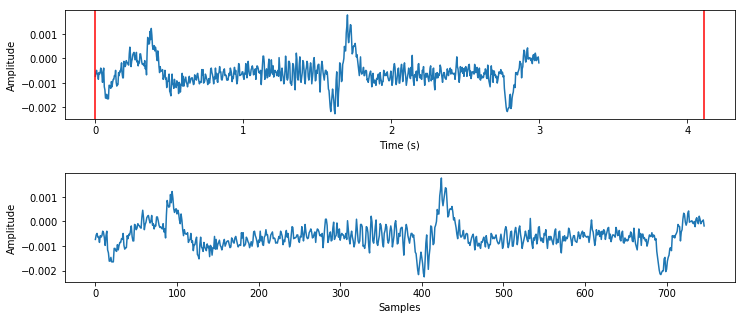

In [70]:
timesteps = np.arange(len(clip)) / sample_rate  # in seconds

fig, ax = plt.subplots(2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.5)

# plot the entire clip 
ax[0].plot(timesteps, clip)
ax[0].set_xlabel('Time (s)')
ax[0].set_ylabel('Amplitude')
#ax[0].set_title('Raw Audio: {} ({} samples)'.format(row.label, len(clip)))


n_fft = 1024 # frame length 
start = 0 # start at a part of the sound thats not silence.. 
x = clip[start:start+n_fft]

# mark location of frame in the entire signal
ax[0].axvline(start/sample_rate, c='r') 
ax[0].axvline((start+n_fft)/sample_rate, c='r')

# plot N samples 
ax[1].plot(x)
ax[1].set_xlabel('Samples')
ax[1].set_ylabel('Amplitude')
#ax[1].set_title('Raw Audio: {} ({} samples)'.format(row.label, len(x)));

Extend to a range of audio files to look at structure per class.
iterator per class.

## Sampling frequency histogram

Code to get sampling frequency of audio files in each class and plot histogram

## Spectrogram analysis


In [73]:
#Build Window
window = get_window('hann', n_fft)
wx = x * window

fig, ax = plt.subplots(1, 2, figsize=(16, 2))
ax[0].plot(window)
ax[1].plot(wx);

ValueError: operands could not be broadcast together with shapes (747,) (1024,) 

In [63]:

# Compute (real) FFT on window
X = fft(x, n_fft)
X.shape, X.dtype

((1024,), dtype('complex64'))

((513,), dtype('float32'))

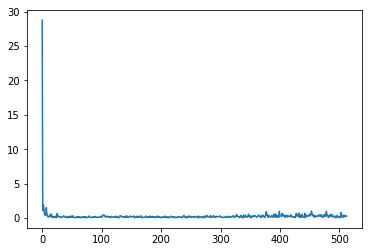

In [64]:
# We only use the first (n_fft/2)+1 numbers of the output, as the second half if redundant
X = X[:n_fft//2+1]

# Convert from rectangular to polar, usually only care about magnitude
X_magnitude, X_phase = librosa.magphase(X)

plt.plot(X_magnitude);

X_magnitude.shape, X_magnitude.dtype

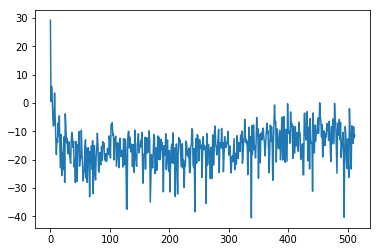

In [65]:
# we hear loudness in decibels (on a log scale of amplitude)
X_magnitude_db = librosa.amplitude_to_db(X_magnitude)

plt.plot(X_magnitude_db);

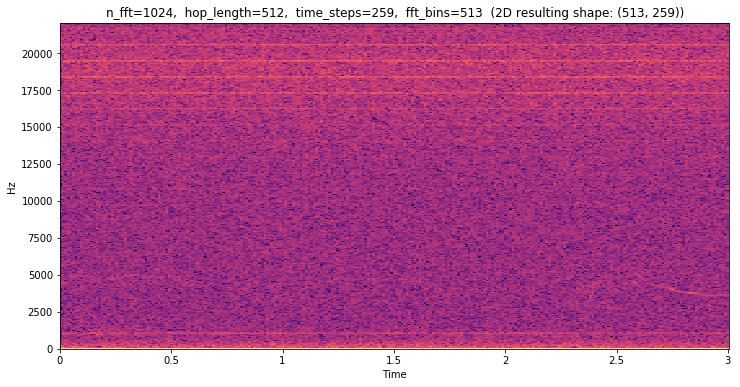

In [66]:
hop_length = 512
stft = librosa.stft(clip, n_fft=n_fft, hop_length=hop_length)
stft_magnitude, stft_phase = librosa.magphase(stft)
stft_magnitude_db = librosa.amplitude_to_db(stft_magnitude, ref=np.max)

plt.figure(figsize=(12, 6))
librosa.display.specshow(stft_magnitude_db, x_axis='time', y_axis='linear', 
                         sr=sample_rate, hop_length=hop_length)

title = 'n_fft={},  hop_length={},  time_steps={},  fft_bins={}  (2D resulting shape: {})'
plt.title(title.format(n_fft, hop_length, 
                       stft_magnitude_db.shape[1], 
                       stft_magnitude_db.shape[0], 
                       stft_magnitude_db.shape));

In [ ]:
#Expand Code to implement on all audio snippets.
## Saving Spectrogram

## Cepstrum Analysis

In [ ]:
Information on MELS here

TypeError: inner() got multiple values for argument 'ax'

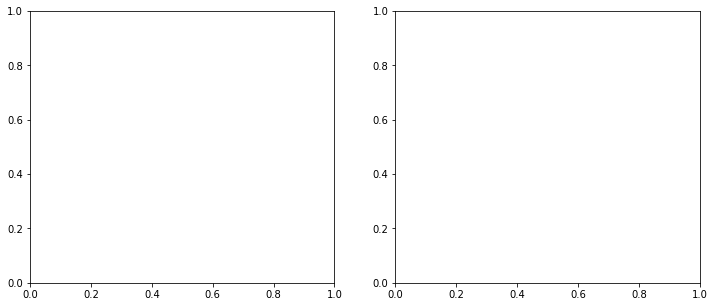

In [48]:
# number of mel frequency bands 
n_mels = 64

fig, ax = plt.subplots(1, 2, figsize=(12, 5))

fmin = 0            
fmax = 22050 # sample_rate/2
mel_spec = librosa.feature.melspectrogram(clip, n_fft=n_fft, hop_length=hop_length,
                                          n_mels=n_mels, sr=sample_rate, power=1.0,
                                          fmin=fmin, fmax=fmax)
mel_spec_db = librosa.amplitude_to_db(mel_spec, ref=np.max)
librosa.display.specshow(mel_spec_db, x_axis='time',  y_axis='mel', 
                         sr=sample_rate, hop_length=hop_length, 
                         fmin=fmin, fmax=fmax, ax=ax[0])
ax[0].set_title('n_mels=64, fmin=0, fmax=22050')

fmin = 20           
fmax = 8000
mel_spec = librosa.feature.melspectrogram(clip, n_fft=n_fft, hop_length=hop_length,
                                          n_mels=n_mels, sr=sample_rate, power=1.0, 
                                          fmin=fmin, fmax=fmax)
mel_spec_db = librosa.amplitude_to_db(mel_spec, ref=np.max)
librosa.display.specshow(mel_spec_db, x_axis='time',  y_axis='mel', 
                         sr=sample_rate, hop_length=hop_length, 
                         fmin=fmin, fmax=fmax, ax=ax[1])
ax[1].set_title('n_mels=64, fmin=20, fmax=8000')

plt.show()

In [ ]:
#Expand to do all snippets
#Save to folder